In [1]:
import time
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from sklearn.metrics.cluster import adjusted_rand_score
import random
from sklearn.metrics import confusion_matrix
from sklearn.metrics import jaccard_score
from sklearn.utils import shuffle
from anndata import AnnData
from sklearn.cluster import KMeans
from typing import Union, Optional, Tuple, Collection, Sequence, Iterable
from scipy.stats import hypergeom
import sklearn.preprocessing
import seaborn as sn
from random import sample
import pickle
from sklearn.metrics import silhouette_score
from sklearn.metrics import silhouette_samples

from typing import Optional

import warnings

import matplotlib as mpl
from matplotlib import gridspec
import xgboost as xgb
from sklearn.metrics import accuracy_score


sc.settings.verbosity = 0           # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.set_figure_params(dpi=100, dpi_save=200)

plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

scanpy==1.8.1 anndata==0.7.8 umap==0.3.10 numpy==1.18.1 scipy==1.5.2 pandas==1.3.4 scikit-learn==1.0 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1 leidenalg==0.7.0


In [2]:
dr = sc.read_h5ad('DR_raw.h5ad')


# General Functions

In [4]:
def pre_process(adata):
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)

    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #HVGs
    adata.raw = adata
    sc.pp.scale(adata, max_value=10) #scale
    sc.tl.pca(adata, svd_solver='arpack') #run PCA
    

def pipeline(adata, 
             batch_correct: Optional[bool] = None,
             batch_ID: Optional[str] = None):
    
    if (batch_correct):
        Z = harmonize(adata.obsm['X_pca'], adata.obs, batch_key = batch_ID)
        adata.obsm['X_harmony'] = Z
        sc.pp.neighbors(adata, n_neighbors=15, use_rep='X_harmony', n_pcs=40)
        sc.tl.leiden(adata)
        sc.tl.umap(adata)

    else:
        sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)
        sc.tl.leiden(adata)
        sc.tl.umap(adata)
        
def clust_obs(adata, obs_id, obs_id_split):

    obs_quants = []
    for i in adata.obs[obs_id_split].values.categories:
    #for i in dr_corr.obs['Atlas Label'].values.categories:
        obs_quants.append(np.mean(adata[adata.obs[obs_id_split]==i].obs[obs_id].values))
        
    return obs_quants

def res_tune(adata, def_labels):
    
    adata_ari = []
    adata_num_clusts = []
    for res in np.arange(1,2.1, 0.1):
        sc.tl.leiden(adata, resolution=res)

        adata_num_clusts.append(len(adata.obs.leiden.values.categories))
        adata_ari.append(adjusted_rand_score(def_labels, list(adata.obs.leiden.values)))
        
    return adata_num_clusts, adata_ari

# Mapping functions

In [5]:
def make_dict(adata, obs_id):

    adata_dict = {}
    for num,i in enumerate(adata.obs[obs_id].values.categories):
        adata_dict[i] = num
        
    #adata_dict['Unassigned'] = num + 1
    
    return adata_dict
    

def plotConfusionMatrix(
    ytrue,
    ypred,
    type,
    xaxislabel,
    yaxislabel,
    title,
    train_dict,
    test_dict=None,
    re_order=None,
    re_order_cols = None,
    re_index = None,
    re_order_rows = None,
    save_as=None,):
    
    #very bad
    numbertrainclasses = len(set(ypred))
    numbertestclasses = len(set(ytrue))
    
    #cfm is 11x11 b/c 11 is = y_true U y_pred
    confusionmatrix = confusion_matrix(y_true = ytrue, y_pred = ypred)
    
    #only need this when mapping b/c if validaiton, all classes will be used and cfm will be constructed properly
    if type == 'mapping':
        rows = np.where(np.sum(confusionmatrix, axis=1)>0)[0]
        cols = np.where(np.sum(confusionmatrix, axis=0)>0)[0]

        cfm = confusionmatrix[rows,:][:,cols]
        
        #show all columns, even ones with no mapping
        cfm_z = np.zeros((len(test_dict),len(train_dict)))
        cfm_z[:, np.array(pd.Categorical(ypred).categories, dtype='int')]=cfm 
        confusionmatrix = cfm_z
        #always keep only as many as rows as num of test classes
        #but, b/c of python's 0 indexing, if the number of training classes is in the 
        #y_pred list, then that means there was an unassigned
#       if numbertrainclasses in ypred:
#         confusionmatrix = confusionmatrix[0:numbertestclasses,0:numbertrainclasses+1]#for Unassigned
#       else:
#         confusionmatrix = confusionmatrix[0:numbertestclasses,0:numbertrainclasses]
    
        confmatpercent = confusionmatrix/np.sum(confusionmatrix, axis=1).reshape(-1,1)

        conf_df = pd.DataFrame(confmatpercent)
        conf_df.index = list(test_dict.keys())

        #name columns of conf mat
        if(len(conf_df.columns)>len(train_dict)):
            conf_df.columns = list(train_dict.keys())+['Unassigned']
        else:
            conf_df.columns = list(train_dict.keys())


        if (re_order):
            conf_df = conf_df[re_order_cols]

        if (re_index):
            conf_df = conf_df.reindex(re_order_rows)

        diagcm = conf_df.to_numpy()
    
    
        xticksactual = list(conf_df.columns)
        
        #print(conf_df)
        
    
    else:
        confmatpercent = np.zeros(confusionmatrix.shape)
        for i in range(confusionmatrix.shape[0]):
            if np.sum(confusionmatrix[i,:]) != 0:
                confmatpercent[i,:] = confusionmatrix[i,:]/np.sum(confusionmatrix[i,:])
            else:
                confmatpercent[i,:] = confusionmatrix[i,:]
            diagcm = confmatpercent
            xticks = np.linspace(0, confmatpercent.shape[1]-1, confmatpercent.shape[1], dtype = int)
        xticksactual = []
        for i in xticks:
            if i != numbertrainclasses:
                xticksactual.append(list(train_dict.keys())[i])
            else:
                xticksactual.append('Unassigned')
        
    dot_max = np.max(diagcm.flatten())
    dot_min = 0
    if dot_min != 0 or dot_max != 1:
        frac = np.clip(diagcm, dot_min, dot_max)
        old_range = dot_max - dot_min
        frac = (frac - dot_min) / old_range
    else:
        frac = diagcm
    xvalues = []
    yvalues = []
    sizes = []
    for i in range(diagcm.shape[0]):
        for j in range(diagcm.shape[1]):
            xvalues.append(j)
            yvalues.append(i)
            sizes.append((frac[i,j]*35)**1.5)
    size_legend_width = 0.5
    height = diagcm.shape[0] * 0.3 + 1
    height = max([1.5, height])
    heatmap_width = diagcm.shape[1] * 0.35
    width = (
        heatmap_width
        + size_legend_width
        )
    fig = plt.figure(figsize=(width, height))
    axs = gridspec.GridSpec(
        nrows=2,
        ncols=2,
        wspace=0.02,
        hspace=0.04,
        width_ratios=[
                    heatmap_width,
                    size_legend_width
                    ],
        height_ratios = [0.5, 10]
        )
    dot_ax = fig.add_subplot(axs[1, 0])
    dot_ax.scatter(xvalues,yvalues, s = sizes, c = 'blue', norm=None, edgecolor='none')
    y_ticks = range(diagcm.shape[0])
    dot_ax.set_yticks(y_ticks)
    if type == 'validation':
        dot_ax.set_yticklabels(list(train_dict.keys()))
    elif type == 'mapping':
      #dot_ax.set_yticklabels(list(test_dict.keys()))
        dot_ax.set_yticklabels(list(conf_df.index))
    x_ticks = range(diagcm.shape[1])
    dot_ax.set_xticks(x_ticks)
    dot_ax.set_xticklabels(xticksactual, rotation=90)
    dot_ax.tick_params(axis='both', labelsize='small')
    dot_ax.grid(True, linewidth = 0.2)
    dot_ax.set_axisbelow(True)
    dot_ax.set_xlim(-0.5, diagcm.shape[1] + 0.5)
    ymin, ymax = dot_ax.get_ylim()
    dot_ax.set_ylim(ymax + 0.5, ymin - 0.5)
    dot_ax.set_xlim(-1, diagcm.shape[1])
    dot_ax.set_xlabel(xaxislabel)
    dot_ax.set_ylabel(yaxislabel)
    dot_ax.set_title(title)
    size_legend_height = min(1.75, height)
    wspace = 10.5 / width
    axs3 = gridspec.GridSpecFromSubplotSpec(
        2,
        1,
        subplot_spec=axs[1, 1],
        wspace=wspace,
        height_ratios=[
                    size_legend_height / height,
                    (height - size_legend_height) / height
                    ]
        )
    diff = dot_max - dot_min
    if 0.3 < diff <= 0.6:
        step = 0.1
    elif diff <= 0.3:
        step = 0.05
    else:
        step = 0.2
    fracs_legends = np.arange(dot_max, dot_min, step * -1)[::-1]
    if dot_min != 0 or dot_max != 1:
        fracs_values = (fracs_legends - dot_min) / old_range
    else:
        fracs_values = fracs_legends
    size = (fracs_values * 35) ** 1.5
    size_legend = fig.add_subplot(axs3[0])
    size_legend.scatter(np.repeat(0, len(size)), range(len(size)), s=size, c = 'blue')
    size_legend.set_yticks(range(len(size)))
    labels = ["{:.0%}".format(x) for x in fracs_legends]
    if dot_max < 1:
        labels[-1] = ">" + labels[-1]
    size_legend.set_yticklabels(labels)
    size_legend.set_yticklabels(["{:.0%}".format(x) for x in fracs_legends])
    size_legend.tick_params(axis='y', left=False, labelleft=False, labelright=True)
    size_legend.tick_params(axis='x', bottom=False, labelbottom=False)
    size_legend.spines['right'].set_visible(False)
    size_legend.spines['top'].set_visible(False)
    size_legend.spines['left'].set_visible(False)
    size_legend.spines['bottom'].set_visible(False)
    size_legend.grid(False)
    ymin, ymax = size_legend.get_ylim()
    size_legend.set_ylim(ymin, ymax + 0.5)
    
    if (save_as is not None):
        fig.savefig(save_as, bbox_inches = 'tight')

    return diagcm, xticksactual, axs



#This helper method plots validation plots in sequential order (i.e. first plot is for first batch, second plot is for second batch, etc.)
def plot_validation_plots(validation_label_train_70, valid_predlabels_train_70, train_dict, save_as=None):
    
    ARI = adjusted_rand_score(labels_true = validation_label_train_70, 
                              labels_pred = valid_predlabels_train_70)
    
    
    c = 0
    for i in range(validation_label_train_70.shape[0]):
        if (validation_label_train_70[i]!=valid_predlabels_train_70[i]):
            c = c +1
    acc = (1 - c/len(validation_label_train_70))*100
    
           
    validationconfmat, validationxticks, validationplot = plotConfusionMatrix(
    ytrue = validation_label_train_70,
    ypred = valid_predlabels_train_70,
    train_dict=train_dict,
    type = 'validation',
    save_as = save_as,
    title = 'ARI = {:.3f}, Accuracy = {:.3f}'.format(ARI, acc),
    xaxislabel = 'Predicted',
    yaxislabel = 'True'
    )

def plot_mapping(test_labels, test_predlabels, test_dict, train_dict, 
                 xaxislabel, yaxislabel,
                re_order=None,
    re_order_cols = None,
                 re_index = None,
    re_order_rows = None, save_as=None):
    
    ARI = adjusted_rand_score(labels_true = test_labels, 
                              labels_pred = test_predlabels)
    
    
 
    
           
    mappingconfmat, mappingxticks, mappingplot = plotConfusionMatrix(
    ytrue = test_labels,
    ypred = test_predlabels,
    test_dict=test_dict,
    train_dict=train_dict,
    type = 'mapping',
    save_as = save_as,
    title = 'ARI = {:.3f}'.format(ARI),
    xaxislabel =xaxislabel,
    yaxislabel = yaxislabel,
        re_order=re_order,
    re_order_cols = re_order_cols,
        re_index = re_index,
    re_order_rows = re_order_rows,
    )    
      
      
#This helper method uses xgboost to train classifiers.
def trainclassifier(train_anndata, common_top_genes, obs_id, train_dict, eta,
                    max_cells_per_ident, train_frac, min_cells_per_ident):
    
    if sp.sparse.issparse(train_anndata.X):
        if np.any(train_anndata.X.A<0):
            raise Exception("Matrix contains negative values")
    else: 
        if np.any(train_anndata.X<0):
            raise Exception("Matrix contains negative values")

    
    start_time = time.time()
    
    numbertrainclasses = len(train_anndata.obs[obs_id].values.categories)

    xgb_params_train = {
            'objective':'multi:softprob',
            'eval_metric':'mlogloss',
            'num_class':numbertrainclasses,
            'eta':eta,
            'max_depth':4,
            'subsample': 0.6}
    nround = 200
    #Train XGBoost on 70% of training data and validate on the remaining data


    training_set_train_70 = []
    validation_set_train_70 = []
    training_label_train_70 = []
    validation_label_train_70 = []

    #loop thru classes to split for training and validation
    for i in train_anndata.obs[obs_id].values.categories:
        
        #how many cells in a class
        cells_in_clust = train_anndata[train_anndata.obs[obs_id]==i,:].obs_names #cell names
        n = min(max_cells_per_ident,round(len(cells_in_clust)*train_frac))
        
        #sample 70% for training and rest for validation
        train_temp = np.random.choice(cells_in_clust,n,replace = False)
        validation_temp = np.setdiff1d(cells_in_clust, train_temp)
        
        #upsample small clusters
        if len(train_temp) < min_cells_per_ident:
            train_temp_bootstrap = np.random.choice(train_temp, size = min_cells_per_ident - int(len(train_temp)))
            train_temp = np.hstack([train_temp_bootstrap, train_temp])
        
        #store training and validation **names** of cells in vectors, which update for every class
        training_set_train_70 = np.hstack([training_set_train_70,train_temp])
        validation_set_train_70 = np.hstack([validation_set_train_70,validation_temp])
        
        #store training and validation **labels** of cells in vectors, which update for every class
        training_label_train_70 = np.hstack([training_label_train_70,np.repeat(train_dict[i],len(train_temp))])
        validation_label_train_70 = np.hstack([validation_label_train_70,np.repeat(train_dict[i],len(validation_temp))])

        #need train_dict b/c XGboost needs number as class labels, not words
        #this is only deconvulted later in plotting function
        
    #put data in XGB format
    X_train = train_anndata[training_set_train_70,common_top_genes].X
    train_matrix_train_70 = xgb.DMatrix(data = X_train, label = training_label_train_70, 
                                        feature_names = common_top_genes)
    
    X_valid = train_anndata[validation_set_train_70,common_top_genes].X
    validation_matrix_train_70 = xgb.DMatrix(data = X_valid, label = validation_label_train_70, 
                                             feature_names = common_top_genes)

    del training_set_train_70, validation_set_train_70, training_label_train_70
    
    #Train on 70%
    bst_model_train_70 = xgb.train(
        params = xgb_params_train,
        dtrain = train_matrix_train_70,
        num_boost_round = nround)
    
    #Validate on 30%
    #a validation_cells x numclasses matrix, with each vector containing prob association with the classes
    validation_pred_train_70 = bst_model_train_70.predict(data = validation_matrix_train_70)
    
    #for each cell, go through vec of probs and take index of max prob: that's assignment
    valid_predlabels_train_70 = np.zeros((validation_pred_train_70.shape[0]))
    for i in range(validation_pred_train_70.shape[0]):
        valid_predlabels_train_70[i] = np.argmax(validation_pred_train_70[i,:])
        
    
    #Train on 100%
    #Train XGBoost on the full training data
    training_set_train_full = []
    training_label_train_full = []

    for i in train_anndata.obs[obs_id].values.categories.values:
        train_temp = train_anndata.obs.index[train_anndata.obs[obs_id].values == i]
        if len(train_temp) < 100:
            train_temp_bootstrap = np.random.choice(train_temp, size = 100 - int(len(train_temp)))
            train_temp = np.hstack([train_temp_bootstrap, train_temp])
        
        #indices of cells in class
        training_set_train_full = np.hstack([training_set_train_full,train_temp])
        
        #labels of cells in class: [label*N_class] stacked onto previous classes
        training_label_train_full = np.hstack([training_label_train_full,np.repeat(train_dict[i],len(train_temp))])


    X_train_full = train_anndata[training_set_train_full,common_top_genes].X
    full_training_data = xgb.DMatrix(data = X_train_full, label = training_label_train_full, 
                                     feature_names = common_top_genes)

    del training_set_train_full, training_label_train_full

    bst_model_full_train = xgb.train(
        params = xgb_params_train,
        dtrain = full_training_data,
        num_boost_round = nround)

    
    
    print('trainclassifier() complete after', np.round(time.time() - start_time), 'seconds')
    
    #real labels of validation set, predicted labels, classifier.
    #recall these are all integers that are deconvulted later in plotting using the dicts
    return validation_label_train_70, valid_predlabels_train_70, bst_model_full_train


#This helper method predicts the testing cluster labels.
def predict(train_anndata, common_top_genes, bst_model_train_full, test_anndata, 
            train_obs_id, test_dict, test_obs_id):
    
    #Predict the testing cluster labels
    #how many classes mapping to 
    numbertrainclasses = len(train_anndata.obs[train_obs_id].values.categories)
    
    #put testing data into XGB format
    full_testing_data = xgb.DMatrix(data = test_anndata[:,common_top_genes].X, 
                                    feature_names=common_top_genes)
    
    #a testing_cells x numclasses matrix, with each vector containing prob association with the classes
    test_prediction = bst_model_train_full.predict(data = full_testing_data)

    #for each cell, go through vec of probs and take index of max prob (if greater than ...): that's assignment

    
    test_predlabels = np.zeros((test_prediction.shape[0]))
    for i in range(test_prediction.shape[0]):
        if np.max(test_prediction[i, :]) > 1.1*(1/numbertrainclasses):
            test_predlabels[i] = np.argmax(test_prediction[i,:])
        
        #"unassigned" is a label one larger than all b/c python begins indexing at 0
        else:
            test_predlabels[i] = numbertrainclasses
        
    test_labels = np.zeros(len(test_anndata.obs[test_obs_id].values))
    for i,l in enumerate(test_anndata.obs[test_obs_id].values):
        test_labels[i] = test_dict[l]

    #actual labels of testing set, the labels that test set mapped to 
    return test_labels, test_predlabels, test_prediction

# Read in from R

In [ ]:
atlas_dir = 'RGCatlas.h5ad'

In [ ]:
vd = sc.read_mtx('vd.mtx').transpose()

In [41]:
vd.obs_names = pd.read_csv('vd_obs.csv')['x'].values
vd.var_names = pd.read_csv('vd_vars.csv')['x'].values
vd.obs['VD Condition'] = pd.Categorical(pd.read_csv('vd_cond.csv')['x'].values)
vd.obs['Batch'] = pd.Categorical(pd.read_csv('vd_orig.csv')['x'].values)

vd.obs['VD Condition'] = vd.obs['VD Condition'].cat.reorder_categories(['DR', 'RD1', 'BCless'])
vd.obs['VD Condition'] = vd.obs['VD Condition'].cat.rename_categories(["DR",  "rd1",  "Vsx2-SE-/-"])

In [58]:
dr = vd[vd.obs['VD Condition']=='DR']
dr.write_h5ad('DR_raw.h5ad')

rd1 = vd[vd.obs['VD Condition']=='rd1']
rd1.write_h5ad('rd1_raw.h5ad')

Vsx2 = vd[vd.obs['VD Condition']=='Vsx2-SE-/-']
Vsx2.write_h5ad('Vsx2_raw.h5ad')

In [313]:
dr = sc.read_h5ad('DR_raw.h5ad')

rd1 = sc.read_h5ad('rd1_raw.h5ad')

Vsx2 = sc.read_h5ad('Vsx2_raw.h5ad')

# Atlas analysis

In [827]:
atlas_dir = 'RGCatlas.h5ad'
atlas = sc.read_h5ad(atlas_dir)

In [828]:
del atlas.obsp
del atlas.varm

In [829]:
atlas

AnnData object with n_obs × n_vars = 35699 × 18222
    obs: 'Type', 'Batch', 'Type_num'
    var: 'highly_variable', 'mean', 'std'
    uns: 'Type_num_colors', 'neighbors', 'pca', 'umap'
    obsm: 'R_tsne', 'X_harmony', 'X_pca', 'X_umap'
    layers: 'raw'

In [830]:
atlas.X = atlas.layers['raw']

In [831]:
atlas.var['mt'] = atlas.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(atlas, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [832]:
# fig,axs = plt.subplots(1,2,figsize=(9,4))

# sc.pl.scatter(atlas, x='total_counts', y='pct_counts_mt',ax=axs[0], show=False)
# sc.pl.scatter(atlas, x='total_counts', y='n_genes_by_counts', ax=axs[1], show=False)
# plt.tight_layout()

In [833]:
# atlas = atlas[atlas.obs.total_counts < 50000, :]

# atlas = atlas[atlas.obs.pct_counts_mt < 30, :]

In [834]:
pre_process(atlas)
pipeline(atlas, batch_correct=True, batch_ID='Batch')

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
Reach convergence after 5 iteration(s).


In [947]:
type_cols = sn.color_palette('pastel').as_hex()+sn.color_palette('Set3').as_hex()+sn.color_palette('Set2').as_hex()+sn.color_palette('hls').as_hex()+sn.color_palette('husl').as_hex()+sn.color_palette('pastel').as_hex()
#atlas.uns['leiden_colors'] = type_cols


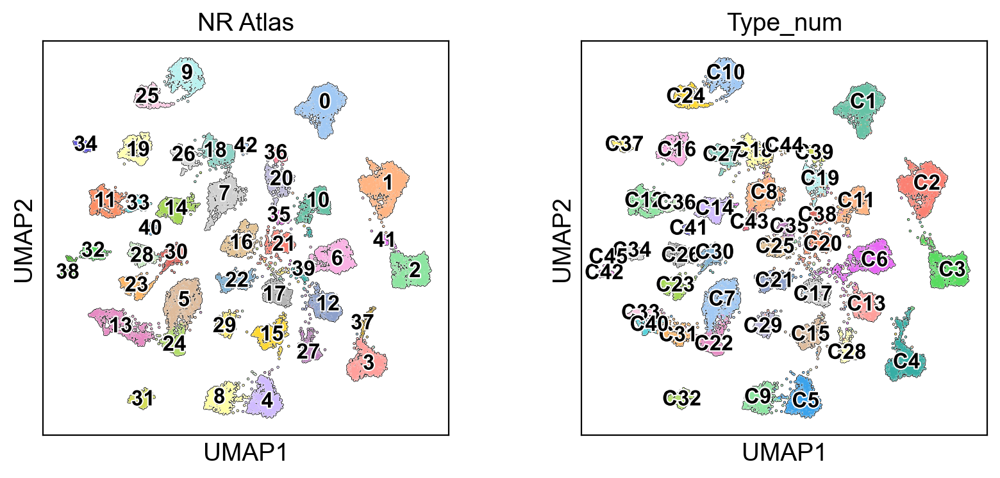

In [811]:
sc.pl.umap(atlas, color=['leiden', 'Type_num'], title='NR Atlas',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data', 
          add_outline=True, palette=type_cols)

sc.pl.umap(atlas, color=['Type_num'], title='WT: 35699 RGCs, 45 clusters',
           legend_fontoutline=1.5, legend_fontsize=10, legend_loc='on data', 
          add_outline=True, palette=type_cols, save='atlas_umap_type_num.pdf')

Trying to set attribute `._uns` of view, copying.


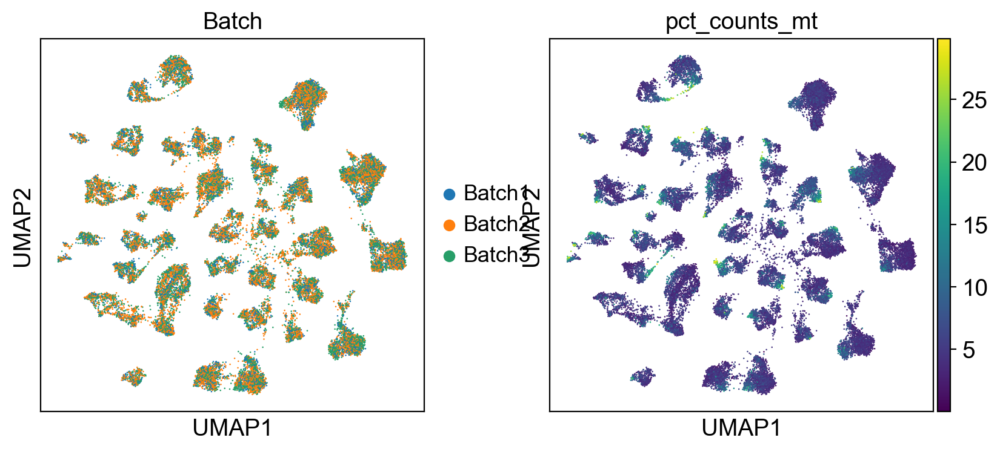

In [19]:
sc.pl.umap(shuffle(atlas), color=['Batch', 'pct_counts_mt'])

# DR analysis

In [142]:
def dub_det(adata_raw):

    adata_batches = []
    for i, b in enumerate(adata_raw.obs.Batch.values.categories):
        adata_batches.append(adata_raw[adata_raw.obs['Batch']==b])
        counts_matrix = adata_batches[i].X

        scrub = scr.Scrublet(counts_matrix, expected_doublet_rate=0.06)

        doublet_scores, predicted_doublets = scrub.scrub_doublets(min_cells=8, 
                                                                  min_gene_variability_pctl=85, 
                                                                  n_prin_comps=40)

        #scrub.plot_histogram()
        #plt.show()
        adata_batches[i].obs['Doublet'] = scrub.predicted_doublets_
        adata_batches[i].obs['Doublet Score'] = scrub.doublet_scores_obs_
        
    return adata_batches[0].concatenate(adata_batches[1:])

In [ ]:
#dr = dub_det(dr)

In [322]:
dr.var['mt'] = dr.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(dr, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

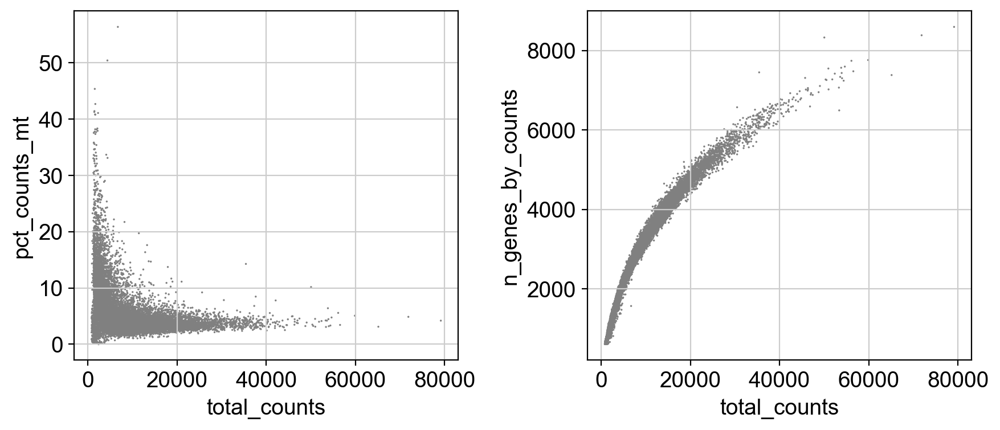

In [323]:
fig,axs = plt.subplots(1,2,figsize=(9,4))

sc.pl.scatter(dr, x='total_counts', y='pct_counts_mt',ax=axs[0], show=False)
sc.pl.scatter(dr, x='total_counts', y='n_genes_by_counts', ax=axs[1], show=False)
plt.tight_layout()

In [324]:
dr = dr[dr.obs.total_counts < 50000, :]
dr = dr[dr.obs.pct_counts_mt < 30, :]

In [325]:
pre_process(dr)

pipeline(dr, batch_correct=False)

In [326]:
dr_corr = dr.copy()

In [327]:
pipeline(dr_corr, batch_correct=True, batch_ID='Batch')

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
	Completed 9 / 10 iteration(s).
	Completed 10 / 10 iteration(s).
Reach convergence after 10 iteration(s).


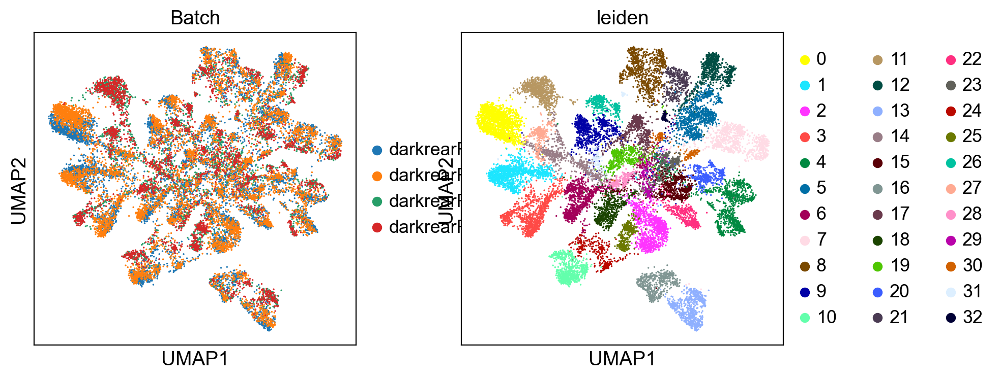

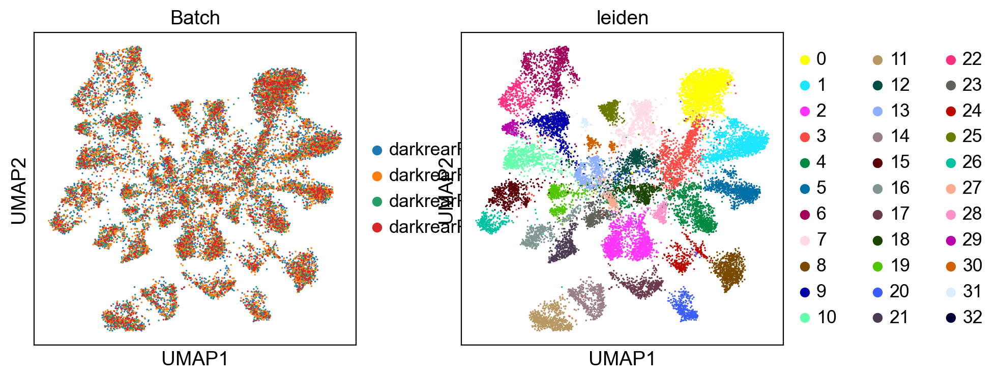

In [139]:
sc.pl.umap(dr, color=['Batch', 'leiden'])
sc.pl.umap(dr_corr, color=['Batch', 'leiden'])

In [328]:
type_cols = sn.color_palette('pastel').as_hex()+sn.color_palette('Set2').as_hex()+sn.color_palette('Set3').as_hex()+sn.color_palette('hls').as_hex()+sn.color_palette('husl').as_hex()+sn.color_palette('pastel').as_hex()
dr_corr.uns['leiden_colors'] = type_cols

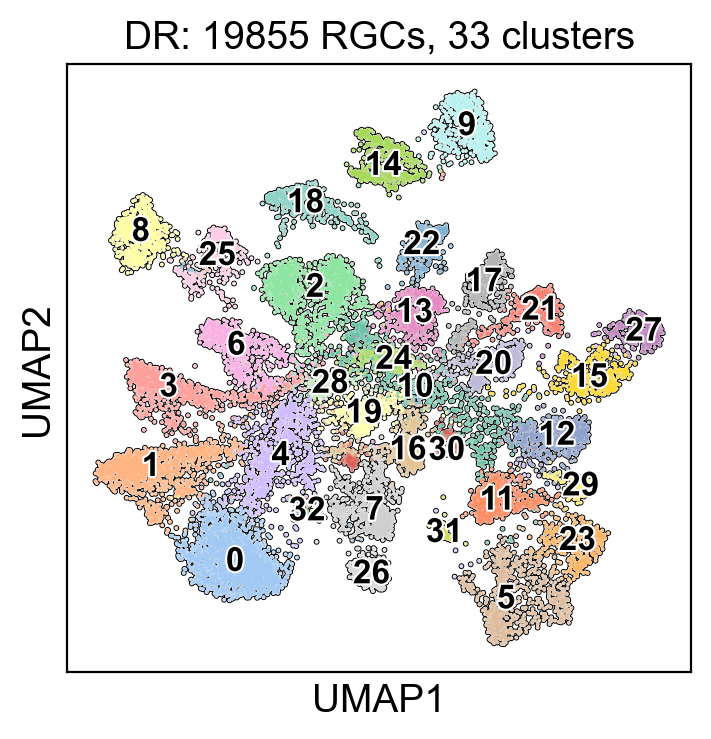

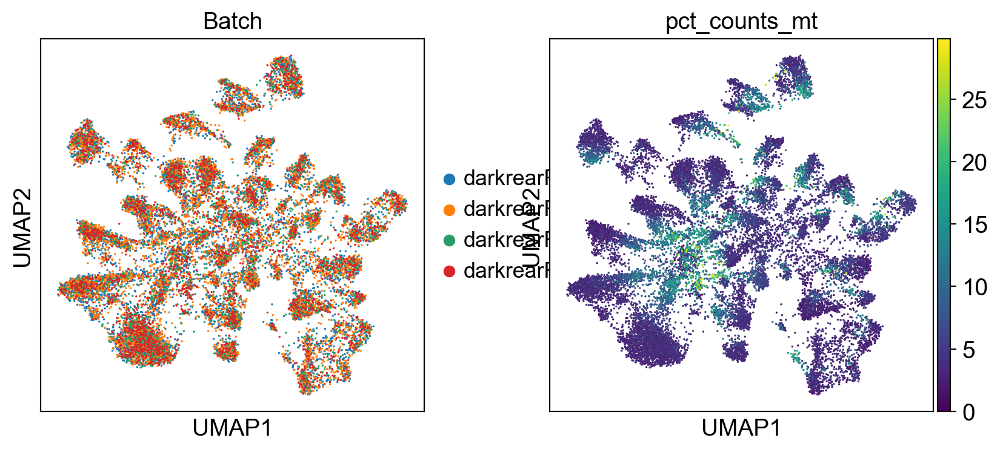

In [514]:
sc.pl.umap(dr_corr, color=['leiden'], title='DR: '+ str(dr_corr.shape[0])+ ' RGCs, ' + str(len(dr_corr.obs.leiden.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data', palette=type_cols,
          add_outline=True, save='_DR_leiden.pdf')

sc.pl.umap(dr_corr, color=['Batch', 'pct_counts_mt'])

# rd1 analysis

In [329]:
rd1.var['mt'] = rd1.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(rd1, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

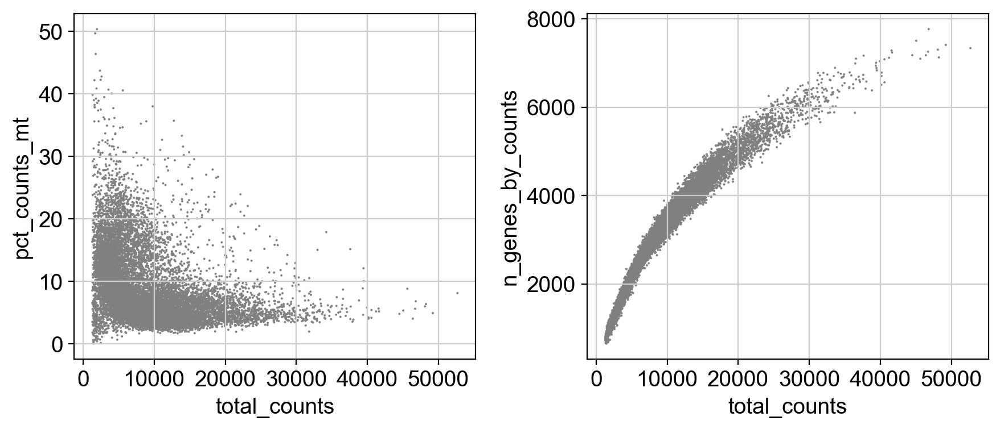

In [330]:
fig,axs = plt.subplots(1,2,figsize=(9,4))

sc.pl.scatter(rd1, x='total_counts', y='pct_counts_mt',ax=axs[0], show=False)
sc.pl.scatter(rd1, x='total_counts', y='n_genes_by_counts', ax=axs[1], show=False)
plt.tight_layout()

In [331]:
rd1 = rd1[rd1.obs.total_counts < 40000, :]
rd1 = rd1[rd1.obs.pct_counts_mt < 30, :]

In [332]:
pre_process(rd1)
pipeline(rd1, batch_correct=True, batch_ID='Batch')

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
	Completed 7 / 10 iteration(s).
	Completed 8 / 10 iteration(s).
Reach convergence after 8 iteration(s).


In [333]:
type_cols = sn.color_palette('pastel').as_hex()+sn.color_palette('Set2').as_hex()+sn.color_palette('Set3').as_hex()+sn.color_palette('hls').as_hex()+sn.color_palette('husl').as_hex()+sn.color_palette('pastel').as_hex()
rd1.uns['leiden_colors'] = type_cols

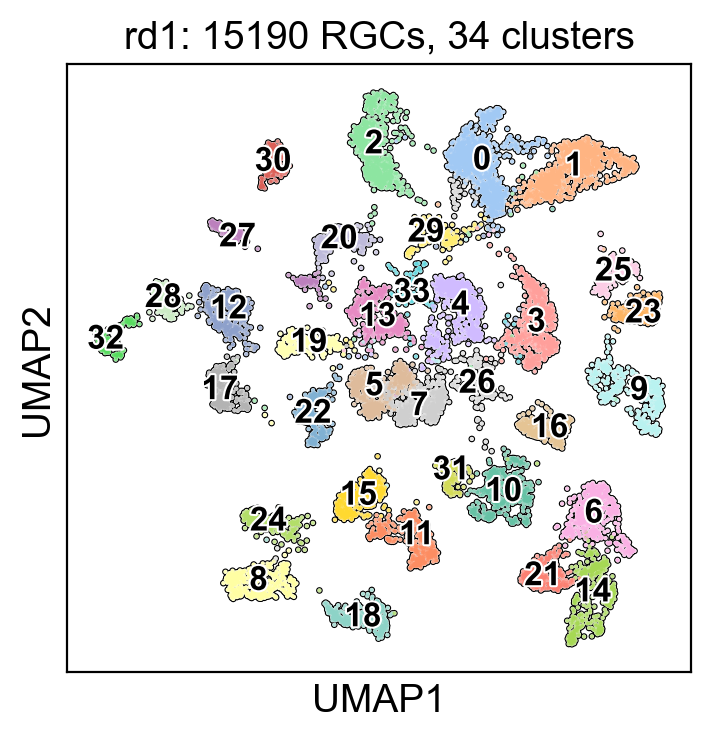

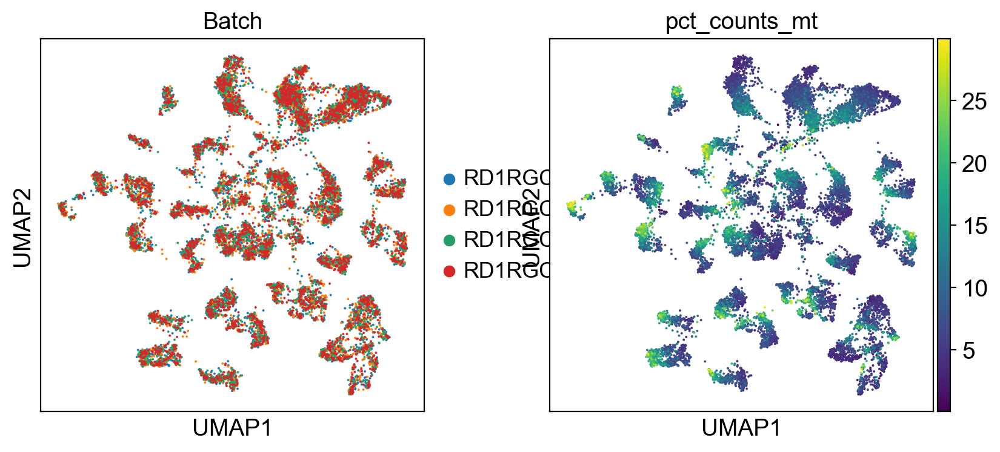

In [516]:
sc.pl.umap(rd1, color=['leiden_new'], title='rd1: '+ str(rd1.shape[0])+ ' RGCs, ' + str(len(rd1.obs.leiden_new.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data',palette=type_cols,
          add_outline=True,  save='_rd1_leiden.pdf')

sc.pl.umap(rd1, color=['Batch', 'pct_counts_mt'])

# Vsx2 analysis

In [334]:
Vsx2.var['mt'] = Vsx2.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(Vsx2, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

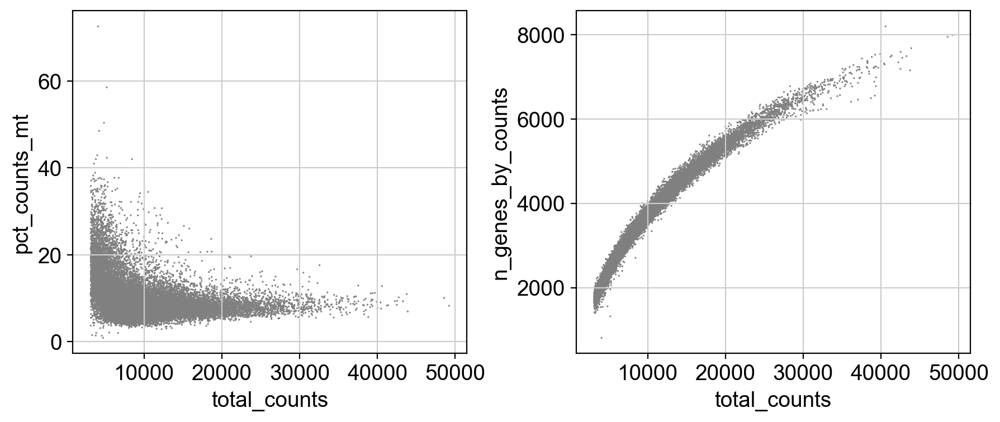

In [335]:
fig,axs = plt.subplots(1,2,figsize=(9,4))

sc.pl.scatter(Vsx2, x='total_counts', y='pct_counts_mt',ax=axs[0], show=False)
sc.pl.scatter(Vsx2, x='total_counts', y='n_genes_by_counts', ax=axs[1], show=False)
plt.tight_layout()

In [336]:
Vsx2 = Vsx2[Vsx2.obs.total_counts < 40000, :]
Vsx2 = Vsx2[Vsx2.obs.pct_counts_mt < 30, :]

In [337]:
pre_process(Vsx2)
pipeline(Vsx2, batch_correct=True, batch_ID='Batch')

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
	Completed 6 / 10 iteration(s).
Reach convergence after 6 iteration(s).


In [338]:
type_cols = sn.color_palette('pastel').as_hex()+sn.color_palette('Set2').as_hex()+sn.color_palette('Set3').as_hex()+sn.color_palette('hls').as_hex()+sn.color_palette('husl').as_hex()+sn.color_palette('pastel').as_hex()
Vsx2.uns['leiden_colors'] = type_cols

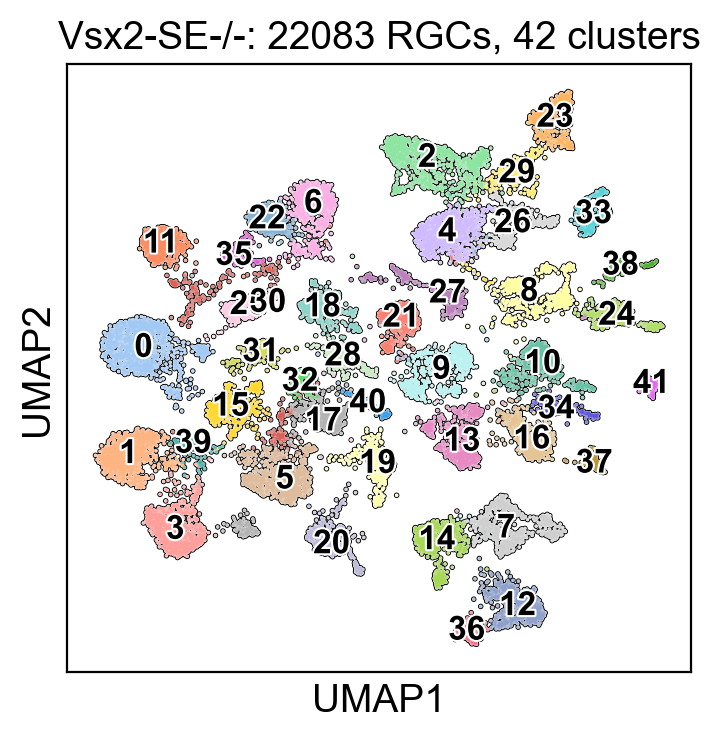

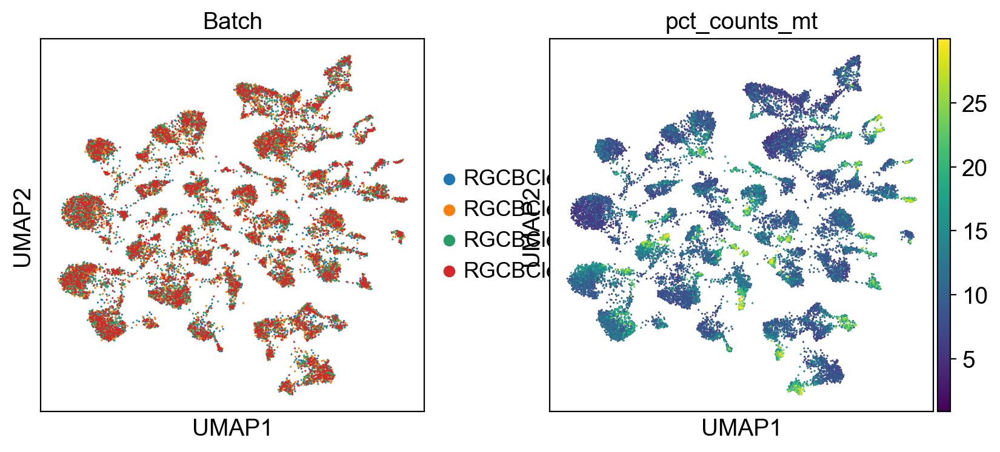

In [517]:
sc.pl.umap(Vsx2, color=['leiden_new'], title='Vsx2-SE-/-: '+ str(Vsx2.shape[0])+ ' RGCs, ' + str(len(Vsx2.obs.leiden_new.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data', palette=type_cols,
          add_outline=True,  save='_Vsx2_leiden.pdf')

sc.pl.umap(Vsx2, color=['Batch', 'pct_counts_mt'])

# 4 Dataset analyses

**I re-ran these on `leiden_new` after doing the cluster refinements in later cells**

In [430]:
atlas.shape, rd1.shape, dr_corr.shape, Vsx2.shape

((35639, 18222), (15190, 27933), (19855, 27933), (22083, 27933))

In [431]:
atlas_sub = atlas.copy()
dr_corr_sub = dr_corr.copy()
rd1_sub = rd1.copy()
Vsx2_sub = Vsx2.copy()

In [432]:
sc.pp.subsample(atlas, n_obs=15000)
sc.pp.subsample(dr_corr, n_obs=15000)
sc.pp.subsample(rd1, n_obs=15000)
sc.pp.subsample(Vsx2, n_obs=15000)

In [416]:
atlas_sil = silhouette_samples(X=atlas.obsm['X_harmony'][:,0:40], labels=atlas.obs.Type_num)
dr_sil = silhouette_samples(X=dr_corr.obsm['X_harmony'][:,0:40], labels=dr_corr.obs.leiden)
rd1_sil = silhouette_samples(X=rd1.obsm['X_harmony'][:,0:40], labels=rd1.obs.leiden_new)
vsx2_sil = silhouette_samples(X=Vsx2.obsm['X_harmony'][:,0:40], labels=Vsx2.obs.leiden_new)

In [577]:
atlas.obs.Batch

aRGC6_ATTCTACGTCAGCTAT-1    Batch2
aRGC2_CGGTTAAGTAGAGGAA-1    Batch1
aRGC5_TCATTTGAGCGTAATA-1    Batch2
aRGC3_TGTATTCTCAACACTG-1    Batch2
aRGC6_GCGCAACTCAGGCAAG-1    Batch2
                             ...  
aRGC2_ATTGGTGTCCGAGCCA-1    Batch1
aRGC1_CCTTCCCCATTGTGCA-1    Batch1
aRGC5_ACTGATGAGAGCCCAA-1    Batch2
aRGC6_GAACGGAGTCGTCTTC-1    Batch2
aRGC9_CAACTAGAGTGAAGTT-1    Batch3
Name: Batch, Length: 15000, dtype: category
Categories (3, object): ['Batch1', 'Batch2', 'Batch3']

In [588]:
atlas_b1_sil = silhouette_samples(X=atlas[atlas.obs.Batch=='Batch1'].obsm['X_harmony'][:,0:40], labels=atlas[atlas.obs.Batch=='Batch1'].obs.Type_num)
atlas_b2_sil = silhouette_samples(X=atlas[atlas.obs.Batch=='Batch2'].obsm['X_harmony'][:,0:40], labels=atlas[atlas.obs.Batch=='Batch2'].obs.Type_num)
atlas_b3_sil = silhouette_samples(X=atlas[atlas.obs.Batch=='Batch3'].obsm['X_harmony'][:,0:40], labels=atlas[atlas.obs.Batch=='Batch3'].obs.Type_num)

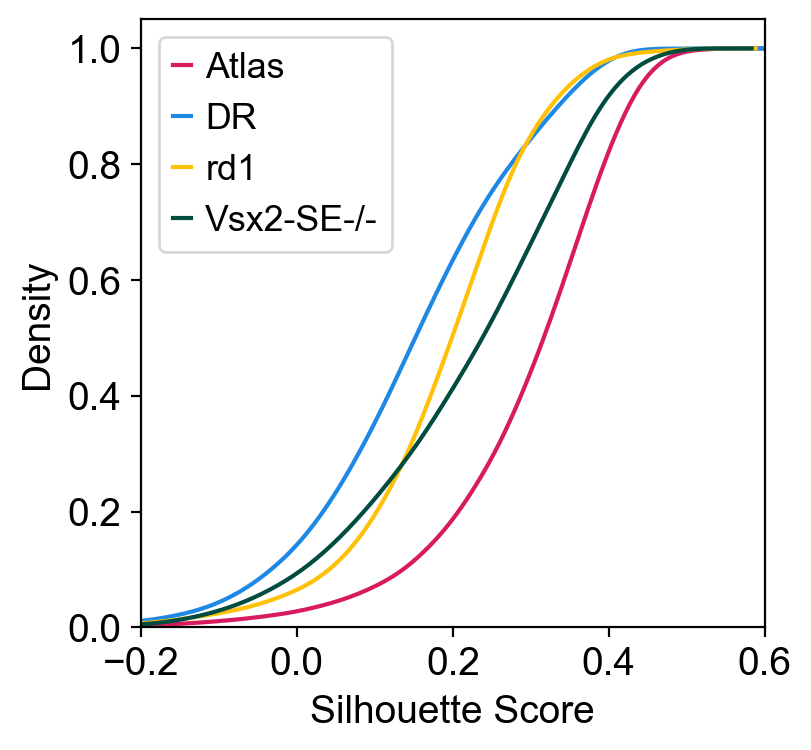

In [640]:
sn.kdeplot(atlas_sil, label='Atlas',color='#D81B60', cumulative=True)
sn.kdeplot(dr_sil, label='DR', color='#1E88E5', cumulative=True)
sn.kdeplot(rd1_sil, label='rd1',color='#FFC107', cumulative=True)
sn.kdeplot(vsx2_sil, label='Vsx2-SE-/-', color='#004D40', cumulative=True,)

# sn.kdeplot(atlas_b1_sil, label='Batch1', color=type_cols[20], cumulative=True)
# sn.kdeplot(atlas_b2_sil, label='Batch2', color=type_cols[21], cumulative=True)
# sn.kdeplot(atlas_b3_sil, label='Batch3', color=type_cols[22], cumulative=True)


plt.legend()
plt.xlabel('Silhouette Score')
plt.xlim([-0.2,0.6])
plt.grid(False)
plt.show()

In [594]:
sp.stats.ks_2samp(atlas_sil, dr_sil), sp.stats.ks_2samp(atlas_sil, rd1_sil), sp.stats.ks_2samp(atlas_sil, vsx2_sil)

(KstestResult(statistic=0.46689472750789845, pvalue=0.0),
 KstestResult(statistic=0.42925606071608163, pvalue=0.0),
 KstestResult(statistic=0.23823896361085206, pvalue=0.0))

# Train on atlas

In [271]:
atlas[:,atlas.var.highly_variable].shape[1], dr_corr[:,dr_corr.var.highly_variable].shape[1], rd1[:,rd1.var.highly_variable].shape[1], Vsx2[:,Vsx2.var.highly_variable].shape[1]

(1706, 3141, 1960, 2305)

## Run 1

In [33]:
atlas_dict = {}
for num,i in enumerate(atlas.obs['Type_num'].values.categories):
    atlas_dict[i] = num

# atlas_red = atlas.copy()
# sc.pp.subsample(atlas_red, fraction=0.25)
# atlas_red.X = atlas_red.raw.X

atlas.X = atlas.raw.X

In [37]:
validation_label_train_70, valid_predlabels_train_70, bst_model_full_train = trainclassifier(train_anndata=atlas, 
                                                                                             common_top_genes=list(atlas[:,atlas.var.highly_variable].var_names), 
                                                                                             obs_id='Type_num', 
                                                                                             train_dict=atlas_dict, 
                                                                                             eta=0.2,
                                                                                             max_cells_per_ident=800, train_frac=0.7, 
                                                                                             min_cells_per_ident=100)

trainclassifier() complete after 2495.0 seconds


Might need to grab PoissonHVGs like Srikant

In [ ]:
adata.var['highly_variable'] = meanCVfit(adata)

def meanCVfit(
    adata,
    reads_use = False,
    diffCV_cutoff = 0.15,
    do_spike = False
    ):

    """\
        Calculate highly variable genes according to Poission-Gamma Negative Binomial model
        Parameters
        ----------
        adata
            AnnData object with adata.X corresponding to the raw counts (not normalized, log-transformed or scaled)
        -------
    """

    mean_emp = np.mean(adata.layers['raw'].A, axis = 0)
    var_emp = np.var(adata.layers['raw'].A, axis = 0)
    cv_emp = np.sqrt(var_emp)/mean_emp

    row_sums = np.sum(adata.layers['raw'].A, axis = 1)
    size_factor = row_sums/np.mean(row_sums)
    fit_alpha, fit_loc, fit_scale = sp.stats.gamma.fit(data = size_factor, floc = 0)

    if do_spike == True:
        spike_genes_index = ['^ERCC' in i for i in list(adata.var.index)]
        spike_genes = list(adata.var.index[spike_genes_index])
    
    fig, axes = plt.subplots(1,1)
    sns.distplot(a = size_factor, bins = 50)
    if reads_use == False:
        axes.set(xlabel = r'$\frac{N_{UMI}}{<N_{UMI}>}$', xlim = [0, np.quantile(size_factor,0.999)])
    else:
        axes.set(xlabel = r'$\frac{N_{Reads}}{<N_{Reads}>}$', xlim = [0, np.quantile(size_factor,0.999)])
    fig.tight_layout()
    plt.show()

    fig, axes = plt.subplots(1,1)
    plt.plot(size_factor, sp.stats.gamma.pdf(x = size_factor, a = fit_alpha, scale = fit_scale), 'o', color = 'red')
    axes.set(title = 'Gamma dist for size factor', xlim = [0, np.quantile(size_factor,0.999)])
    fig.tight_layout()
    plt.show()

    print(f'shape = {np.around(fit_alpha, 2)}')
    print(f'rate = {np.around(1/fit_scale, 2)}')

    a_i = np.repeat(fit_alpha, len(mean_emp))
    b_i = (1/fit_scale)/mean_emp
    mean_NB = a_i/b_i
    var_NB = a_i*(1+b_i)/(b_i**2)
    cv_NB = np.sqrt(var_NB)/mean_NB
    diffCV = np.log(cv_emp) - np.log(cv_NB)

    pass_cutoff = [i for i in list(adata.var.index[np.where(diffCV > diffCV_cutoff, True, False)]) if i in list(adata.var.index[np.where((mean_emp > 0.001) & (mean_emp < 5), True, False)])]

    fig, axes = plt.subplots(1,1)
    plt.plot(mean_emp, cv_emp, 'o', color = 'grey', markersize = 1, label = 'other genes')
    mean_emp_pass_cutoff = []
    cv_emp_pass_cutoff = []
    for i in pass_cutoff:
        mean_emp_pass_cutoff.append(mean_emp[np.where(adata.var.index == i)[0][0]])
        cv_emp_pass_cutoff.append(cv_emp[np.where(adata.var.index == i)[0][0]])
    plt.plot(mean_emp_pass_cutoff, cv_emp_pass_cutoff, 'o', color = 'black', markersize = 1, label = 'highly variable genes')
    if do_spike == True:
        mean_emp_spiked = []
        cv_emp_spiked = []
        for i in spike_genes:
            mean_emp_spiked.append(mean_emp[np.where(adata.var.index == i)[0][0]])
            cv_emp_spiked.append(cv_emp[np.where(adata.var.index == i)[0][0]])
        plt.plot(mean_emp_spiked, cv_emp_spiked, '^', color = 'red', markersize = 1)
    plt.plot(np.linspace(np.min(mean_emp), np.max(mean_emp)), np.sqrt(1/(np.linspace(np.min(mean_emp), np.max(mean_emp)))), linestyle = '--', linewidth = 2, color = 'red')
    plt.plot(mean_NB[np.argsort(mean_NB)], cv_NB[np.argsort(mean_NB)], color = 'magenta', linewidth = 2)
    axes.set(xlabel = 'Mean Counts', ylabel = 'CV (counts)', xscale='log', yscale='log')
    plt.legend(prop={'size': 11})
    fig.tight_layout()
    plt.show()
    
    
    hvg_bool = []
    for i in range(adata.shape[1]):
        if (adata.var.index[i] in pass_cutoff): hvg_bool.append(True)
        else: hvg_bool.append(False)
    
    return hvg_bool

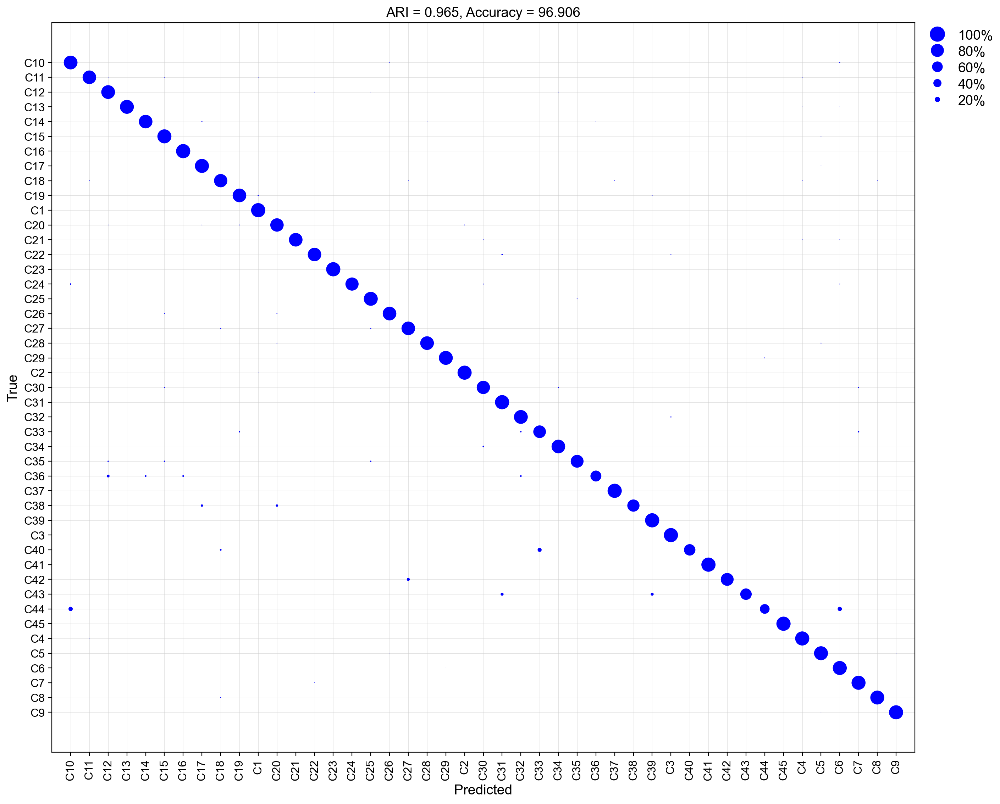

In [30]:
#subsampled run
plot_validation_plots(validation_label_train_70, valid_predlabels_train_70, train_dict=atlas_dict)

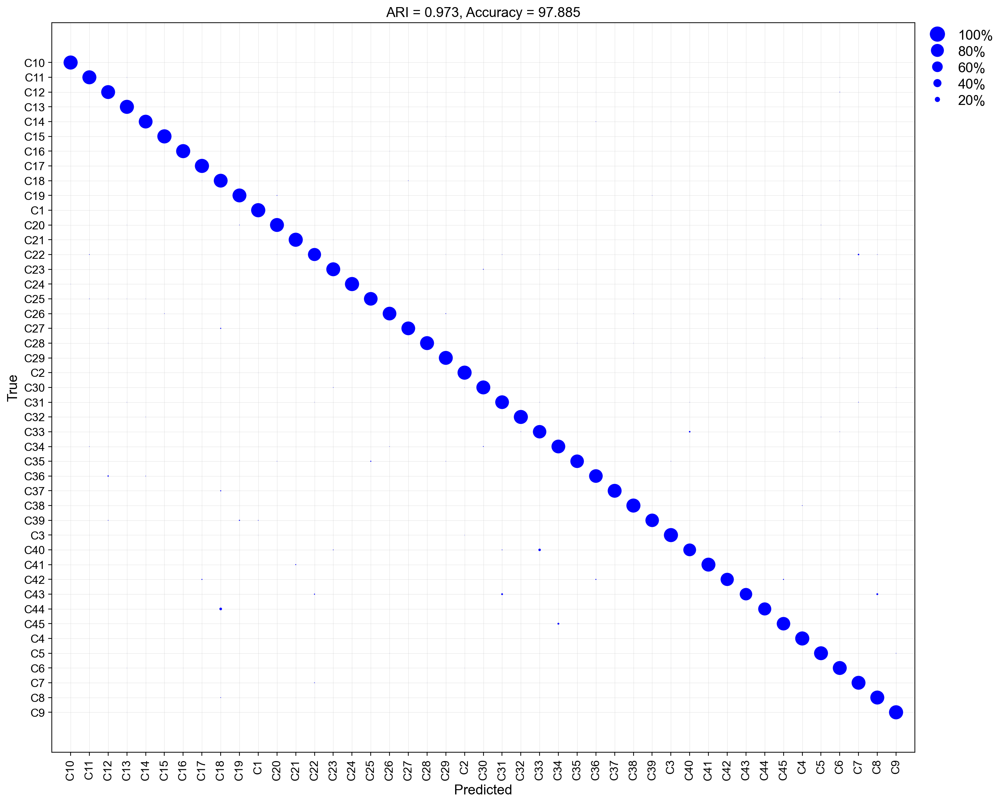

In [38]:
#full run
plot_validation_plots(validation_label_train_70, valid_predlabels_train_70, train_dict=atlas_dict)

## Run 2 (DR common HVGs)

In [835]:
len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(dr_corr[:,dr_corr.var.highly_variable].var_names))), len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(rd1[:,rd1.var.highly_variable].var_names))),  len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(Vsx2[:,Vsx2.var.highly_variable].var_names)))

(1066, 1002, 1158)

In [1123]:
len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(dr_corr[:,dr_corr.var.highly_variable].var_names))), len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(rd1[:,rd1.var.highly_variable].var_names))),  len(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(Vsx2[:,Vsx2.var.highly_variable].var_names)))

(1066, 1002, 1158)

In [836]:
atlas_dict = {}
for num,i in enumerate(atlas.obs['Type_num'].values.categories):
    atlas_dict[i] = num

# atlas_red = atlas.copy()
# sc.pp.subsample(atlas_red, fraction=0.25)
# atlas_red.X = atlas_red.raw.X

In [1132]:
dr_atlas_hvgs = list(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(dr_corr[:,dr_corr.var.highly_variable].var_names)))

In [226]:
# atlas_sub = atlas.copy()
# sc.pp.subsample(atlas_sub, fraction=0.25)

In [841]:
atlas.X = atlas.raw.X

In [842]:
valid_truelabel_atlas_dr, valid_predlabels_atlas_dr, model_atlas_dr = trainclassifier(train_anndata=atlas, 
                                                                                             common_top_genes=dr_atlas_hvgs, 
                                                                                             obs_id='Type_num', 
                                                                                             train_dict=atlas_dict, 
                                                                                             eta=0.2,
                                                                                             max_cells_per_ident=1000, train_frac=0.7, 
                                                                                             min_cells_per_ident=100)


trainclassifier() complete after 1691.0 seconds


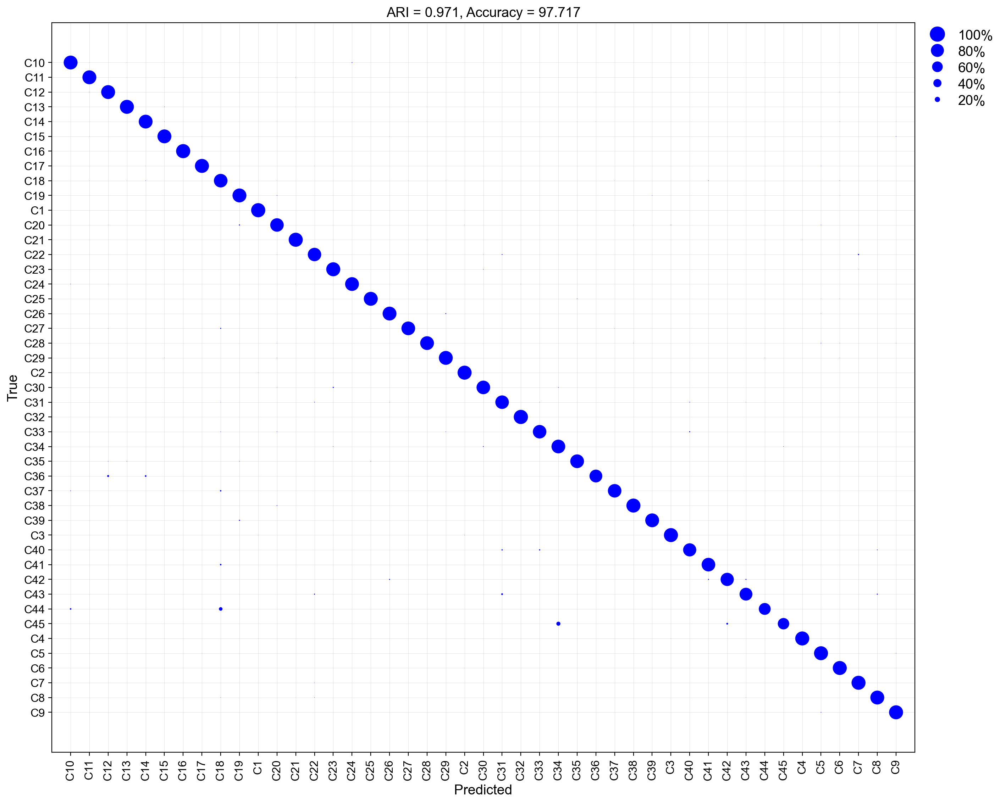

In [843]:
plot_validation_plots(valid_truelabel_atlas_dr, valid_predlabels_atlas_dr, train_dict=atlas_dict)

## Run 3 (rd1 common HVGs)

In [1136]:
rd1_atlas_hvgs = list(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(rd1[:,rd1.var.highly_variable].var_names)))

In [845]:
valid_truelabel_atlas_rd1, valid_predlabels_atlas_rd1, model_atlas_rd1 = trainclassifier(train_anndata=atlas, 
                                                                                             common_top_genes=rd1_atlas_hvgs, 
                                                                                             obs_id='Type_num', 
                                                                                             train_dict=atlas_dict, 
                                                                                             eta=0.2,
                                                                                             max_cells_per_ident=1000, train_frac=0.7, 
                                                                                             min_cells_per_ident=100)


trainclassifier() complete after 1578.0 seconds


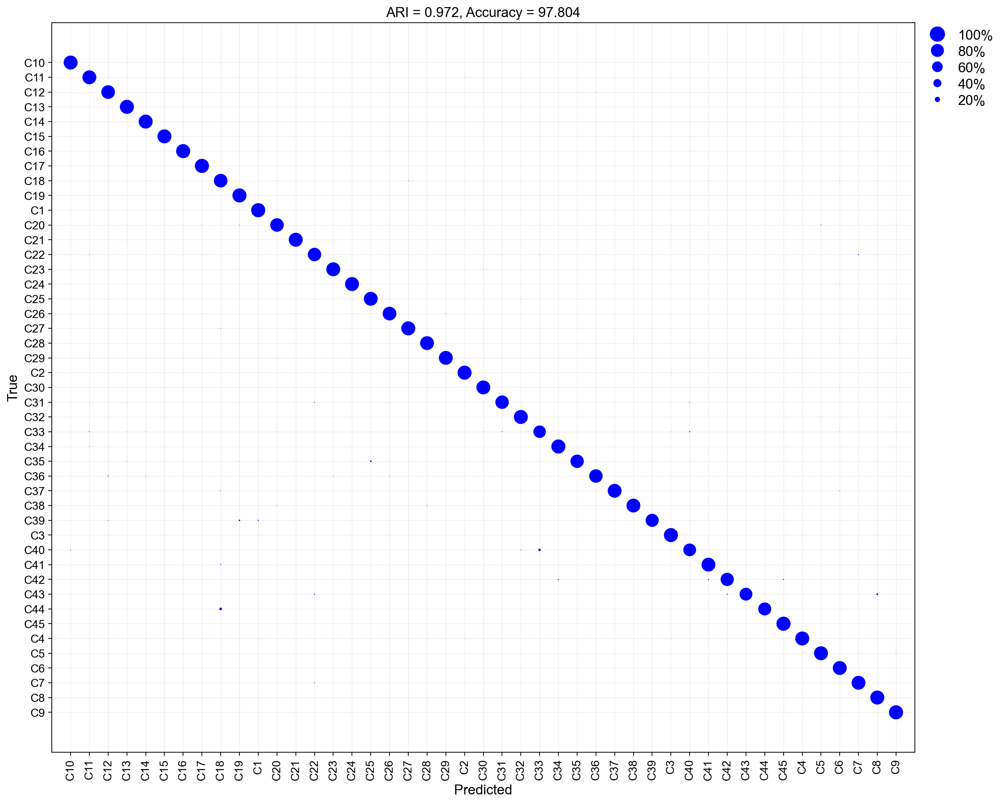

In [846]:
plot_validation_plots(valid_truelabel_atlas_rd1, valid_predlabels_atlas_rd1, train_dict=atlas_dict)

## Run 4 (Vsx2 common HVGs)

In [1153]:
vsx2_atlas_hvgs = list(set(atlas[:,atlas.var.highly_variable].var_names).intersection(set(Vsx2[:,Vsx2.var.highly_variable].var_names)))

In [848]:
valid_truelabel_atlas_vsx2, valid_predlabels_atlas_vsx2, model_atlas_vsx2 = trainclassifier(train_anndata=atlas, 
                                                                                             common_top_genes=vsx2_atlas_hvgs, 
                                                                                             obs_id='Type_num', 
                                                                                             train_dict=atlas_dict, 
                                                                                             eta=0.2,
                                                                                             max_cells_per_ident=1000, train_frac=0.7, 
                                                                                             min_cells_per_ident=100)


trainclassifier() complete after 1510.0 seconds


# Train on VDs to refine clusters

## DR

In [1130]:
dr_corr.X = dr_corr.raw.X

dr_dict = {}
for num,i in enumerate(dr_corr.obs['leiden_new'].values.categories):
    dr_dict[i] = num

# dr_corr_sub = dr_corr.copy()
# sc.pp.subsample(dr_corr_sub, fraction=0.25)

In [1133]:
valid_truelabel_dr, valid_predlabels_dr, model_dr = trainclassifier(train_anndata=dr_corr, 
                                                                    common_top_genes=dr_atlas_hvgs, 
                                                                    obs_id='leiden_new', 
                                                                    train_dict=dr_dict, 
                                                                    eta=0.2,
                                                                    max_cells_per_ident=700, train_frac=0.7, 
                                                                    min_cells_per_ident=200)


trainclassifier() complete after 740.0 seconds


None of the inconsistencies below are due to relative cluster distances in UMAP space, so re-run with full dataset.

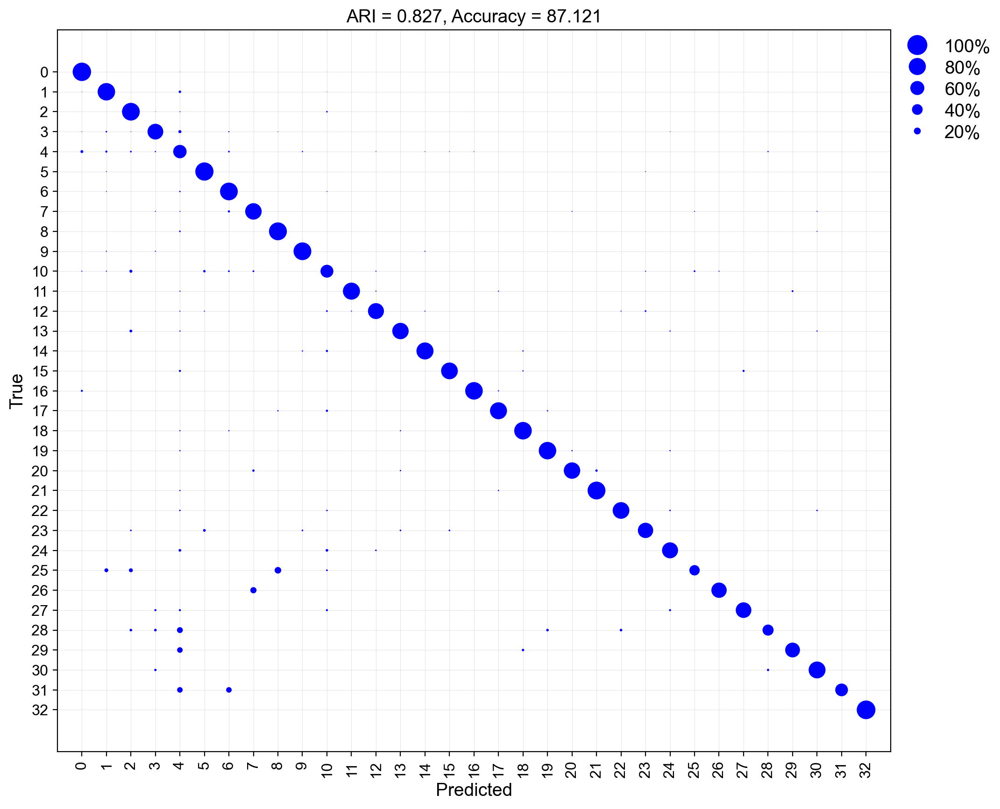

In [455]:
#subsampled run
plot_validation_plots(valid_truelabel_dr, valid_predlabels_dr, train_dict=dr_dict)

In [1139]:
dr_corr.obs['leiden_new'].values.categories

Index(['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
       '2', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '3',
       '4', '5', '6', '7', '8', '9'],
      dtype='object')

array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29'], dtype='<U21')

In [1142]:
dr_dict = {}
for num,i in enumerate(np.arange(30).astype('str')):
    dr_dict[i] = num

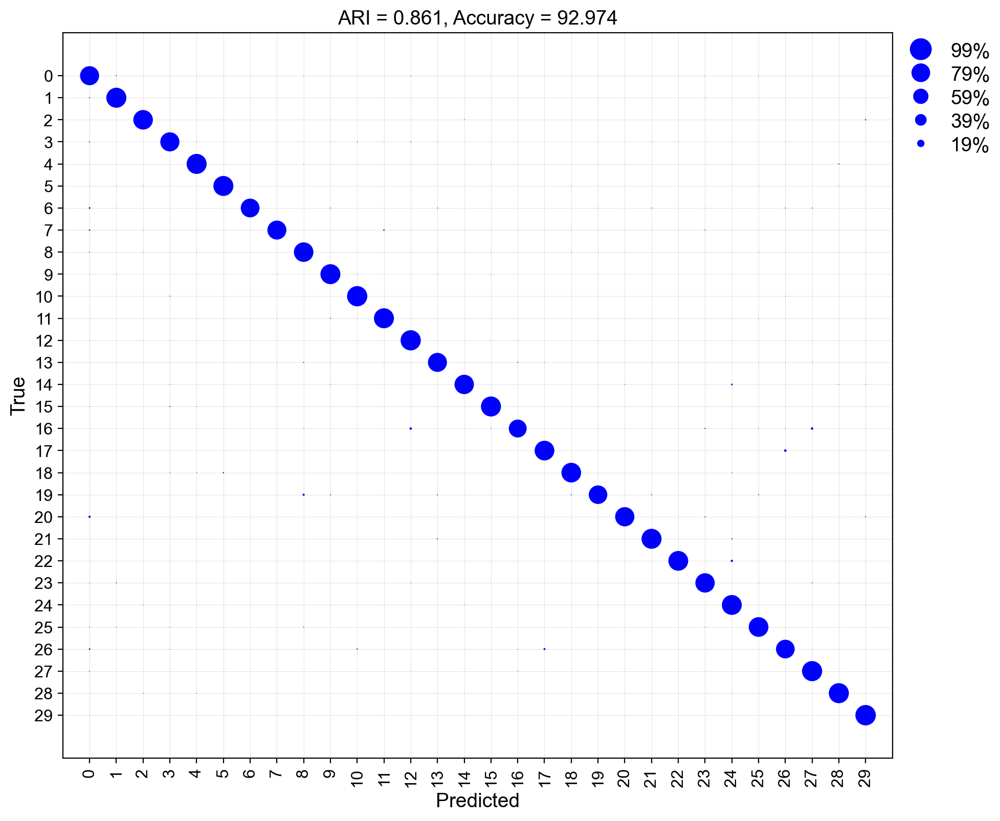

In [1148]:
#full run
plot_validation_plots(valid_truelabel_dr, valid_predlabels_dr, train_dict=dr_dict, 
                      save_as='figures/DR_train_cfm.pdf')

## rd1

In [1135]:
rd1.X = rd1.raw.X

rd1_dict = {}
for num,i in enumerate(rd1.obs['leiden_new'].values.categories):
    rd1_dict[i] = num

# rd1_sub = rd1.copy()
# sc.pp.subsample(rd1_sub, fraction=0.25)

In [1137]:
valid_truelabel_rd1, valid_predlabels_rd1, model_rd1 = trainclassifier(train_anndata=rd1_sub, 
                                                                    common_top_genes=rd1_atlas_hvgs, 
                                                                    obs_id='leiden_new', 
                                                                    train_dict=rd1_dict, 
                                                                    eta=0.2,
                                                                    max_cells_per_ident=500, train_frac=0.7, 
                                                                    min_cells_per_ident=50)

NameError: name 'rd1_sub' is not defined

Merge 31 and 1

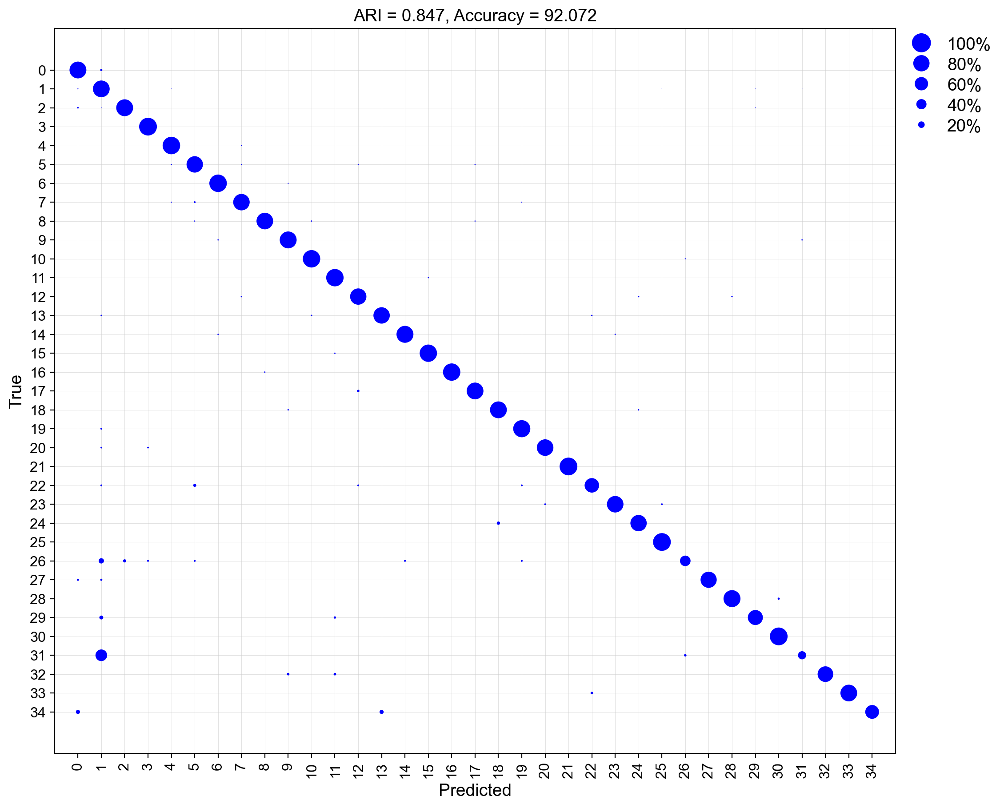

In [463]:
#subsampled run
plot_validation_plots(valid_truelabel_rd1, valid_predlabels_rd1, train_dict=rd1_dict)

In [486]:
rd1_leiden_new = []

for i in (rd1.obs.leiden):
    if (i in ('31','1')):
        rd1_leiden_new.append('31_1')
        
    else:
        rd1_leiden_new.append(i)

In [487]:
rd1_leiden_new_cat = pd.Categorical(rd1_leiden_new)
rd1_leiden_new_cat.value_counts().sort_values(ascending=False)

31_1    1379
0       1341
2        964
3        779
4        770
5        577
6        557
7        545
8        495
10       485
9        485
11       462
12       439
13       420
14       403
15       388
16       371
17       357
18       352
19       350
20       321
21       314
22       308
23       283
24       280
25       276
26       235
27       226
28       211
29       210
30       195
32       177
33       144
34        91
dtype: int64

In [488]:
a = rd1_leiden_new_cat.reorder_categories(list(rd1_leiden_new_cat.value_counts().sort_values(ascending=False).index))
a.value_counts().sort_values(ascending=False)

31_1    1379
0       1341
2        964
3        779
4        770
5        577
6        557
7        545
8        495
10       485
9        485
11       462
12       439
13       420
14       403
15       388
16       371
17       357
18       352
19       350
20       321
21       314
22       308
23       283
24       280
25       276
26       235
27       226
28       211
29       210
30       195
32       177
33       144
34        91
dtype: int64

In [491]:
a

['16', '11', '11', '5', '28', ..., '31_1', '16', '16', '24', '16']
Length: 15190
Categories (34, object): ['31_1', '0', '2', '3', ..., '30', '32', '33', '34']

In [492]:
b = a.rename_categories(np.arange(34))
b.value_counts().sort_values(ascending=False)

0     1379
1     1341
2      964
3      779
4      770
5      577
6      557
7      545
8      495
9      485
10     485
11     462
12     439
13     420
14     403
15     388
16     371
17     357
18     352
19     350
20     321
21     314
22     308
23     283
24     280
25     276
26     235
27     226
28     211
29     210
30     195
31     177
32     144
33      91
dtype: int64

In [493]:
rd1.obs['leiden_new'] = b

In [173]:
rd1_dict = {}
for num,i in enumerate(rd1.obs['leiden_new'].values.categories):
    rd1_dict[i] = num

In [1149]:
valid_truelabel_rd1, valid_predlabels_rd1, model_rd1 = trainclassifier(train_anndata=rd1, 
                                                                    common_top_genes=rd1_atlas_hvgs, 
                                                                    obs_id='leiden_new', 
                                                                    train_dict=rd1_dict, 
                                                                    eta=0.2,
                                                                    max_cells_per_ident=700, train_frac=0.7, 
                                                                    min_cells_per_ident=200)

trainclassifier() complete after 451.0 seconds


In [1156]:
rd1_dict = {}
for num,i in enumerate(np.arange(len(rd1.obs['leiden_new'].values.categories)).astype('str')):
    rd1_dict[i] = num

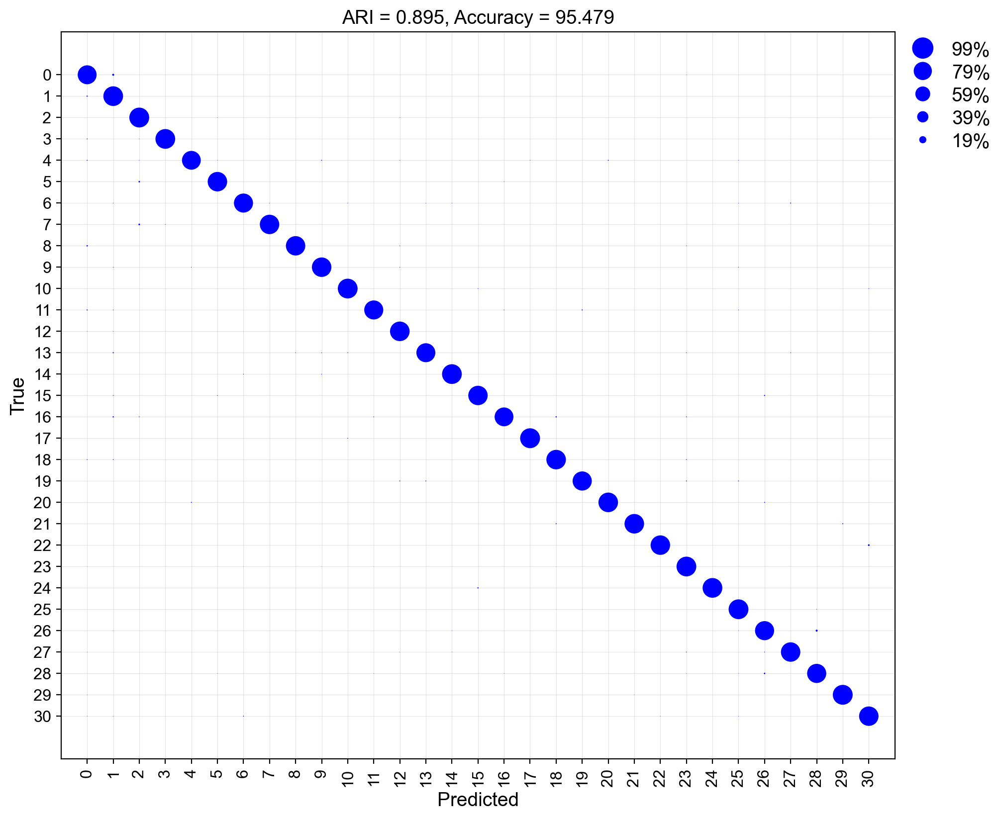

In [1157]:
#full run
plot_validation_plots(valid_truelabel_rd1, valid_predlabels_rd1, train_dict=rd1_dict,
                     save_as='figures/rd1_train_cfm.pdf')

## Vsx2

In [1151]:
Vsx2.X = Vsx2.raw.X

Vsx2_dict = {}
for num,i in enumerate(Vsx2.obs['leiden_new'].values.categories):
    Vsx2_dict[i] = num

# Vsx2_sub = Vsx2.copy()
# sc.pp.subsample(Vsx2_sub, fraction=0.25)

In [467]:
valid_truelabel_Vsx2, valid_predlabels_Vsx2, model_Vsx2 = trainclassifier(train_anndata=Vsx2_sub, 
                                                                    common_top_genes=vsx2_atlas_hvgs, 
                                                                    obs_id='leiden', 
                                                                    train_dict=Vsx2_dict, 
                                                                    eta=0.2,
                                                                    max_cells_per_ident=200, train_frac=0.7, 
                                                                    min_cells_per_ident=50)

trainclassifier() complete after 223.0 seconds


Merge 40 and 9; 41 and 0; 44 and 2; 45 and 22

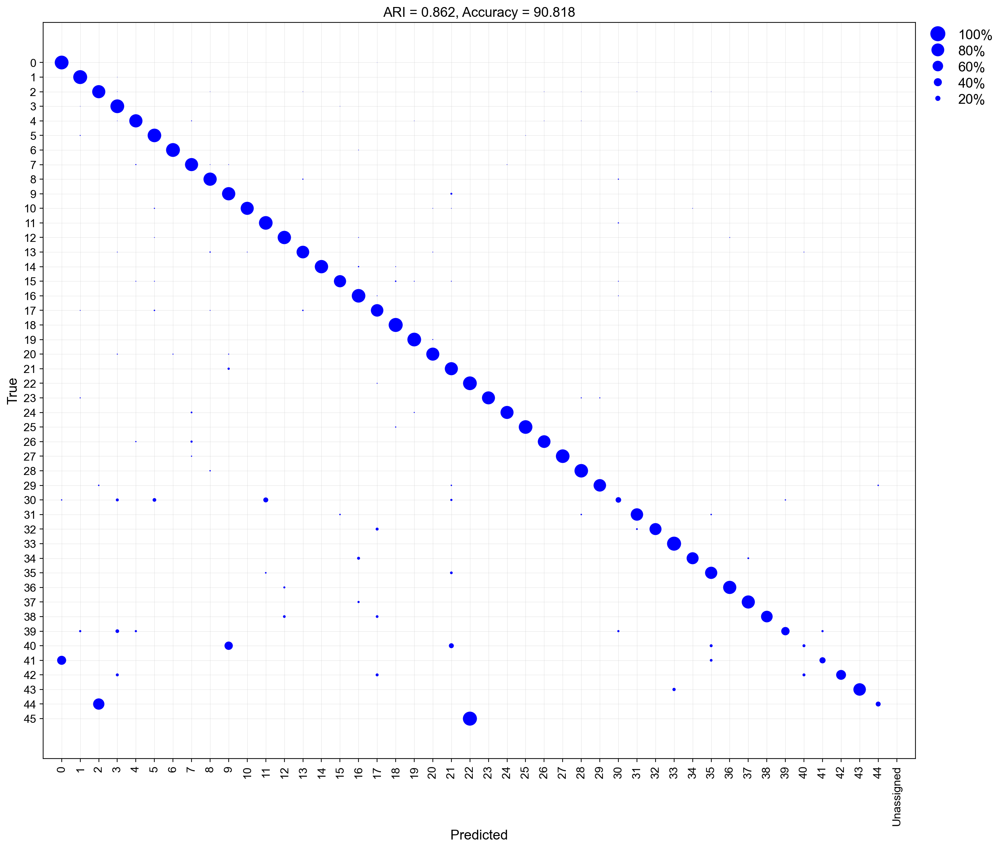

In [468]:
#subsample run
plot_validation_plots(valid_truelabel_Vsx2, valid_predlabels_Vsx2, train_dict=Vsx2_dict)

In [490]:
Vsx2_leiden_new = []

for i in (Vsx2.obs.leiden):
    if (i in ('40','9')):
        Vsx2_leiden_new.append('40_9')
        
    elif (i in ('41','0')):
        Vsx2_leiden_new.append('41_0')
        
    elif (i in ('44','2')):
        Vsx2_leiden_new.append('44_2')
        
    elif (i in ('45','22')):
        Vsx2_leiden_new.append('45_22')
        
    else:
        Vsx2_leiden_new.append(i)

In [494]:
Vsx2_leiden_new_cat = pd.Categorical(Vsx2_leiden_new)
Vsx2_leiden_new_cat.value_counts().sort_values(ascending=False)

41_0     1408
1        1262
44_2     1175
3        1050
4        1048
5         960
40_9      826
6         764
7         750
8         722
10        695
11        664
12        657
13        637
14        621
15        562
16        561
17        519
45_22     517
18        513
19        504
20        497
21        478
23        434
24        413
25        363
26        340
27        336
28        328
29        282
30        274
31        232
32        229
33        214
34        211
35        202
36        179
37        154
38        151
39        145
42        104
43        102
dtype: int64

In [495]:
a = Vsx2_leiden_new_cat.reorder_categories(list(Vsx2_leiden_new_cat.value_counts().sort_values(ascending=False).index))
a.value_counts().sort_values(ascending=False)

41_0     1408
1        1262
44_2     1175
3        1050
4        1048
5         960
40_9      826
6         764
7         750
8         722
10        695
11        664
12        657
13        637
14        621
15        562
16        561
17        519
45_22     517
18        513
19        504
20        497
21        478
23        434
24        413
25        363
26        340
27        336
28        328
29        282
30        274
31        232
32        229
33        214
34        211
35        202
36        179
37        154
38        151
39        145
42        104
43        102
dtype: int64

In [500]:
b = a.rename_categories(np.arange(42))
b.value_counts().sort_values(ascending=False)

0     1408
1     1262
2     1175
3     1050
4     1048
5      960
6      826
7      764
8      750
9      722
10     695
11     664
12     657
13     637
14     621
15     562
16     561
17     519
18     517
19     513
20     504
21     497
22     478
23     434
24     413
25     363
26     340
27     336
28     328
29     282
30     274
31     232
32     229
33     214
34     211
35     202
36     179
37     154
38     151
39     145
40     104
41     102
dtype: int64

In [501]:
Vsx2.obs['leiden_new'] = b

In [186]:
Vsx2_dict = {}
for num,i in enumerate(Vsx2.obs['leiden_new'].values.categories):
    Vsx2_dict[i] = num

In [1154]:
valid_truelabel_Vsx2, valid_predlabels_Vsx2, model_Vsx2 = trainclassifier(train_anndata=Vsx2, 
                                                                    common_top_genes=vsx2_atlas_hvgs, 
                                                                    obs_id='leiden_new', 
                                                                    train_dict=Vsx2_dict, 
                                                                    eta=0.2,
                                                                    max_cells_per_ident=700, train_frac=0.7, 
                                                                    min_cells_per_ident=200)

trainclassifier() complete after 990.0 seconds


In [1158]:
Vsx2_dict = {}
for num,i in enumerate(np.arange(len(Vsx2.obs['leiden_new'].values.categories)).astype('str')):
    Vsx2_dict[i] = num

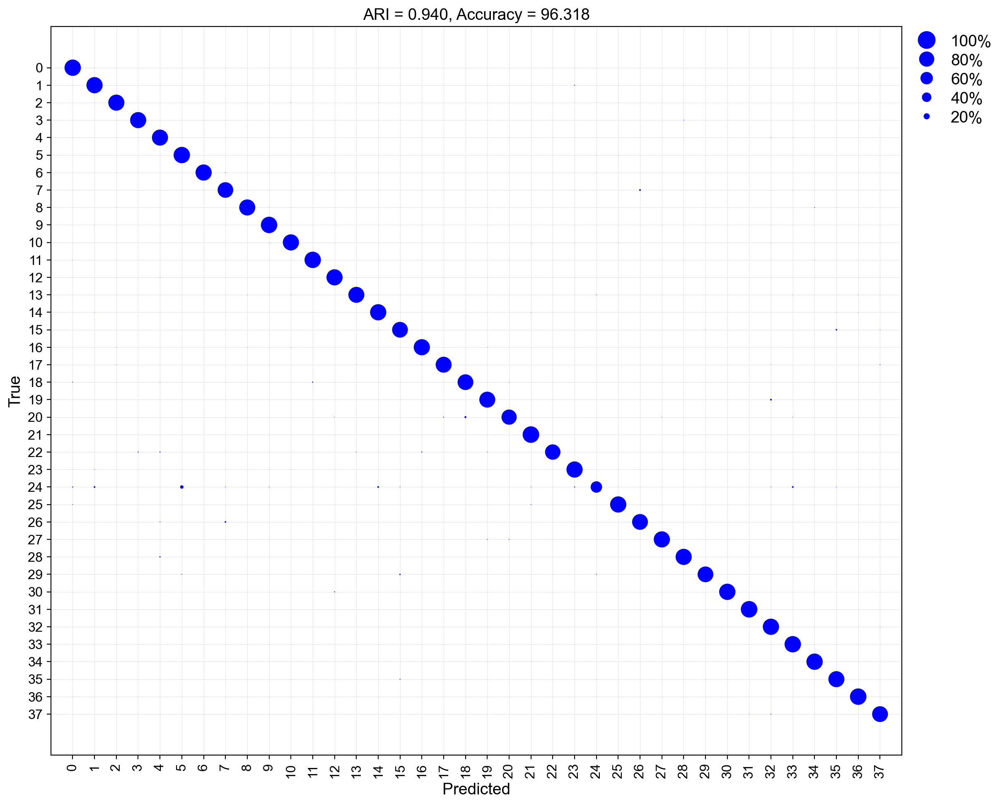

In [1159]:
#full run
plot_validation_plots(valid_truelabel_Vsx2, valid_predlabels_Vsx2, train_dict=Vsx2_dict, 
                     save_as='figures/Vsx2_train_cfm.pdf')

# Save VD objects and atlas

In [1186]:
dr_corr.write_h5ad('DR_processed.h5ad')
rd1.write_h5ad('rd1_processed.h5ad')
Vsx2.write_h5ad('Vsx2_processed.h5ad')

In [1198]:
atlas.write_h5ad('atlas_processed.h5ad')

In [6]:
dr_corr = sc.read_h5ad('DR_processed.h5ad')
rd1 = sc.read_h5ad('rd1_processed.h5ad')
Vsx2 = sc.read_h5ad('Vsx2_processed.h5ad')

In [7]:
atlas = sc.read_h5ad('atlas_processed.h5ad')

# Map to atlas

* do mapping and record each cell's mapping in the .obs df
* make validation and mapping cfm plot
* make umap colored by mapping C1-C45 cluster
* prob of each mapping

## DR

In [851]:
test_labels_dr, test_predlabels_dr, test_prediction_dr = predict(train_anndata=atlas, 
                                                                 common_top_genes=dr_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_dr, 
                                                                 test_anndata=dr_corr,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=dr_dict, 
                                                                 test_obs_id='leiden')

In [217]:
dr_dict.keys()

dict_keys(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25', '26', '27', '28', '29', '30', '31', '32'])

In [865]:
dr_cols  = ['C1', 'C2', 'C5', 'C9',
            'C3', 'C40', 'C33','C6', 
       'C19',
            'C4',  'C28','C10', 'C7', 'C8',
            'C26', 'C29','C24', 'C16',
            'C18',  'C37', 'C41','C11', 'C14',  'C36',   'C34',
            'C23', 'C30','C13', 
            'C25', 'C35', 'C12',
             'C15', 'C31','C17', 
              'C20',
        'C27', 'C21', 'C22',
           'C38', 'C32', 'C44', 
       'C45',  'C39', 
        'C43',  'C42',]

dr_rows = ['10','4', '32', '0', '1', '2', '3', '5', '6', '7', '8',  '25','9', '11', '12', '13', '14', '15', '16', 
           '17', '18', '19', '20', '21', '22', '23', '24', '26', '27', '28', '29', '30', '31']

figures/dr_atlas_mapping.pdf


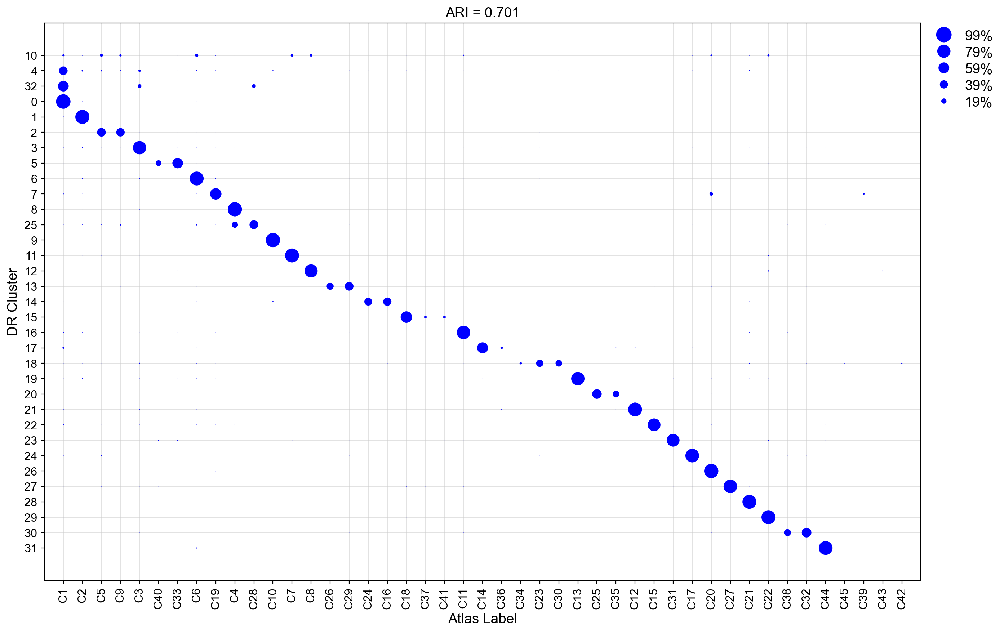

In [867]:
plot_mapping(test_labels=test_labels_dr, 
             test_predlabels=test_predlabels_dr, 
             test_dict=dr_dict, 
             train_dict=atlas_dict,
             re_order=True, re_order_cols=dr_cols,
             re_index=True, re_order_rows=dr_rows,
                 xaxislabel='Atlas Label', yaxislabel='DR Cluster',)
#            save_as='figures/dr_atlas_mapping.pdf')

Merge 4, 32, 0, remove 10

In [890]:
dr_corr = dr_corr[dr_corr.obs.leiden!='10',:]

dr_corr_leiden_new = []

for i in (dr_corr.obs.leiden):
    if (i in ('4','32', '0')):
        dr_corr_leiden_new.append('4_32_0')
        
    else:
        dr_corr_leiden_new.append(i)

In [920]:
dr_corr_leiden_new_cat = pd.Categorical(dr_corr_leiden_new)
dr_corr_leiden_new_cat.value_counts().sort_values(ascending=False)

a = dr_corr_leiden_new_cat.reorder_categories(list(dr_corr_leiden_new_cat.value_counts().sort_values(ascending=False).index))

b = a.rename_categories(np.arange(len(a.categories)))
b.value_counts().sort_values(ascending=False)

dr_corr.obs['leiden_new'] = b

dr_corr.obs['leiden_new'] = pd.Categorical(dr_corr.obs['leiden_new'].values.astype('str'))

dr_dict = make_dict(dr_corr, obs_id='leiden_new')

In [1048]:
dr_dict = make_dict(dr_corr, obs_id='leiden_new')

In [921]:
test_labels_dr, test_predlabels_dr, test_prediction_dr = predict(train_anndata=atlas, 
                                                                 common_top_genes=dr_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_dr, 
                                                                 test_anndata=dr_corr,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=dr_dict, 
                                                                 test_obs_id='leiden_new')

In [932]:
dr_cols  = [ 'C8','C40', 'C33','C1', 'C2', 'C5', 'C9',
            'C3', 'C6', 
       'C19',
            'C4',  'C28','C10',  'C27','C7',
            'C26', 'C29','C24', 'C16',
            'C18',  'C37', 'C41','C11', 'C14',  'C36',   'C34',
            'C23', 'C30','C13', 
            'C25', 'C35', 'C12',
             'C15', 'C31','C17', 
              'C20',
        'C21', 'C22',
           'C38', 'C32', 'C44', 
       'C45',  'C39', 
        'C43',  'C42',]

dr_rows = ['10','4',  '0', '1', '2', '3', '5', '6', '7','23', '8',  '25','9', '11', '12', '13', '14', '15', '16', 
           '17', '18', '19', '20', '21', '22',  '24', '26', '27', '28', '29',]

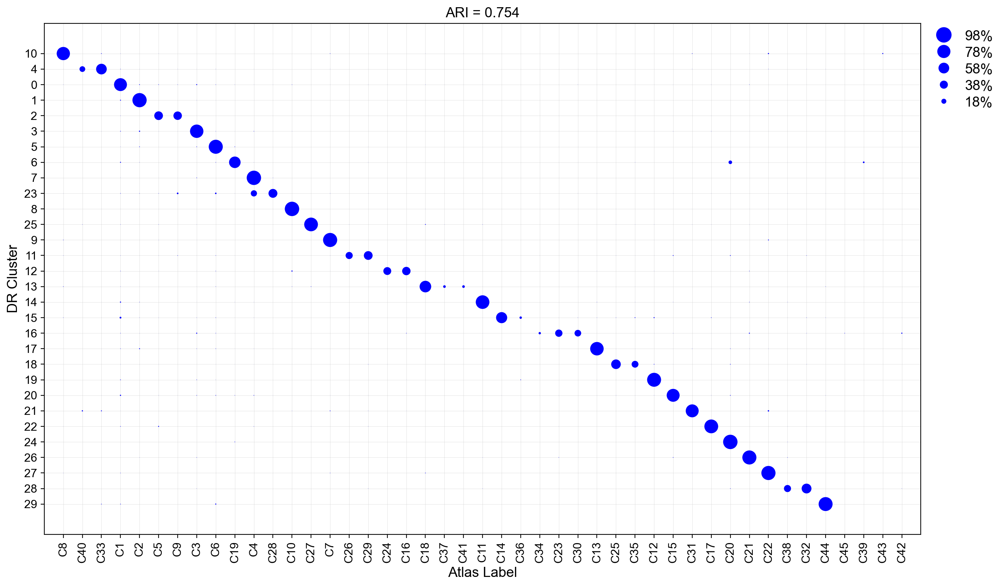

In [935]:
plot_mapping(test_labels=test_labels_dr, 
             test_predlabels=test_predlabels_dr, 
             test_dict=dr_dict, 
             train_dict=atlas_dict,
              re_order=True, re_order_cols=dr_cols,
              re_index=True, re_order_rows=dr_rows,
                 xaxislabel='Atlas Label', yaxislabel='DR Cluster',
            save_as='figures/dr_atlas_mapping.pdf')

In [ ]:
mod = xgb.Booster()
mod.load_model("XGB_models/atlas_dr.pickle.dat")

In [937]:
def encode_dict(orig_dict, labels):
    dict_series = pd.Series(orig_dict)
    encoded_labels = []
    for i in labels:
        encoded_labels.append(dict_series.index[i])
    return encoded_labels

dr_corr.obs['Prob'] = np.max(test_prediction_dr, axis=1)

dr_corr.obs['Atlas Label'] =  encode_dict(atlas_dict, test_predlabels_dr)

... storing 'Atlas Label' as categorical


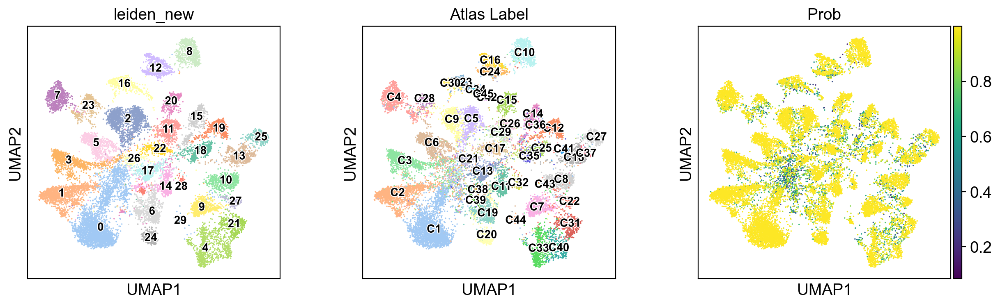

In [938]:
sc.pl.umap(dr_corr, color=['leiden_new', 'Atlas Label', 'Prob'], legend_loc='on data', palette=type_cols, 
           legend_fontoutline=1.5, legend_fontsize=10, 
          add_outline=False)

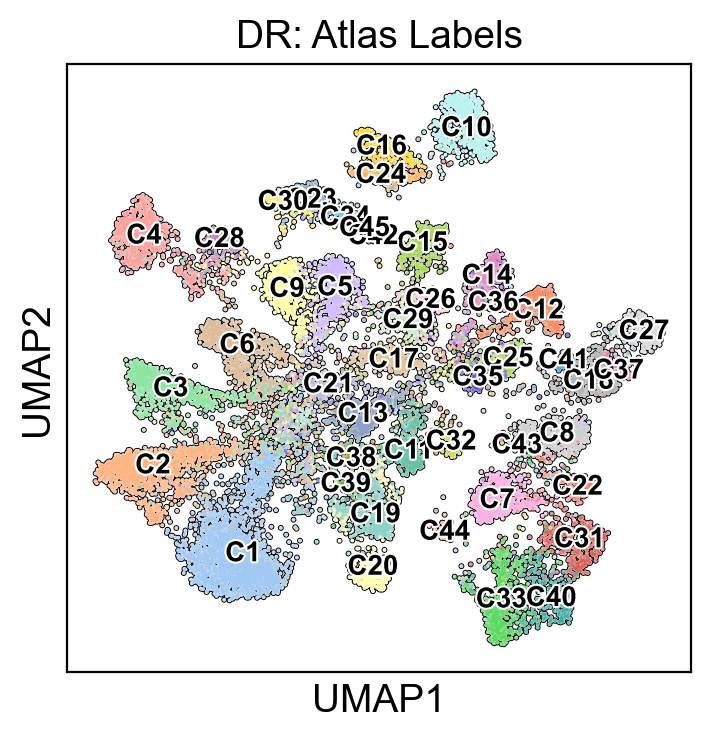

In [939]:
sc.pl.umap(dr_corr, color=['Atlas Label'], title='DR: Atlas Labels',
           legend_fontoutline=1.5, legend_fontsize=10, legend_loc='on data', palette=type_cols,
          add_outline=True, save='_DR_type.pdf')

In [951]:
type_cols = sn.color_palette('pastel').as_hex()+sn.color_palette('Set3').as_hex()+sn.color_palette('Set2').as_hex()+sn.color_palette('hls').as_hex()+sn.color_palette('husl').as_hex()
dr_corr.uns['leiden_new_colors']= type_cols

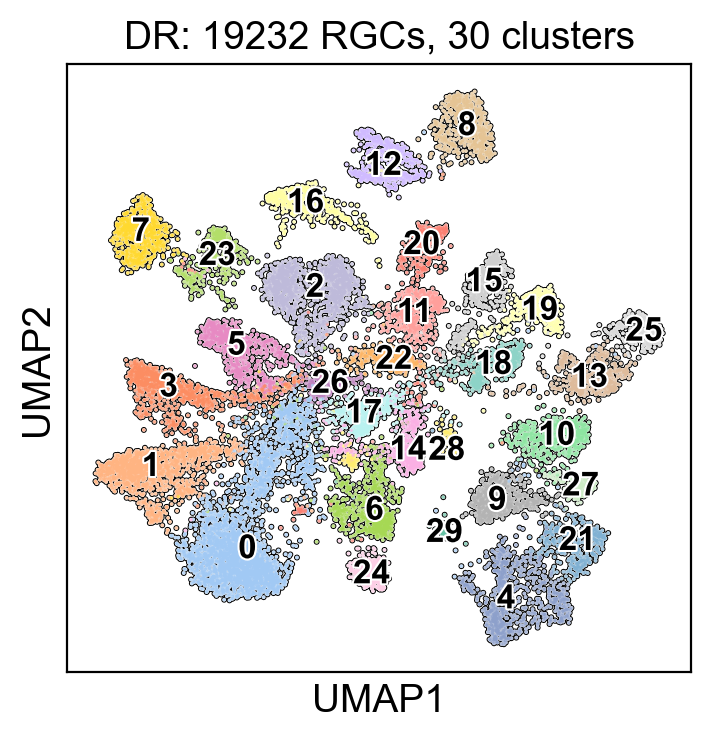

In [952]:
sc.pl.umap(dr_corr, color=['leiden_new'], title='DR: '+ str(dr_corr.shape[0])+ ' RGCs, ' + str(len(dr_corr.obs.leiden_new.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data',
          add_outline=True, save='_DR_leiden.pdf')

## rd1

In [175]:
test_labels_rd1, test_predlabels_rd1, test_prediction_rd1 = predict(train_anndata=atlas, 
                                                                 common_top_genes=rd1_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_rd1, 
                                                                 test_anndata=rd1,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=rd1_dict, 
                                                                 test_obs_id='leiden_new')

In [263]:
re_cats = ['C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8',
       'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16',
       'C17', 'C18', 'C19', 'C20', 'C21', 'C22',
       'C23', 'C24', 'C25', 'C26', 'C27', 'C28', 'C29',
        'C30', 'C31', 'C32', 'C33', 'C34',
       'C35', 'C36', 'C37', 'C38', 'C39', 'C40',
       'C41', 'C42', 'C43', 'C44',
       'C45', ]

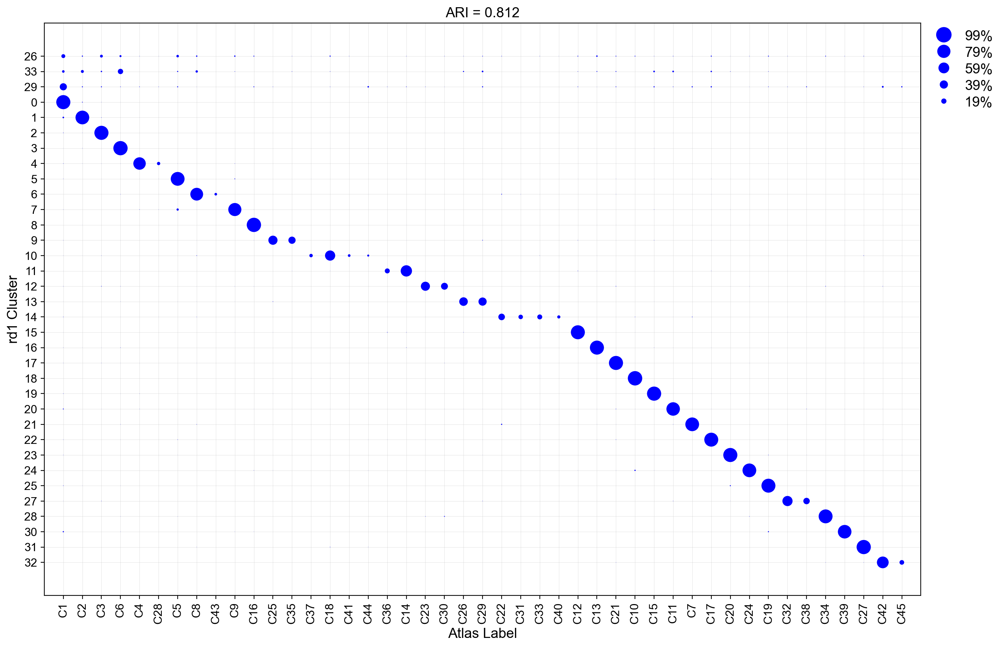

In [538]:
rd1_cols = ['C1', 'C2', 'C3',  'C6', 'C4', 'C28',
            'C5',  'C8', 'C43', 'C9', 'C16', 
            'C25', 'C35','C37', 'C18',  
       'C41',  'C44',  'C36',
            'C14', 'C23', 'C30', 
            'C26', 'C29', 'C22','C31', 'C33', 
          'C40',
            'C12','C13',  
             'C21',  'C10',
             'C15', 'C11', 
            'C7',  'C17',
       'C20', 'C24',   'C19','C32',  'C38','C34',
          'C39',   'C27', 'C42',
          'C45', ]

rd1_rows = ['26', '33', '29', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '27', '28', '30', '31', '32']

rd1_rows = np.array(rd1_rows).astype(int)

plot_mapping(test_labels=test_labels_rd1, 
             test_predlabels=test_predlabels_rd1, 
             test_dict=rd1_dict, 
             train_dict=atlas_dict,  
             re_order=True, re_order_cols=rd1_cols, 
              re_index=True, re_order_rows=rd1_rows, 
                 xaxislabel='Atlas Label', yaxislabel='rd1 Cluster', 
            save_as='figures/rd1_atlas_mapping.pdf')

Merge 0, 29. remove 26, 33

In [979]:
rd1 = rd1[rd1.obs.leiden_new!='26',:]
rd1 = rd1[rd1.obs.leiden_new!='33',:]

rd1_leiden_new = []

for i in (rd1.obs.leiden_new):
    if (i in ('29', '0')):
        rd1_leiden_new.append('29_0')
        
    else:
        rd1_leiden_new.append(i)

rd1_leiden_new_cat = pd.Categorical(rd1_leiden_new)
rd1_leiden_new_cat.value_counts().sort_values(ascending=False)

a = rd1_leiden_new_cat.reorder_categories(list(rd1_leiden_new_cat.value_counts().sort_values(ascending=False).index))

b = a.rename_categories(np.arange(len(a.categories)))
b.value_counts().sort_values(ascending=False)

rd1.obs['leiden_new'] = b

rd1.obs['leiden_new'] = pd.Categorical(rd1.obs['leiden_new'].values.astype('str'))

rd1_dict = make_dict(rd1, obs_id='leiden_new')

In [980]:
test_labels_rd1, test_predlabels_rd1, test_prediction_rd1 = predict(train_anndata=atlas, 
                                                                 common_top_genes=rd1_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_rd1, 
                                                                 test_anndata=rd1,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=rd1_dict, 
                                                                 test_obs_id='leiden_new')

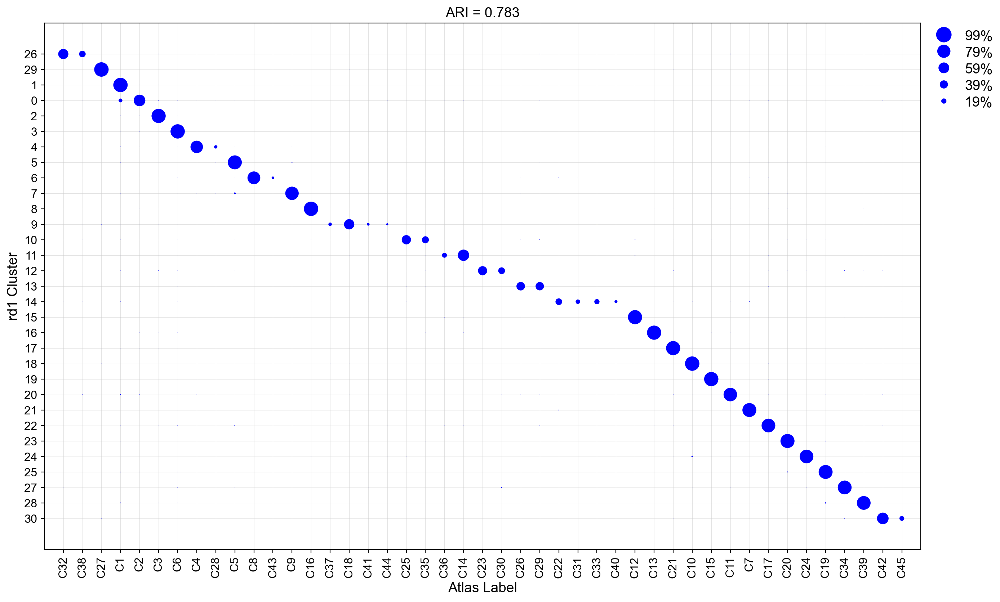

In [988]:
rd1_cols = ['C32',  'C38','C27','C1', 'C2', 'C3',  'C6', 'C4', 'C28',
            'C5',  'C8', 'C43', 'C9', 'C16', 
            'C37', 'C18', 'C41',  'C44','C25', 'C35', 
         'C36',
            'C14', 'C23', 'C30', 
            'C26', 'C29', 'C22','C31', 'C33', 
          'C40',
            'C12','C13',  
             'C21',  'C10',
             'C15', 'C11', 
            'C7',  'C17',
       'C20', 'C24',   'C19','C34',
          'C39',    'C42',
          'C45', ]

rd1_rows = ['26', '29',  '1', '0', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '27', '28', '30',]

#rd1_rows = np.array(rd1_rows).astype(int)

plot_mapping(test_labels=test_labels_rd1, 
             test_predlabels=test_predlabels_rd1, 
             test_dict=rd1_dict, 
             train_dict=atlas_dict,  
               re_order=True, re_order_cols=rd1_cols, 
                re_index=True, re_order_rows=rd1_rows, 
                 xaxislabel='Atlas Label', yaxislabel='rd1 Cluster', 
            save_as='figures/rd1_atlas_mapping.pdf')

In [989]:
rd1.obs['Prob'] = np.max(test_prediction_rd1, axis=1)
rd1.obs['Atlas Label'] = encode_dict(atlas_dict, test_predlabels_rd1)

... storing 'Atlas Label' as categorical


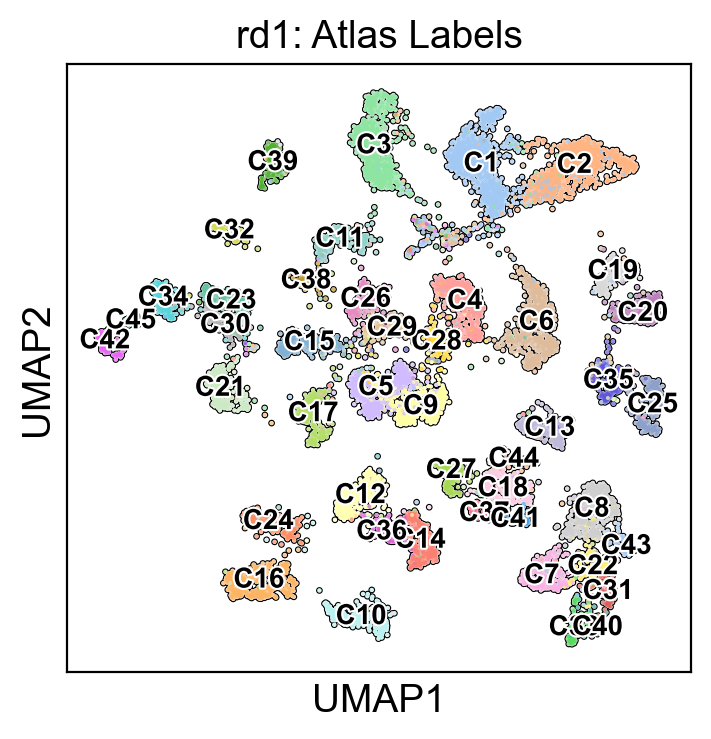

In [990]:
sc.pl.umap(rd1, color=['Atlas Label'], title='rd1: Atlas Labels',
           legend_fontoutline=1.5, legend_fontsize=10, legend_loc='on data', palette=type_cols,
          add_outline=True, save='_rd1_type.pdf')

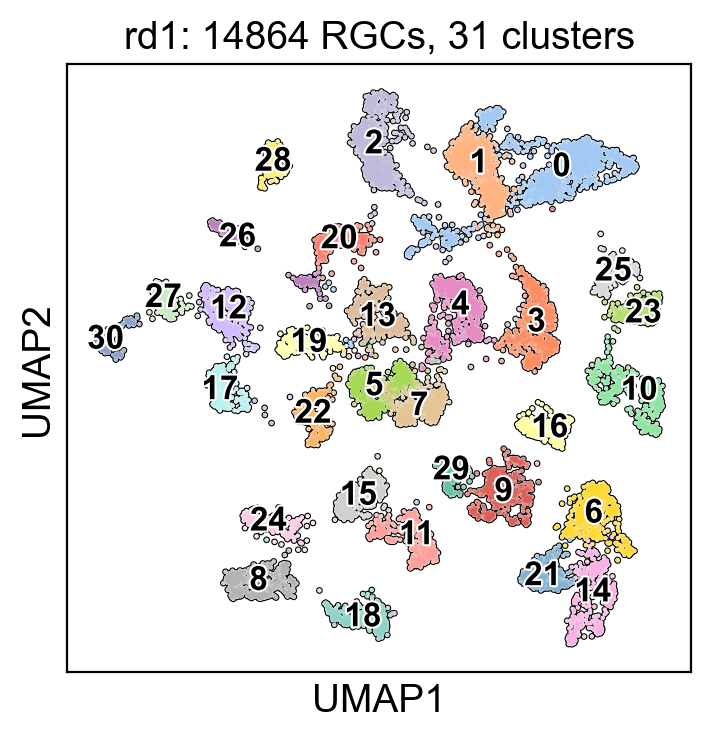

In [991]:
sc.pl.umap(rd1, color=['leiden_new'], title='rd1: '+ str(rd1.shape[0])+ ' RGCs, ' + str(len(rd1.obs.leiden_new.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data',palette=type_cols,
          add_outline=True,  save='_rd1_leiden.pdf')


## Vsx2-SE-/-

In [187]:
test_labels_Vsx2, test_predlabels_Vsx2, test_prediction_Vsx2 = predict(train_anndata=atlas, 
                                                                 common_top_genes=vsx2_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_vsx2, 
                                                                 test_anndata=Vsx2,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=Vsx2_dict, 
                                                                 test_obs_id='leiden_new')

In [297]:
np.array(list(Vsx2_dict.keys())).astype('str')

array(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23',
       '24', '25', '26', '27', '28', '29', '30', '31', '32', '33', '34',
       '35', '36', '37', '38', '39', '40', '41'], dtype='<U21')

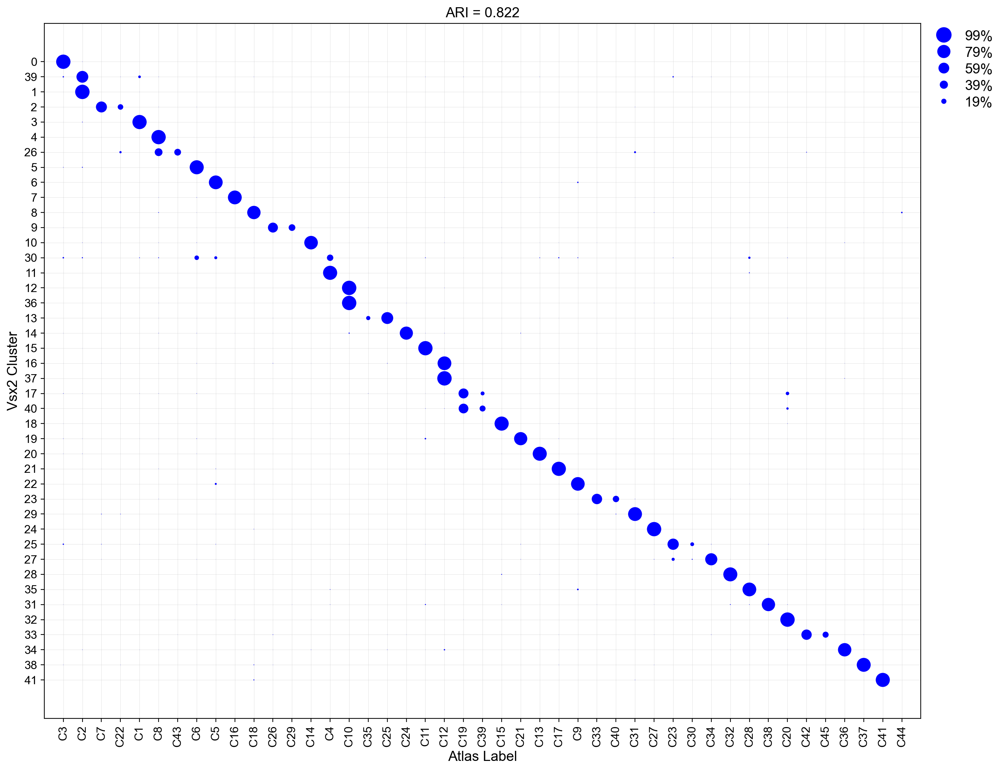

In [537]:
vsx2_cols = [ 'C3', 'C2',  'C7', 'C22','C1', 
             'C8','C43','C6',  'C5',  'C16',
             'C18','C26', 'C29',
              'C14', 'C4',  'C10','C35', 
              'C25', 'C24', 'C11',
              'C12','C19','C39', 
              'C15', 'C21','C13',
      'C17',  'C9',  'C33', 'C40','C31',
           'C27',   'C23',  'C30', 'C34',
             'C32', 'C28', 'C38',
             'C20', 'C42','C45','C36', 'C37',
             'C41', 'C44',]

vsx2_rows =  ['0','39',  '1', '2', '3', '4', '26', '5', '6', '7', '8', '9', '10', '30', '11', '12','36', 
              '13', '14', '15', '16',  '37', '17',  '40','18', '19', '20', '21', '22', '23', '29', '24', '25', 
              '27', '28',   '35',
              '31', '32', '33', '34', '38', '41', ]

vsx2_rows = np.array(vsx2_rows).astype(int)

plot_mapping(test_labels=test_labels_Vsx2, 
             test_predlabels=test_predlabels_Vsx2, 
             test_dict=Vsx2_dict, 
             train_dict=atlas_dict,
              re_order=True, re_order_cols=vsx2_cols,
              re_index=True, re_order_rows=vsx2_rows,
                 xaxislabel='Atlas Label', yaxislabel='Vsx2 Cluster', 
            save_as='figures/Vsx2_atlas_mapping.pdf')

In [994]:
Vsx2_leiden_new = []

for i in (Vsx2.obs.leiden_new):
    if (i in ('39', '1')):
        Vsx2_leiden_new.append('39_1')
        
    elif (i in ('12', '36')):
        Vsx2_leiden_new.append('12_36')
        
    elif (i in ('16', '37')):
        Vsx2_leiden_new.append('16_37')
        
    elif (i in ('40', '17')):
        Vsx2_leiden_new.append('40_17')
        
    else:
        Vsx2_leiden_new.append(i)

Vsx2_leiden_new_cat = pd.Categorical(Vsx2_leiden_new)
Vsx2_leiden_new_cat.value_counts().sort_values(ascending=False)

a = Vsx2_leiden_new_cat.reorder_categories(list(Vsx2_leiden_new_cat.value_counts().sort_values(ascending=False).index))

b = a.rename_categories(np.arange(len(a.categories)))
b.value_counts().sort_values(ascending=False)

Vsx2.obs['leiden_new'] = b

Vsx2.obs['leiden_new'] = pd.Categorical(Vsx2.obs['leiden_new'].values.astype('str'))

Vsx2_dict = make_dict(Vsx2, obs_id='leiden_new')

In [995]:
test_labels_Vsx2, test_predlabels_Vsx2, test_prediction_Vsx2 = predict(train_anndata=atlas, 
                                                                 common_top_genes=vsx2_atlas_hvgs, 
                                                                 bst_model_train_full=model_atlas_vsx2, 
                                                                 test_anndata=Vsx2,
                                                                 train_obs_id='Type_num', 
                                                                 test_dict=Vsx2_dict, 
                                                                 test_obs_id='leiden_new')

In [996]:
Vsx2.obs.leiden_new

RGCBClessS1_AAACGAAAGTGAGTGC     4
RGCBClessS1_AAACGAATCATACGAC    19
RGCBClessS1_AAACGAATCCACCCTA     0
RGCBClessS1_AAACGAATCCTACTGC     7
RGCBClessS1_AAACGAATCGATACGT     6
                                ..
RGCBClessS4_TTTGTTGAGAGCAGAA     2
RGCBClessS4_TTTGTTGGTGATTGGG    23
RGCBClessS4_TTTGTTGGTTGCCATA     8
RGCBClessS4_TTTGTTGTCCCGAGGT    11
RGCBClessS4_TTTGTTGTCGATGCAT     1
Name: leiden_new, Length: 22083, dtype: category
Categories (38, object): ['0', '1', '10', '11', ..., '6', '7', '8', '9']

In [998]:
len(vsx2_rows)

38

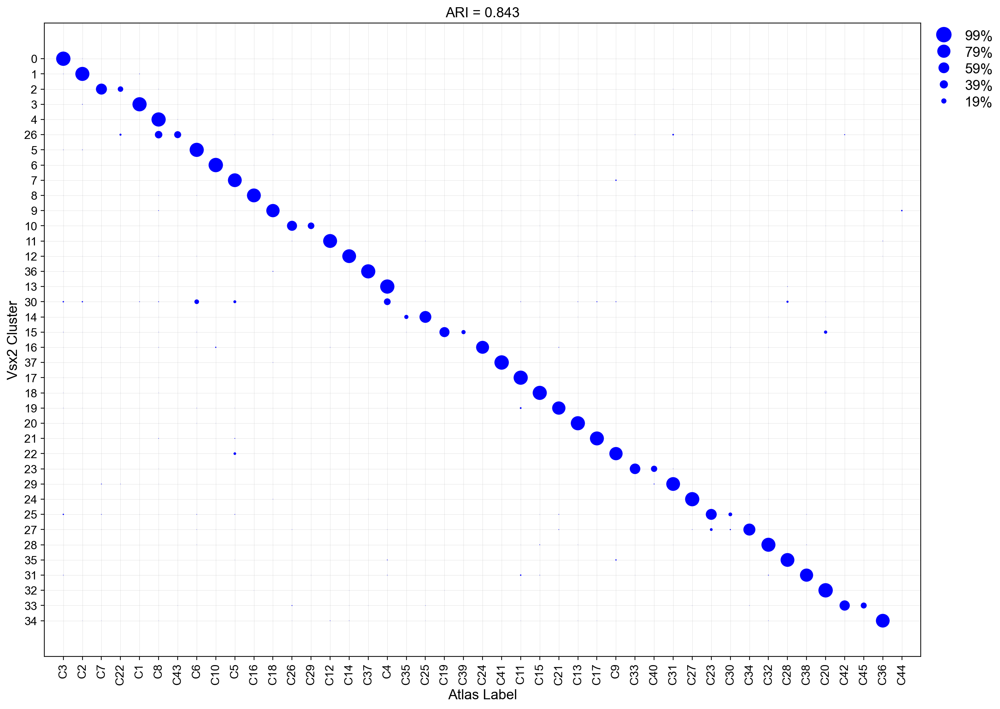

In [1010]:
vsx2_cols = [ 'C3', 'C2',  'C7', 'C22','C1', 
             'C8','C43','C6', 'C10', 'C5',  'C16',
             'C18','C26', 'C29',
              'C12','C14','C37', 'C4',  'C35', 
              'C25', 
              'C19','C39','C24', 'C41','C11', 
              'C15', 'C21','C13',
      'C17',  'C9',  'C33', 'C40','C31',
           'C27',   'C23',  'C30', 'C34',
             'C32', 'C28', 'C38',
             'C20', 'C42','C45','C36', 
              'C44',]

vsx2_rows =  ['0', '1', '2', '3', '4', '26', '5', '6', '7', '8', '9', '10', '11', '12','36', 
              '13', '30', '14', '15', '16',  '37', '17',  '18', '19', '20', '21', '22', '23', '29', '24', '25', 
              '27', '28',  '35',
              '31', '32', '33', '34', ]

plot_mapping(test_labels=test_labels_Vsx2, 
             test_predlabels=test_predlabels_Vsx2, 
             test_dict=Vsx2_dict, 
             train_dict=atlas_dict,
              re_order=True, re_order_cols=vsx2_cols,
              re_index=True, re_order_rows=vsx2_rows,
                 xaxislabel='Atlas Label', yaxislabel='Vsx2 Cluster', 
            save_as='figures/Vsx2_atlas_mapping.pdf')

In [1011]:
Vsx2.obs['Prob'] = np.max(test_prediction_Vsx2, axis=1)
Vsx2.obs['Atlas Label'] = encode_dict(atlas_dict, test_predlabels_Vsx2)

... storing 'Atlas Label' as categorical


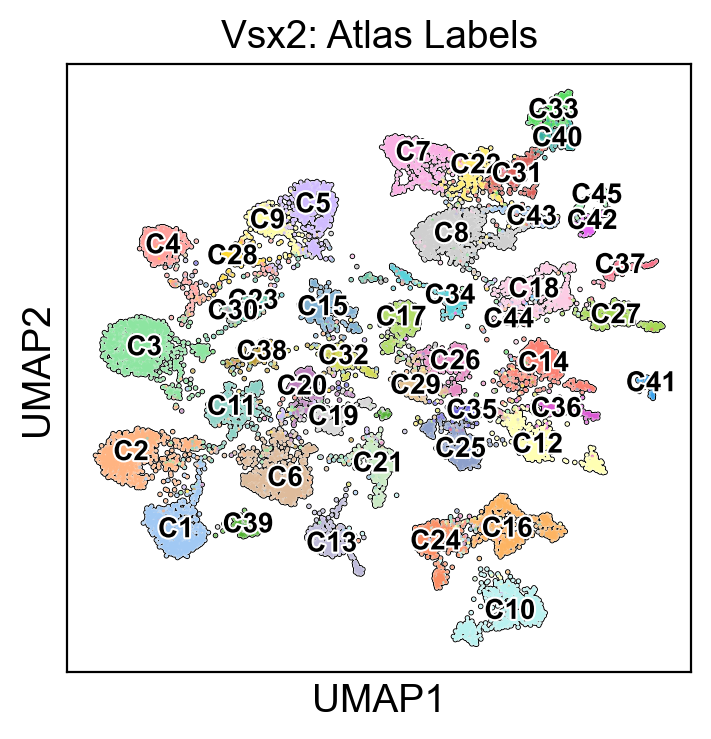

In [1012]:
sc.pl.umap(Vsx2, color=['Atlas Label'], title='Vsx2: Atlas Labels',
           legend_fontoutline=1.5, legend_fontsize=10, legend_loc='on data', palette=type_cols,
          add_outline=True, save='_Vsx2_type.pdf')

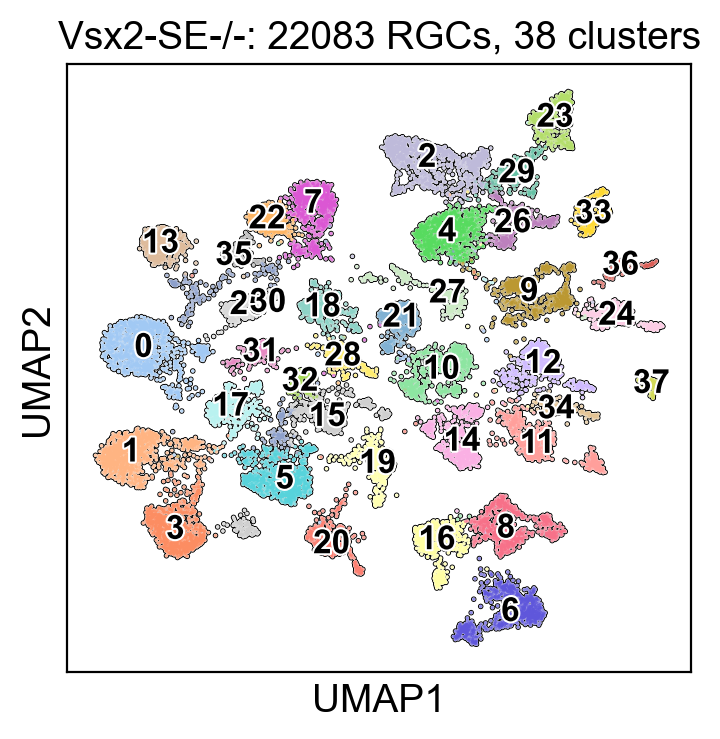

In [1013]:
sc.pl.umap(Vsx2, color=['leiden_new'], title='Vsx2-SE-/-: '+ str(Vsx2.shape[0])+ ' RGCs, ' + str(len(Vsx2.obs.leiden_new.values.categories)) + ' clusters',
           legend_fontoutline=1.5, legend_fontsize=12, legend_loc='on data', palette=type_cols,
          add_outline=True,  save='_Vsx2_leiden.pdf')

## Group analyses

In [526]:
atlas_sub = atlas.copy()
sc.pp.subsample(atlas_sub, n_obs=20000)

In [527]:
atlas_sub

AnnData object with n_obs × n_vars = 20000 × 18222
    obs: 'Type', 'Batch', 'Type_num', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden', 'Sil'
    var: 'highly_variable', 'mean', 'std', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Type_num_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'umap'
    obsm: 'R_tsne', 'X_harmony', 'X_pca', 'X_umap', 'X_harmony_z'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

In [175]:
atlas_sil_gr = silhouette_samples(X=atlas.obsm['X_harmony'][:,0:40], labels=atlas.obs.Type_num)
#atlas_sil_gr_sub = silhouette_samples(X=atlas_sub.obsm['X_harmony'][:,0:40], labels=atlas_sub.obs.Type_num)
dr_sil_gr = silhouette_samples(X=dr_corr.obsm['X_harmony'][:,0:40], labels=dr_corr.obs['Atlas Label'])
rd1_sil_gr = silhouette_samples(X=rd1.obsm['X_harmony'][:,0:40], labels=rd1.obs['Atlas Label'])
vsx2_sil_gr = silhouette_samples(X=Vsx2.obsm['X_harmony'][:,0:40], labels=Vsx2.obs['Atlas Label'])

In [176]:
atlas.obs['Sil'] = atlas_sil_gr
dr_corr.obs['Sil'] = dr_sil_gr
rd1.obs['Sil'] = rd1_sil_gr
Vsx2.obs['Sil'] = vsx2_sil_gr

In [458]:
atlas.obs.Type_num.values.categories

Index(['C10', 'C11', 'C12', 'C13', 'C14', 'C15', 'C16', 'C17', 'C18', 'C19',
       'C1', 'C20', 'C21', 'C22', 'C23', 'C24', 'C25', 'C26', 'C27', 'C28',
       'C29', 'C2', 'C30', 'C31', 'C32', 'C33', 'C34', 'C35', 'C36', 'C37',
       'C38', 'C39', 'C3', 'C40', 'C41', 'C42', 'C43', 'C44', 'C45', 'C4',
       'C5', 'C6', 'C7', 'C8', 'C9'],
      dtype='object')

In [1019]:
atlas_type_sils = clust_obs(atlas, obs_id='Sil', obs_id_split='Type_num')
dr_type_sils = clust_obs(dr_corr, obs_id='Sil', obs_id_split='Atlas Label')
rd1_type_sils = clust_obs(rd1, obs_id='Sil', obs_id_split='Atlas Label')
vsx2_type_sils = clust_obs(Vsx2, obs_id='Sil', obs_id_split='Atlas Label')

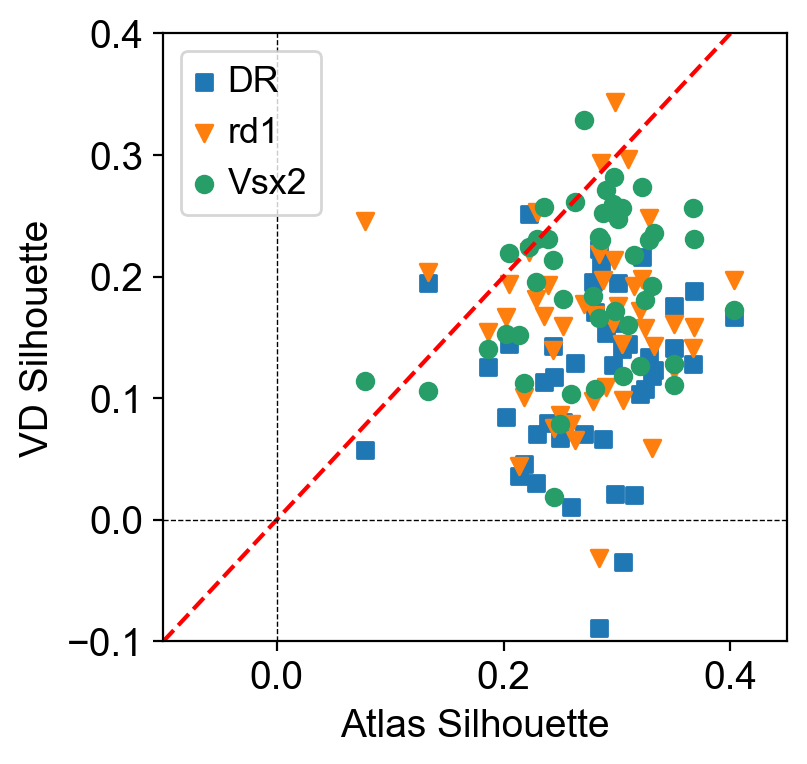

In [1028]:
plt.scatter(atlas_type_sils, dr_type_sils, label='DR', marker='s')
plt.scatter(atlas_type_sils, rd1_type_sils, label='rd1', marker='v')
plt.scatter(atlas_type_sils, vsx2_type_sils, label='Vsx2')
plt.plot(np.linspace(-0.1,0.4), np.linspace(-0.1,0.4), ls='--', color='red')
plt.axhline(0, ls='--', color='black', linewidth=0.5)
plt.axvline(0, ls='--', color='black', linewidth=0.5)


plt.legend()
plt.grid(False)
plt.xlim([-0.1,0.45])
plt.ylim([-0.1,0.4])
plt.xlabel('Atlas Silhouette')
plt.ylabel('VD Silhouette')
plt.savefig('figures/VD_vs_atlas_sil.pdf')

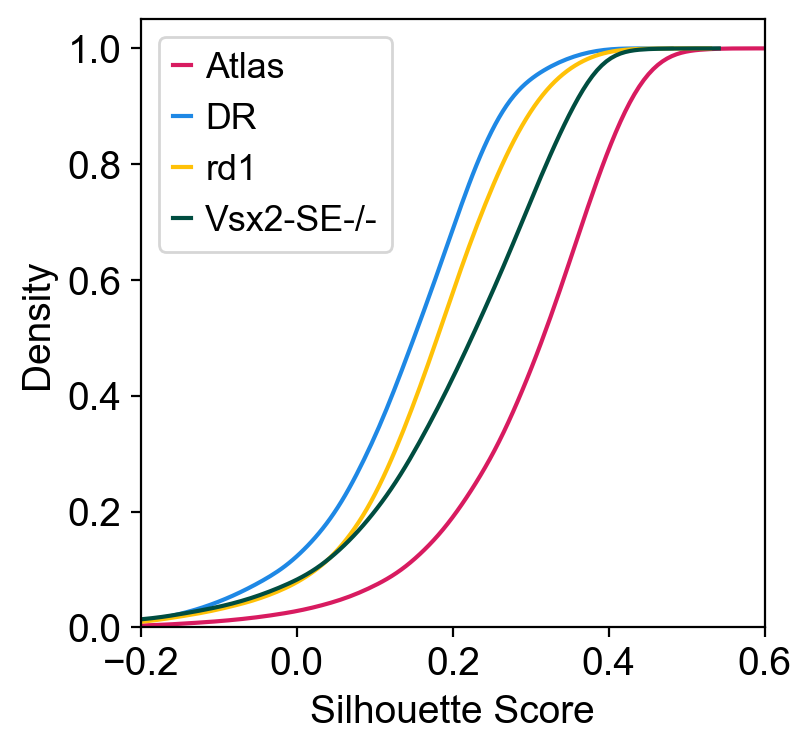

In [1031]:
sn.kdeplot(atlas_sil_gr, label='Atlas',color='#D81B60', cumulative=True,)
sn.kdeplot(dr_sil_gr, label='DR', color='#1E88E5', cumulative=True,)
sn.kdeplot(rd1_sil_gr, label='rd1',color='#FFC107', cumulative=True,)
sn.kdeplot(vsx2_sil_gr, label='Vsx2-SE-/-', color='#004D40', cumulative=True,)

# sn.kdeplot(atlas_b1_sil, label='Batch1', color=type_cols[20], cumulative=True)
# sn.kdeplot(atlas_b2_sil, label='Batch2', color=type_cols[21], cumulative=True)
# sn.kdeplot(atlas_b3_sil, label='Batch3', color=type_cols[22], cumulative=True)


plt.legend()
plt.xlabel('Silhouette Score')
plt.xlim([-0.2,0.6])
plt.grid(False)
plt.savefig('figures/cdf_sil.pdf')

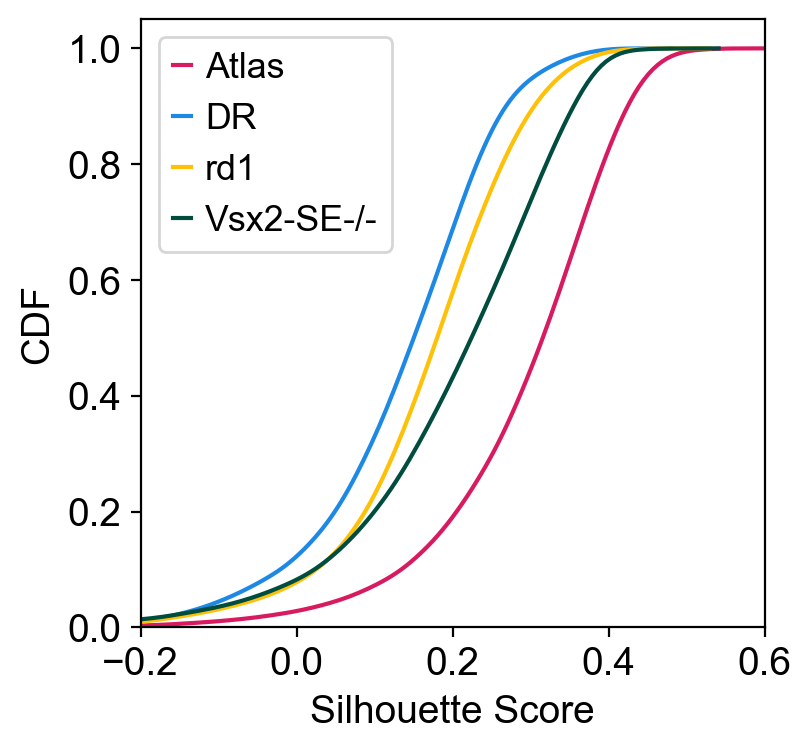

In [177]:
sn.kdeplot(atlas_sil_gr, label='Atlas',color='#D81B60', cumulative=True,)
sn.kdeplot(dr_sil_gr, label='DR', color='#1E88E5', cumulative=True,)
sn.kdeplot(rd1_sil_gr, label='rd1',color='#FFC107', cumulative=True,)
sn.kdeplot(vsx2_sil_gr, label='Vsx2-SE-/-', color='#004D40', cumulative=True,)

# sn.kdeplot(atlas_b1_sil, label='Batch1', color=type_cols[20], cumulative=True)
# sn.kdeplot(atlas_b2_sil, label='Batch2', color=type_cols[21], cumulative=True)
# sn.kdeplot(atlas_b3_sil, label='Batch3', color=type_cols[22], cumulative=True)

plt.ylabel('CDF')
plt.legend()
plt.xlabel('Silhouette Score')
plt.xlim([-0.2,0.6])
plt.grid(False)
plt.savefig('figures/cdf_sil.pdf')

In [24]:
sp.stats.ks_2samp(atlas_sil_gr, dr_sil_gr), sp.stats.ks_2samp(atlas_sil_gr, rd1_sil_gr), sp.stats.ks_2samp(atlas_sil_gr, vsx2_sil_gr)

(KstestResult(statistic=0.5246526645612835, pvalue=0.0),
 KstestResult(statistic=0.41901702407893254, pvalue=0.0),
 KstestResult(statistic=0.21346120317370215, pvalue=0.0))

In [26]:
sp.stats.ks_2samp(atlas_sil_gr, dr_sil_gr)

0.0

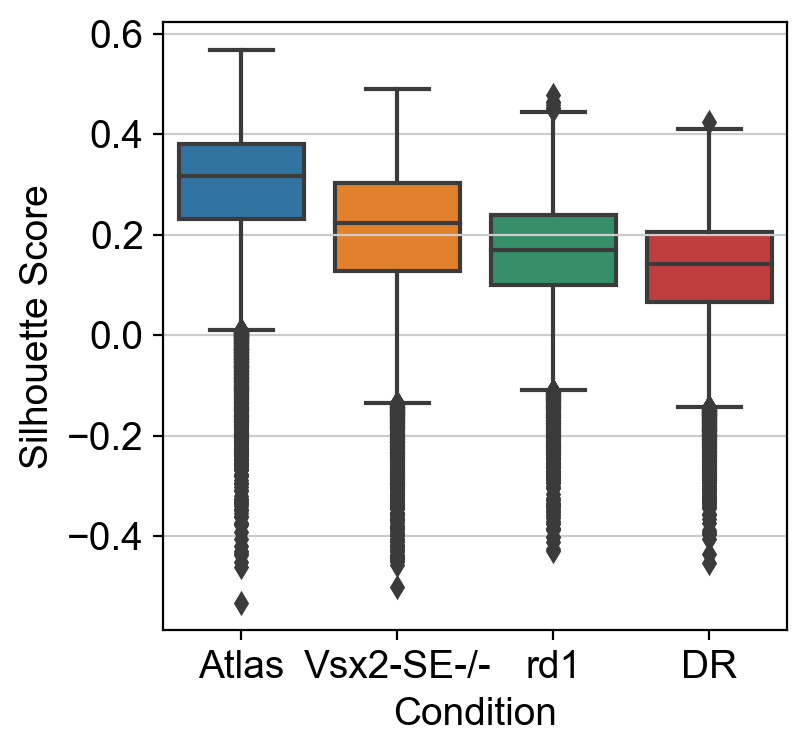

In [426]:
df_sil = pd.DataFrame({'Silhouette Score':np.concatenate([atlas_sil_gr, vsx2_sil_gr, rd1_sil_gr, dr_sil_gr,]), 
              'Condition':['Atlas']*atlas.shape[0] + ['Vsx2-SE-/-']*Vsx2.shape[0] + ['rd1']*rd1.shape[0] + ['DR']*dr_corr.shape[0]})

# Usual boxplot
ax = sn.boxplot(x='Condition', y='Silhouette Score', data=df_sil)
#ax = sn.swarmplot(x='Condition', y='Silhouette Score', data=df_sil, color="black",s=3)
plt.show()

Text(0.5, 0, 'Freq in VD/Freq in Atlas')

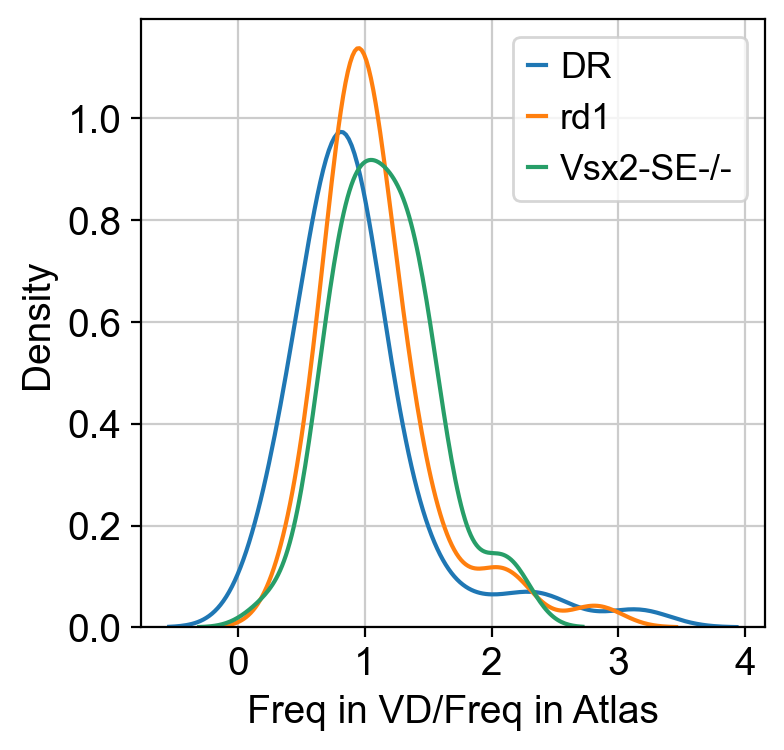

In [335]:
sn.distplot(dr_freq_ratio, hist=False, label='DR')
sn.distplot(rd1_freq_ratio, hist=False, label='rd1')
sn.distplot(Vsx2_freq_ratio, hist=False, label='Vsx2-SE-/-')
plt.legend()
plt.xlabel('Freq in VD/Freq in Atlas')

In [338]:
np.log(np.max(test_prediction_dr, axis=1))

array([-0.2379834 , -0.00527891, -0.3582577 , ..., -0.05900026,
       -0.05093857, -0.00297416], dtype=float32)

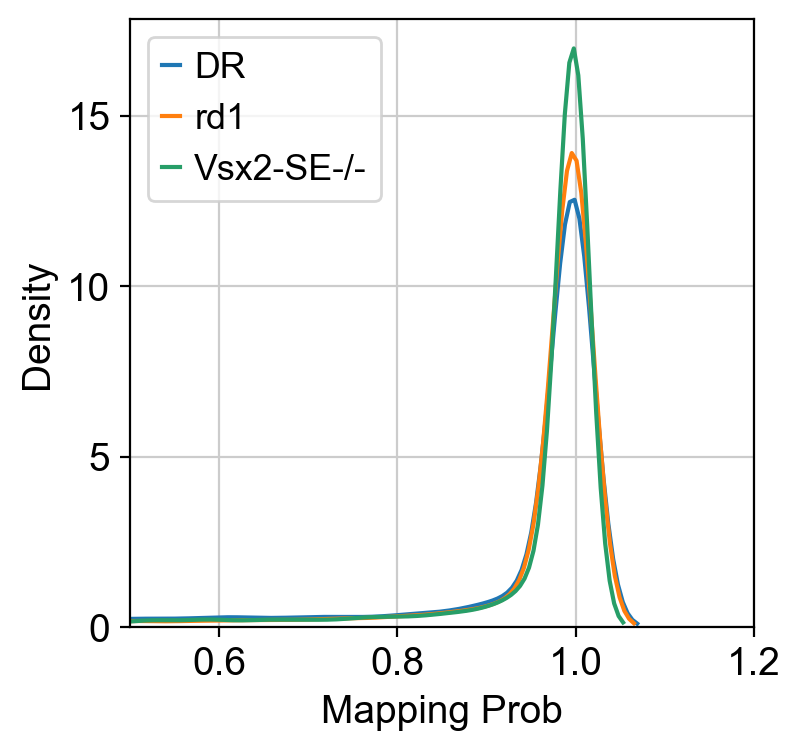

In [344]:
sn.distplot(np.max(test_prediction_dr, axis=1), hist=False, label='DR')
sn.distplot(np.max(test_prediction_rd1, axis=1), hist=False, label='rd1')
sn.distplot(np.max(test_prediction_Vsx2, axis=1), hist=False, label='Vsx2-SE-/-')
plt.xlim([0.5,1.2])
plt.xlabel('Mapping Prob')
plt.legend()

# Figure 4 bar plot

In [2]:
import numpy as np
np.array([2,17,32,41,118,200])/np.array([10,12,19, 27, 38, 45])

array([0.2       , 1.41666667, 1.68421053, 1.51851852, 3.10526316,
       4.44444444])

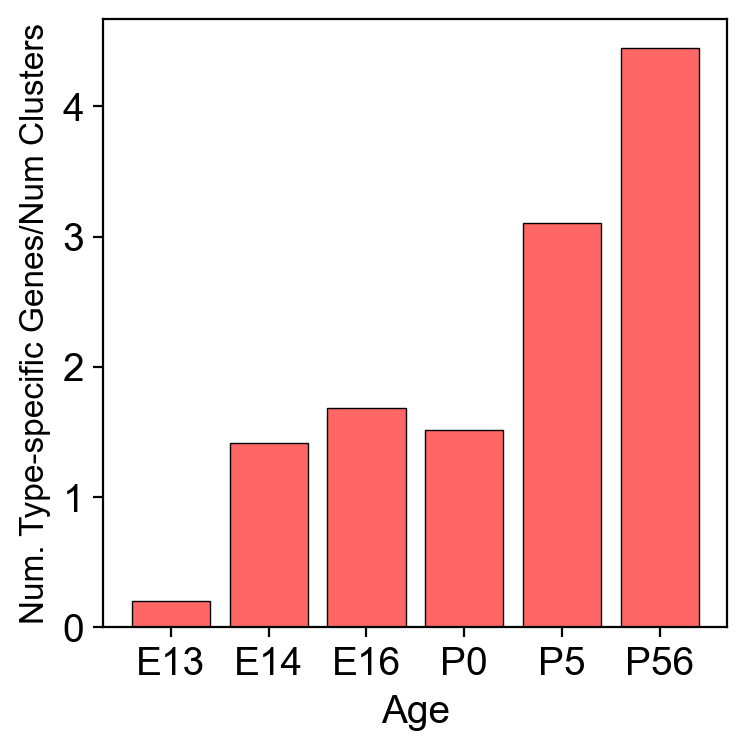

In [252]:
plt.bar(['E13', 'E14', 'E16', 'P0', 'P5', 'P56'], 
        [0.200000, 1.416667, 1.684211, 1.518519, 3.105263, 4.444444], color='#FF6666',
       edgecolor='black', linewidth=0.5)
plt.grid(False)
plt.ylabel('Num. Type-specific Genes/Num. Clusters', fontsize=12)
plt.xlabel('Age')
plt.savefig('figures/num_type-specific.pdf')

# Repeat DE analysis on subsample

In [522]:
dr_dfs_s = []
for i in dr_corr.obs['Atlas Label'].values.categories:
    dr_dfs_s.append(DE(dr_sub_de, obs_id='Atlas Label', obs_id_test=i, ref='rest', pts_thresh=0.2))
print('1')

rd1_dfs_s = []
for i in dr_corr.obs['Atlas Label'].values.categories:
    rd1_dfs_s.append(DE(rd1_sub_de, obs_id='Atlas Label', obs_id_test=i, ref='rest', pts_thresh=0.2))
print('2')

vsx2_dfs_s = []
for i in dr_corr.obs['Atlas Label'].values.categories:
    vsx2_dfs_s.append(DE(Vsx2_sub_de, obs_id='Atlas Label', obs_id_test=i, ref='rest', pts_thresh=0.2))
print('3')

atlas_dfs_s = []
for i in dr_corr.obs['Atlas Label'].values.categories:
    atlas_dfs_s.append(DE(atlas_sub_de, obs_id='Type_num', obs_id_test=i, ref='rest', pts_thresh=0.2))
print('4')


86 87
135 138
99 100
141 153
124 134
cutoffs are good at 1.5 FC level
295 346
281 288
139 160
cutoffs are good at 1.5 FC level
312 354
334 349
186 206
203 230
165 192
653 771
153 181
375 412
132 174
257 299
140 244
244 372
146 240
642 823
735 767
970 1049
1201 1325
154 302
135 208
49 260
701 1191
329 685
482 888
264 1530
84 200
113 773
356 1034
73 292
151 1293
476 1325
202 1239
134 1754
124 2088
50 659


Trying to set attribute `._uns` of view, copying.


0 2547
1
75 80
cutoffs are good at 1.5 FC level
115 116
126 134
140 145
cutoffs are good at 1.5 FC level
472 512
cutoffs are good at 1.5 FC level
187 205
cutoffs are good at 1.5 FC level
277 334
432 441
274 283
311 361
143 161
1460 1489
173 211
822 862
167 221
188 225
359 496
353 546
271 397
1563 1627
958 1089
1379 1531
1820 1970
103 229
145 205
63 377
708 1295
448 846
526 847
1031 2941
101 248
253 1391
960 2181
55 206
383 1991
618 1415
688 2168
1252 3617
1159 3865
24 360


Trying to set attribute `._uns` of view, copying.


0 2404
2
cutoffs are good at 1.5 FC level
cutoffs are good at 1.5 FC level
189 190
214 220
212 219
cutoffs are good at 1.5 FC level
310 348
317 327
201 215
1027 1028
298 348
532 540
224 247
326 368
202 224
842 870
151 178
484 508
224 290
263 315
228 290
374 530
139 203
717 765
614 676
816 880
970 1124
167 358
187 242
68 270
427 1025
344 636
588 956
180 1362
159 324
290 1157
583 1579
101 286
193 1285
497 1387
373 1304
656 2606
363 2441
108 852


Trying to set attribute `._uns` of view, copying.


18 2855
3
153 154
cutoffs are good at 1.5 FC level
cutoffs are good at 1.5 FC level
236 239
244 251
cutoffs are good at 1.5 FC level
330 370
400 409
229 246
cutoffs are good at 1.5 FC level
448 476
429 431
254 272
320 347
233 254
842 845
226 251
773 787
258 292
288 316
375 464
374 475
436 532
1174 1198
719 759
1118 1173
1699 1822
247 405
257 300
233 574
835 1295
640 907
511 832
1339 2837
153 259
329 1195
1004 1792
149 384
289 1284
455 1257
762 1860
1621 3348
770 2853
144 835
138 3674
4


In [566]:
num_dr_de_s = []
for i in dr_dfs_s:
    num_dr_de_s.append(len(i[(i['LF']>0.6) & (i['p_adj']<0.05)].index))

num_rd1_de_s = []
for i in rd1_dfs_s:
    num_rd1_de_s.append(len(i[(i['LF']>0.6) & (i['p_adj']<0.05)].index))

num_vsx2_de_s = []
for i in vsx2_dfs_s:
    num_vsx2_de_s.append(len(i[(i['LF']>0.6) & (i['p_adj']<0.05)].index))

num_atlas_de_s = []
for i in atlas_dfs_s:
    num_atlas_de_s.append(len(i[(i['LF']>0.6) & (i['p_adj']<0.05)].index))

In [574]:
num_dr_de_s = []
for i in dr_dfs_s:
    num_dr_de_s.append(len(i[(i['p_adj']<0.05)].index))

num_rd1_de_s = []
for i in rd1_dfs_s:
    num_rd1_de_s.append(len(i[(i['p_adj']<0.05)].index))

num_vsx2_de_s = []
for i in vsx2_dfs_s:
    num_vsx2_de_s.append(len(i[(i['p_adj']<0.05)].index))

num_atlas_de_s = []
for i in atlas_dfs_s:
    num_atlas_de_s.append(len(i[(i['p_adj']<0.05)].index))

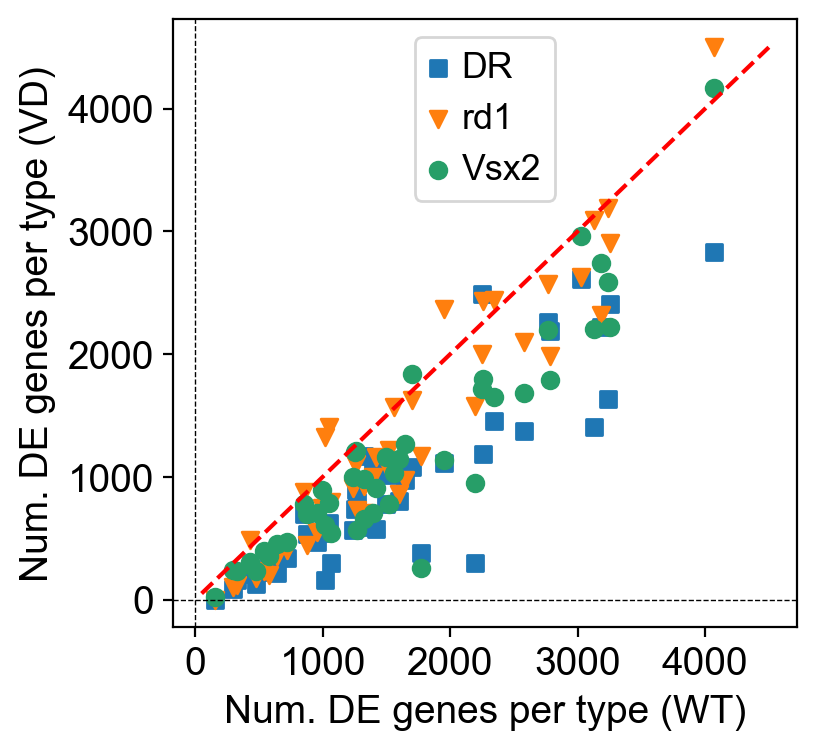

In [1044]:
plt.scatter(np.array(num_atlas_de_s)[idx], np.array(num_dr_de_s)[idx], label='DR', marker='s')
plt.scatter(np.array(num_atlas_de_s)[idx], np.array(num_rd1_de_s)[idx], label='rd1', marker='v')
plt.scatter(np.array(num_atlas_de_s)[idx], np.array(num_vsx2_de_s)[idx], label='Vsx2')
plt.legend()
plt.plot(np.linspace(50,4500), np.linspace(50,4500), ls='--', color='red')
#plt.xscale('log')
#plt.yscale('log')
plt.xlabel('Num. DE genes per type (WT)')
plt.ylabel('Num. DE genes per type (VD)')
plt.axhline(0, ls='--', color='black', linewidth=0.5)
plt.axvline(0, ls='--', color='black', linewidth=0.5)
plt.grid(False)
plt.savefig('figures/NumDEgenes_scatter.pdf',  bbox_inches='tight')
#plt.xlim([0,1000])

# Exp of TFs

## Subclass TFs

In [8]:
anc = sc.read_mtx('ancestral/anc_counts.mtx')

In [9]:
anc.var_names = pd.read_csv('ancestral/anc_genes.csv')['x'].values
obs_df = pd.read_csv('ancestral/anc_obs_df.csv')
obs_df.index = obs_df['Unnamed: 0'].values
del obs_df['Unnamed: 0']
anc.obs = obs_df

In [13]:
#sc.pl.dotplot(anc, 'Mdga1', groupby='clust')

In [11]:
anc_e13 = anc[anc.obs['age']=='E13',:]
anc_e14 = anc[anc.obs['age']=='E14',:]
anc_e16 = anc[anc.obs['age']=='E16',:]
anc_p0 = anc[anc.obs['age']=='P0',:]
anc_p5 = anc[anc.obs['age']=='P5',:]
anc_p56 = anc[anc.obs['age']=='P56',:]

In [129]:
tfs = ['Neurod2', 'Eomes', 'Irx3', 'Foxp2', 'Tbr1', 'Tfap2d', 'Mafb', 'Bnc2', 'Satb2', 'Satb1']

In [130]:
def calc_pt(anc_obj, TF):
    p_t = []
    e_t = []
    gene_idx = anc_obj.var_names.get_loc(TF)
    for i in anc_obj.obs.clust.values.categories:
        clust_obj = anc_obj[anc_obj.obs['clust']==i,:]
        gene_vec = clust_obj.X[:, gene_idx]
        p = np.nonzero(gene_vec)[0].shape[0]/anc_obj.shape[0]
        e = np.mean(gene_vec)
        
        if (p>0):
            p_t.append(p)
            e_t.append(e)
    
    if(len(p_t)>0):
        p_t = np.array(p_t)/np.max(np.array(p_t))
        pt_cv = np.var(p_t)/np.mean(p_t)

        e_t = np.array(e_t)/np.max(np.array(e_t))
        et_cv = np.var(e_t)/np.mean(e_t)

        return pt_cv, et_cv
    else:
        return 0,0
    #return np.array(p_t)

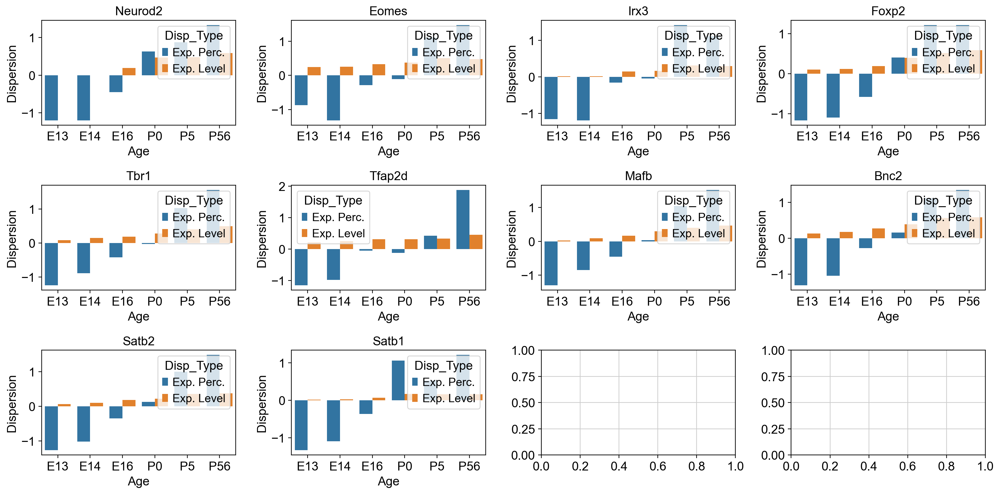

In [131]:
fig, axs = plt.subplots(3,4, figsize=(16,8))
a = 0
b = 0
p_dfs = []
for tf_ in tfs:
    neurod2_p = []
    neurod2_e = []

    for i in [anc_e13, anc_e14, anc_e16, anc_p0, anc_p5, anc_p56]:
        yo = calc_pt(i,tf_)
        neurod2_p.append(yo[0])
        neurod2_e.append(yo[1])

    p_df = pd.concat([pd.DataFrame(sp.stats.zscore(neurod2_p) , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Perc.'], columns=['Disp_Type']),
                pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age']),
                     pd.DataFrame(6*[tf_], columns=['TF'])], axis=1)
    p_dfs.append(p_df)
    e_df = pd.concat([pd.DataFrame(neurod2_e , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Level'], columns=['Disp_Type']), 
                     pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age'])], axis=1)
    sn.barplot(x='Age', y='Dispersion', hue='Disp_Type',data=pd.concat([p_df, e_df], axis=0), 
               ax=axs[a,b])
    
    axs[a,b].grid(False)
    axs[a,b].set_title(tf_)

    if (b>2):
        b = 0
        a = a + 1
    else:
        b = b + 1
#     plt.title(tf_)
#     plt.show()
    
#     fig, axs = plt.subplots(1,2, figsize=(8,4))
#     axs[0].bar(anc.obs.age.values.categories, neurod2_p)
#     axs[0].grid(False)
#     axs[0].set_title(tf_)
#     axs[0].set_ylabel('% Expressed Dispersion')
    
#     axs[1].bar(anc.obs.age.values.categories, neurod2_e)
#     axs[1].grid(False)
#     axs[1].set_title(tf_)
#     axs[1].set_ylabel('Expression Dispersion')
plt.tight_layout()

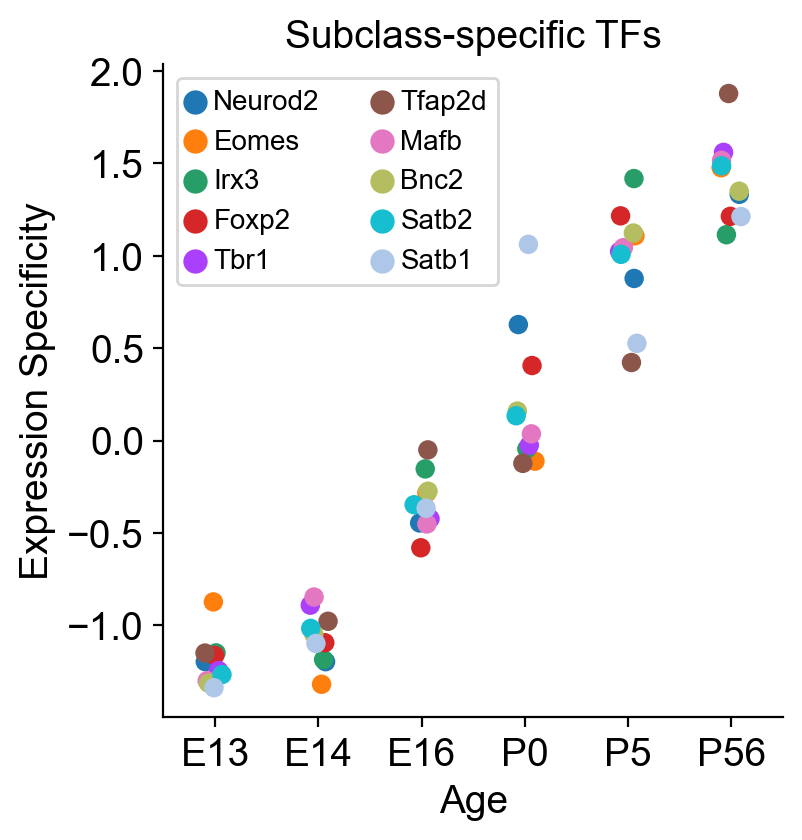

In [132]:
sn.catplot(x="Age", y="Dispersion", hue="TF", data=pd.concat(p_dfs, axis=0), 
           legend_out=False, s=7,  height=4,aspect=1)
#plt.ylabel('Scaled Dispersion of Expression \n Frequency Across Clusters', fontsize=12)
plt.ylabel('Expression Specificity')

plt.grid(False)
plt.legend(fontsize=10, ncol=2,)
plt.title('Subclass-specific TFs')
plt.savefig('figures/disp_subclassTFs.pdf', bbox_inches='tight')



In [137]:
irx3_13 = calc_pt(anc_e13, 'Irx3')[0]
irx3_56 = calc_pt(anc_p56, 'Irx3')[0]

In [161]:
anc.obs.age.values.categories

Index(['E13', 'E14', 'E16', 'P0', 'P5', 'P56'], dtype='object')

In [140]:
np.var(irx3_13)/np.mean(irx3_13), np.var(irx3_56)/np.mean(irx3_56)

(0.013972927131851779, 0.26658620079925505)

In [143]:
tfs = ['Neurod2', 'Eomes', 'Irx3', 'Foxp2', 'Tbr1', 'Tfap2d', 'Mafb', 'Bnc2', 'Satb2', 'Satb1']

In [144]:
vars_plot = ['Eomes E13', 'Eomes E14', 'Eomes E16', 'Eomes P0', 'Eomes P5','Eomes P56',
             'Tfap2d E13', 'Tfap2d E14', 'Tfap2d E16', 'Tfap2d P0', 'Tfap2d P5', 'Tfap2d P56',
             'Bnc2 E13', 'Bnc2 E14', 'Bnc2 E16', 'Bnc2 P0', 'Bnc2 P5', 'Bnc2 P56', 
             'Mafb E13', 'Mafb E14', 'Mafb E16', 'Mafb P0', 'Mafb P5', 'Mafb P56',
             'Foxp2 E13', 'Foxp2 E14', 'Foxp2 E16', 'Foxp2 P0', 'Foxp2 P5', 'Foxp2 P56', 
             'Irx3 E13', 'Irx3 E14', 'Irx3 E16', 'Irx3 P0', 'Irx3 P5', 'Irx3 P56',
             'Tbr1 E13', 'Tbr1 E14', 'Tbr1 E16', 'Tbr1 P0', 'Tbr1 P5', 'Tbr1 P56',
             'Neurod2 E13', 'Neurod2 E14', 'Neurod2 E16', 'Neurod2 P0', 'Neurod2 P5', 'Neurod2 P56',
             'Satb2 E13', 'Satb2 E14', 'Satb2 E16', 'Satb2 P0', 'Satb2 P5', 'Satb2 P56',
            'Satb1 E13', 'Satb1 E14', 'Satb1 E16', 'Satb1 P0', 'Satb1 P5', 'Satb1 P56',]   

/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'age' as categorical
/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'clust_age' as categorical


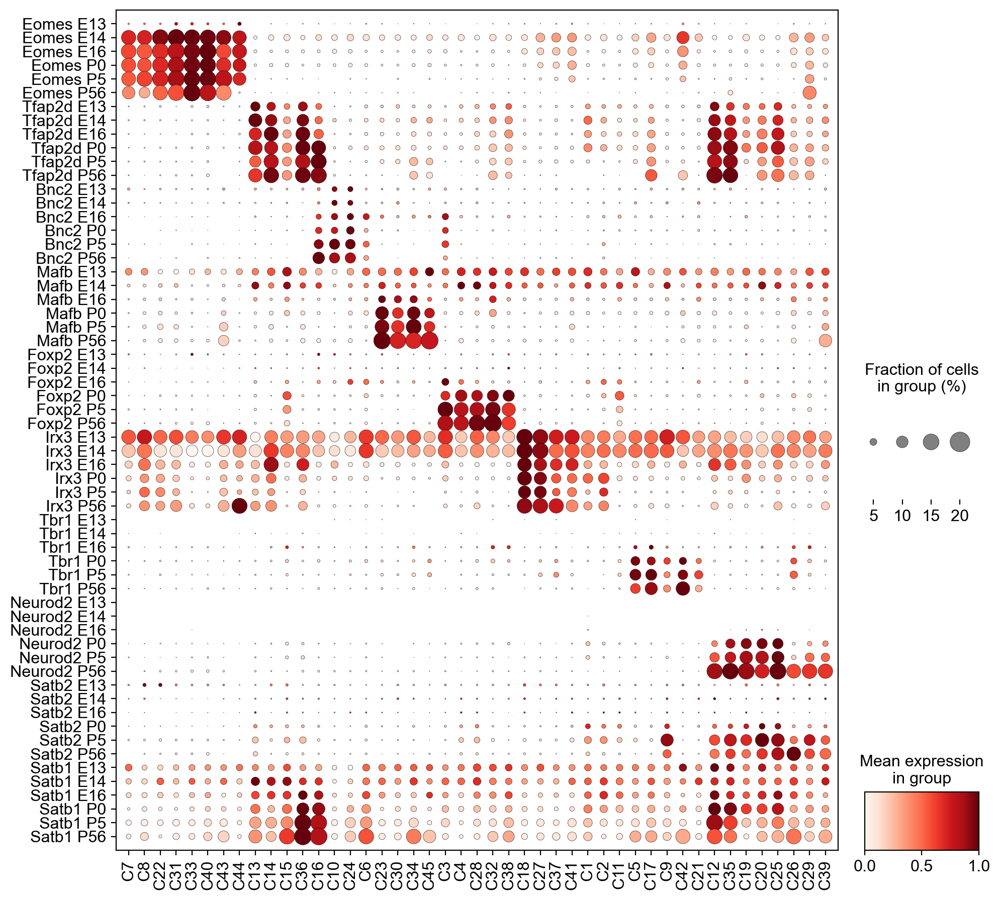

In [145]:
sub_order = ['C7', 'C8', 'C22', 'C31',  'C33', 'C40', 'C43', 'C44', 
               'C13', 'C14', 'C15',   'C36',
              'C16','C10', 'C24','C6',
             'C23', 'C30',  'C34', 'C45',
             'C3', 'C4', 'C28', 'C32', 'C38',
              'C18','C27','C37', 'C41','C1', 'C2', 'C11',
             'C5', 'C17', 'C9','C42',  'C21','C12','C35',
      'C19', 'C20',  'C25', 'C26',  'C29', 'C39', ]

e13_neurod = anc_e13[:, tfs]
e14_neurod = anc_e14[:, tfs]
e16_neurod = anc_e16[:, tfs]
p0_neurod = anc_p0[:, tfs]
p5_neurod = anc_p5[:, tfs]
p56_neurod = anc_p56[:, tfs]

e13_neurod.var.index = [s + ' E13' for s in tfs]
e14_neurod.var.index = [s + ' E14' for s in tfs]
e16_neurod.var.index = [s + ' E16' for s in tfs]
p0_neurod.var.index = [s + ' P0' for s in tfs]
p5_neurod.var.index = [s + ' P5' for s in tfs]
p56_neurod.var.index = [s + ' P56' for s in tfs]

a = e13_neurod.concatenate(e14_neurod, e16_neurod, p0_neurod, p5_neurod, 
                           p56_neurod, join='outer')

sc.pl.dotplot(a, var_names=vars_plot, groupby='clust', swap_axes=True, standard_scale='var',
              categories_order = sub_order,
             figsize=(11,11) ,)#save='_subclassTFs_temp.pdf')

## Type TFs

In [349]:
tfs_E14 = ['Nhlh1', 'E2f1', 'Bhlhe23', 'Lef1', 'Bnc2', 'Gfi1', 'Runx1', 'Pou4f3']
tfs_E16 = ['Esrrg', 'Rhox2a', 'Foxo1', 'Bnc2', 'Wnt4', 'Crym', 'Ascl1', 'Irx1', 'Runx1']

In [355]:
set(tfs_E14).intersection(set(tfs_E16))

{'Bnc2', 'Runx1'}

/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'age' as categorical
/Users/salwanbutrus/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'clust_age' as categorical


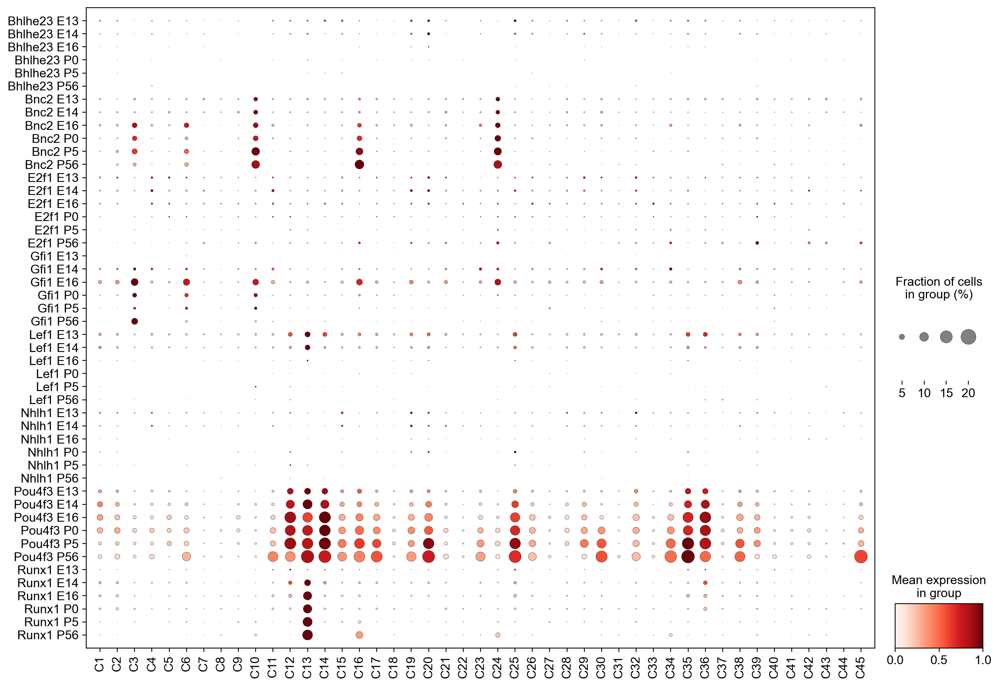

In [429]:
e13_neurod = anc_e13[:, tfs_E14]
e14_neurod = anc_e14[:, tfs_E14]
e16_neurod = anc_e16[:, tfs_E14]
p0_neurod = anc_p0[:, tfs_E14]
p5_neurod = anc_p5[:, tfs_E14]
p56_neurod = anc_p56[:, tfs_E14]

e13_neurod.var.index = [s + ' E13' for s in tfs_E14]
e14_neurod.var.index = [s + ' E14' for s in tfs_E14]
e16_neurod.var.index = [s + ' E16' for s in tfs_E14]
p0_neurod.var.index = [s + ' P0' for s in tfs_E14]
p5_neurod.var.index = [s + ' P5' for s in tfs_E14]
p56_neurod.var.index = [s + ' P56' for s in tfs_E14]

a = e13_neurod.concatenate(e14_neurod, e16_neurod, p0_neurod, p5_neurod, 
                           p56_neurod, join='outer')

sc.pl.dotplot(a, var_names=a.var_names, groupby='clust', swap_axes=True, standard_scale='var',
             figsize=(15,11) , save='_TypeSpecific_E14_temp.pdf')

## Read in type-specific genes at each time

In [11]:
ts_genes = []
for i in np.arange(1,7).astype('str'):

    ts_genes.append(list(pd.read_csv('ancestral/gs' + i + '.csv')['x'].values))

In [12]:
tfs_all = list(pd.read_excel('tf_final.xlsx')['gene'].values)

In [13]:
ts_tfs_master = []

for i in ts_genes:
    ts_tfs_master = ts_tfs_master + list(set(tfs_all).intersection(set(i)))

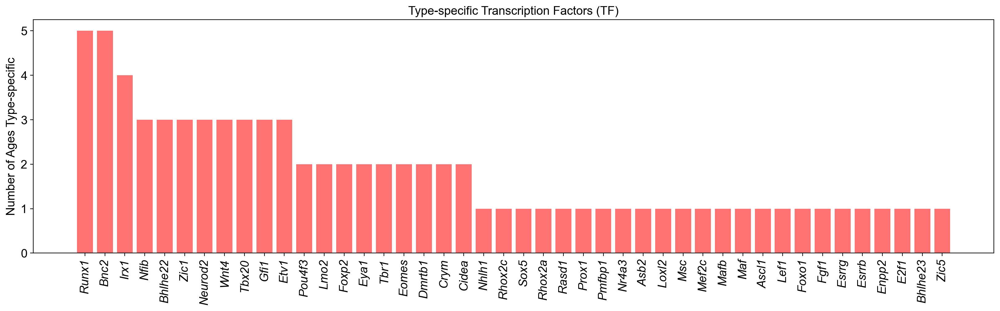

In [32]:
plt.figure(figsize=(20,5))
plt.bar(pd.Categorical(ts_tfs_master).value_counts().sort_values(ascending=False).index, 
        pd.Categorical(ts_tfs_master).value_counts().sort_values(ascending=False).values,
       color = '#FF7272')
plt.xticks(rotation=90, fontstyle='italic')
plt.yticks(rotation=0)
plt.grid(False)
plt.title('Type-specific Transcription Factors (TF)')
plt.ylabel('Number of Ages Type-specific')
#plt.savefig('figures/TS_TFs_numAges.pdf', bbox_inches='tight')
plt.show()

In [610]:
pd.Categorical(ts_tfs_master).value_counts().sort_values(ascending=False).index

CategoricalIndex(['Runx1', 'Bnc2', 'Irx1', 'Nfib', 'Bhlhe22', 'Zic1',
                  'Neurod2', 'Wnt4', 'Tbx20', 'Gfi1', 'Etv1', 'Pou4f3', 'Lmo2',
                  'Foxp2', 'Eya1', 'Tbr1', 'Eomes', 'Dmrtb1', 'Crym', 'Cidea',
                  'Nhlh1', 'Rhox2c', 'Sox5', 'Rhox2a', 'Rasd1', 'Prox1',
                  'Pmfbp1', 'Nr4a3', 'Asb2', 'Loxl2', 'Msc', 'Mef2c', 'Mafb',
                  'Maf', 'Ascl1', 'Lef1', 'Foxo1', 'Fgf1', 'Esrrg', 'Esrrb',
                  'Enpp2', 'E2f1', 'Bhlhe23', 'Zic5'],
                 categories=['Asb2', 'Ascl1', 'Bhlhe22', 'Bhlhe23', 'Bnc2', 'Cidea', 'Crym', 'Dmrtb1', ...], ordered=False, dtype='category')

In [32]:
def tf_obj(tfs, anc_list):
    
    e13_tf = anc_list[0][:, tfs]
    e14_tf = anc_list[1][:, tfs]
    e16_tf = anc_list[2][:, tfs]
    p0_tf = anc_list[3][:, tfs]
    p5_tf = anc_list[4][:, tfs]
    p56_tf = anc_list[5][:, tfs]

    e13_tf.var.index = [s + ' E13' for s in tfs]
    e14_tf.var.index = [s + ' E14' for s in tfs]
    e16_tf.var.index = [s + ' E16' for s in tfs]
    p0_tf.var.index = [s + ' P0' for s in tfs]
    p5_tf.var.index = [s + ' P5' for s in tfs]
    p56_tf.var.index = [s + ' P56' for s in tfs]

    a = e13_tf.concatenate(e14_tf, e16_tf, p0_tf, p5_tf, 
                               p56_tf, join='outer')
    
    return a 

In [81]:
vd_list = [atlas, dr_corr, rd1, Vsx2]

In [34]:
anc_list = [anc_e13, anc_e14, anc_e16, anc_p0, anc_p5, anc_p56]

In [115]:
#removed subclass TFs from below
#remove lowly exp: Bhlhe23, (sing), Pmfbp1 (sing), Zic5(sing), Rhox2c (sing),  Nhlh1 (sing), 
# Rhox2a( sing), Lef1 (sing), Ascl1 (sing), Pou4f3 (freq)
tfs_frequent = ['Runx1', 'Irx1', 'Nfib', 'Bhlhe22', 'Zic1',
                  'Gfi1','Eya1', 'Wnt4', 'Tbx20',  'Dmrtb1', 'Cidea', 'Lmo2', 'Etv1', 
                  'Crym']
tfs_single = [ 'Asb2',   'Maf',  'Loxl2','Mef2c',  'Lef1', 'Esrrb',  'Nr4a3',
              'Rasd1', 'Enpp2',
               'Foxo1',   'Msc', 'Esrrg','Fgf1',
               'Prox1',   'Sox5',]

tfs_sad = ['Bhlhe23', 'Pmfbp1', 'Zic5', 'Rhox2c',  'Nhlh1',
           'Rhox2a', 'Lef1', 'Ascl1', 'Fgf1', 'Crym' , 'Pou4f3', 'Satb1']

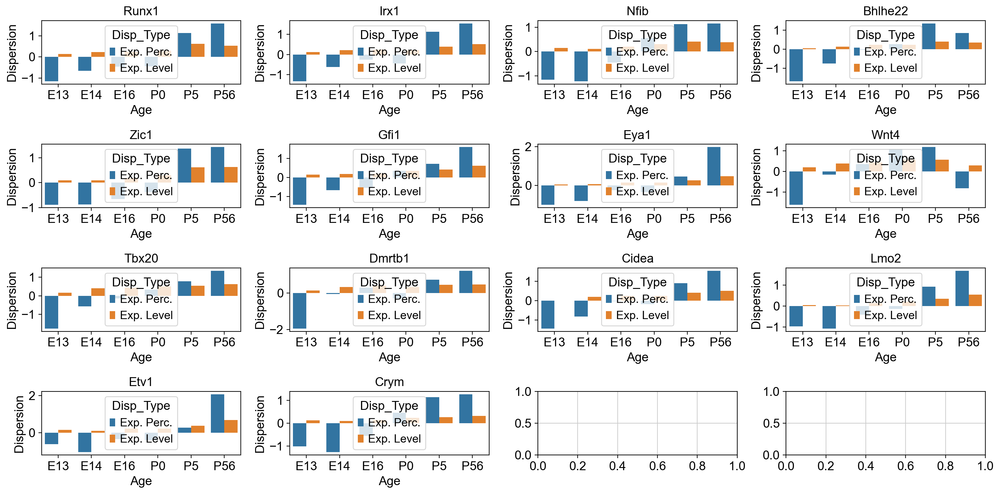

In [80]:
fig, axs = plt.subplots(4,4, figsize=(16,8))
a = 0
b = 0
p_dfs = []
for tf_ in tfs_frequent:
    neurod2_p = []
    neurod2_e = []

    for i in [anc_e13, anc_e14, anc_e16, anc_p0, anc_p5, anc_p56]:
        yo = calc_pt(i,tf_)
        neurod2_p.append(yo[0])
        neurod2_e.append(yo[1])

    p_df = pd.concat([pd.DataFrame(sp.stats.zscore(neurod2_p) , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Perc.'], columns=['Disp_Type']),
                pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age']),
                     pd.DataFrame(6*[tf_], columns=['TF'])], axis=1)
    p_dfs.append(p_df)
    e_df = pd.concat([pd.DataFrame(neurod2_e , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Level'], columns=['Disp_Type']), 
                     pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age'])], axis=1)
    sn.barplot(x='Age', y='Dispersion', hue='Disp_Type',data=pd.concat([p_df, e_df], axis=0), 
               ax=axs[a,b])
    
    axs[a,b].grid(False)
    axs[a,b].set_title(tf_)

    if (b>2):
        b = 0
        a = a + 1
    else:
        b = b + 1
#     plt.title(tf_)
#     plt.show()
    
#     fig, axs = plt.subplots(1,2, figsize=(8,4))
#     axs[0].bar(anc.obs.age.values.categories, neurod2_p)
#     axs[0].grid(False)
#     axs[0].set_title(tf_)
#     axs[0].set_ylabel('% Expressed Dispersion')
    
#     axs[1].bar(anc.obs.age.values.categories, neurod2_e)
#     axs[1].grid(False)
#     axs[1].set_title(tf_)
#     axs[1].set_ylabel('Expression Dispersion')
plt.tight_layout()

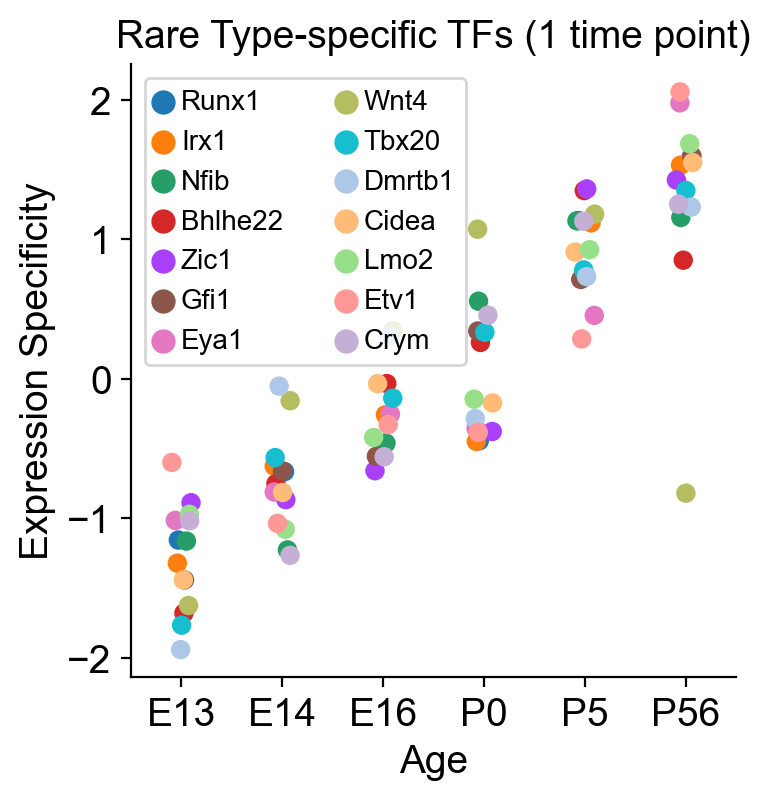

In [81]:
sn.catplot(x="Age", y="Dispersion", hue="TF", data=pd.concat(p_dfs, axis=0), 
           legend_out=False, s=7,  height=4,aspect=1)
#plt.ylabel('Scaled Dispersion of Expression \n Frequency Across Clusters', fontsize=12)
plt.ylabel('Expression Specificity')

plt.grid(False)
plt.legend(fontsize=10, ncol=2)
# plt.title('Frequent Type-specific TFs (>1 time point)')
# plt.savefig('figures/disp_TS_TFs_freq.pdf', bbox_inches='tight')
plt.title('Rare Type-specific TFs (1 time point)')
plt.savefig('figures/disp_TS_TFs_sing.pdf', bbox_inches='tight')


In [140]:
tfs_freq_obj = tf_obj(tfs = tfs_frequent, anc_list = anc_list)
tfs_sing_obj = tf_obj(tfs = tfs_single, anc_list = anc_list)
tfs_sad_obj = tf_obj(tfs = tfs_sad, anc_list = anc_list)


woo = pd.DataFrame([[s + ' E13' for s in tfs_frequent], [s + ' E14' for s in tfs_frequent], 
             [s + ' E16' for s in tfs_frequent], [s + ' P0' for s in tfs_frequent],
             [s + ' P5' for s in tfs_frequent], [s + ' P56' for s in tfs_frequent]])

tfs_freq_order = []
for i in range(woo.shape[1]):
    tfs_freq_order = tfs_freq_order + list(woo.to_numpy()[:,i]) 
    
####################

woo__ = pd.DataFrame([[s + ' E13' for s in tfs_single], [s + ' E14' for s in tfs_single], 
             [s + ' E16' for s in tfs_single], [s + ' P0' for s in tfs_single],
             [s + ' P5' for s in tfs_single], [s + ' P56' for s in tfs_single]])

tfs_sing_order = []
for i in range(woo__.shape[1]):
    tfs_sing_order = tfs_sing_order + list(woo__.to_numpy()[:,i]) 
    
#################
    
weee = pd.DataFrame([[s + ' E13' for s in tfs_sad], [s + ' E14' for s in tfs_sad], 
             [s + ' E16' for s in tfs_sad], [s + ' P0' for s in tfs_sad],
             [s + ' P5' for s in tfs_sad], [s + ' P56' for s in tfs_sad]])

tfs_sad_order = []
for i in range(weee.shape[1]):
    tfs_sad_order = tfs_sad_order + list(weee.to_numpy()[:,i]) 

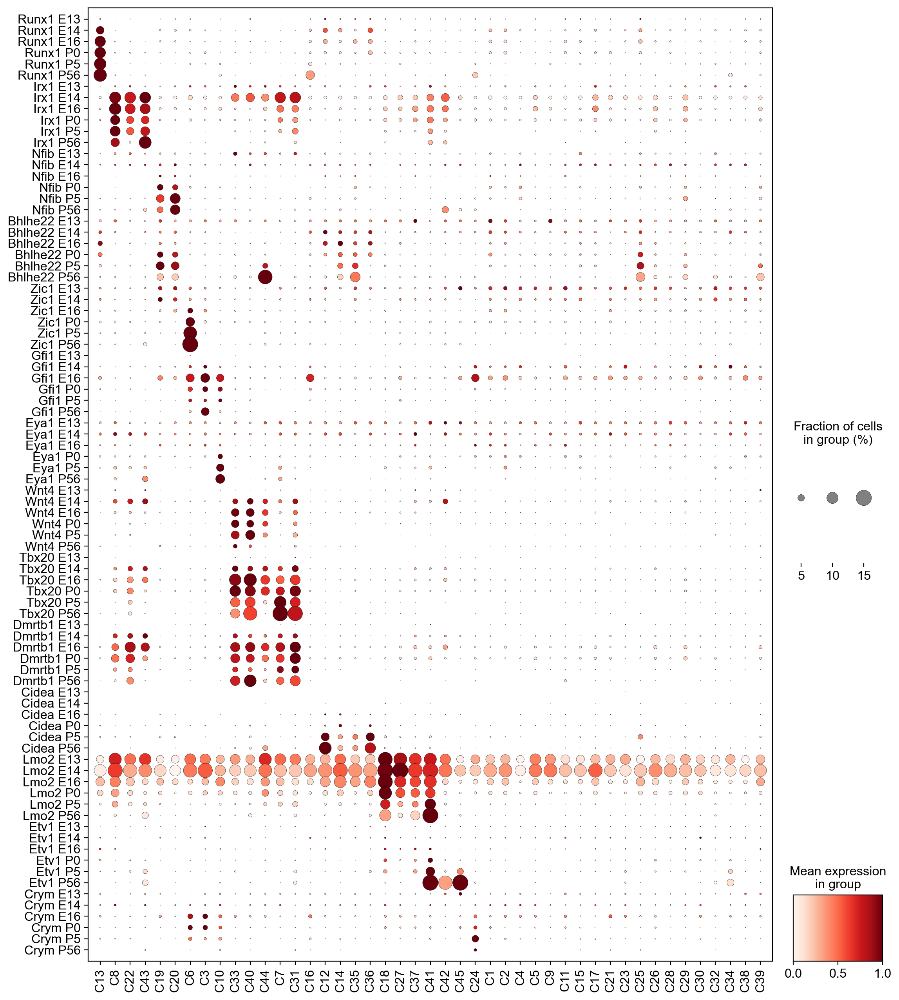

In [70]:
sc.pl.dotplot(tfs_freq_obj, tfs_freq_order, swap_axes=True, standard_scale='var', groupby='clust',
             figsize = (13,16),  categories_order = [ 'C13', 
                                  'C8', 'C22','C43', 
                                  'C19', 'C20','C6', 'C3', 'C10',
                                     'C33',  'C40',  'C44',  'C7',  'C31',         
                                        'C16',  
                                       'C12', 'C14', 'C35', 'C36',   
                                       'C18',  'C27',  'C37',   'C41',
                                            'C42',   'C45', 'C24',
                                  'C1', 'C2',  'C4', 'C5', 
                                                  'C9',  'C11',
        'C15', 'C17',  'C21',
       'C23',  'C25', 'C26',  'C28', 'C29', 'C30',
       'C32',  'C34',   'C38', 'C39', ],dot_max=0.15, save='_TS_TFs_freq.pdf')

/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'age' as categorical
/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'clust_age' as categorical


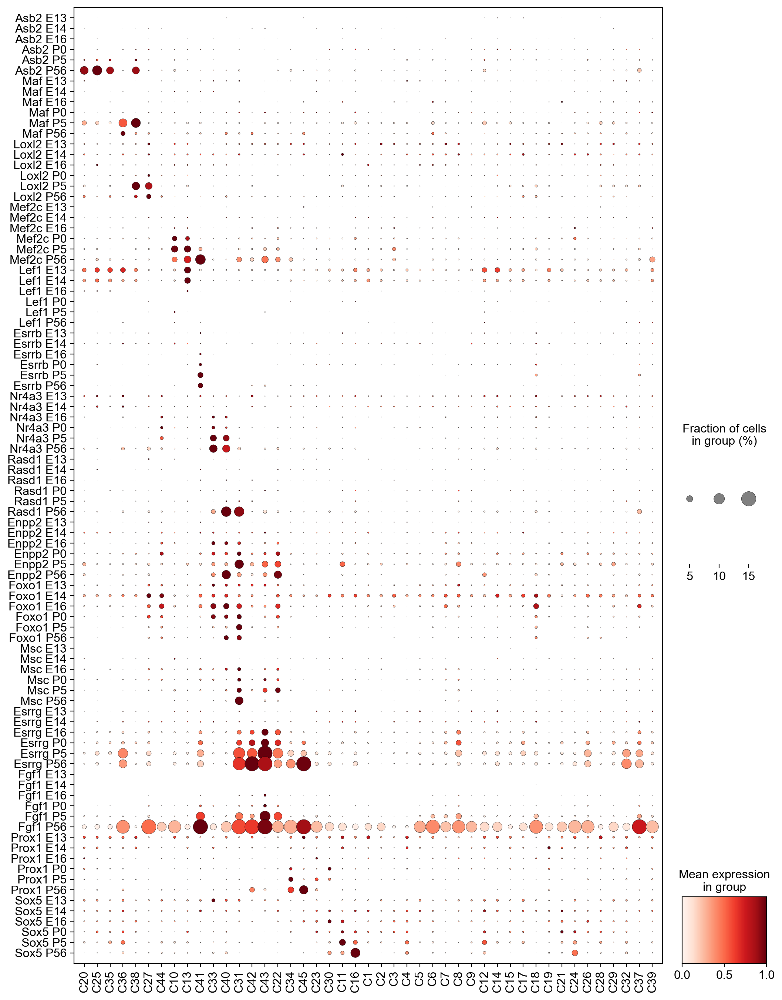

In [83]:
sc.pl.dotplot(tfs_sing_obj, tfs_sing_order, swap_axes=True, standard_scale='var', groupby='clust',
             categories_order = ['C20', 'C25',  'C35','C36', 'C38', 'C27', 'C44','C10', 'C13', 'C41',
                                  'C33', 'C40','C31', 'C42', 'C43','C22','C34', 'C45', 'C23',  'C30', 
                                  'C11','C16',
                                 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 
       'C12', 'C14', 'C15',  'C17', 'C18', 'C19',  'C21',
        'C24', 'C26',  'C28', 'C29',
       'C32', 'C37',  'C39', 
        ], dot_max=0.15,  
              figsize = (12,17),save='_TS_TFs_sing.pdf')

#

/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'age' as categorical
/Users/salwanbutrus/opt/anaconda3/envs/xgb_env/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'clust_age' as categorical


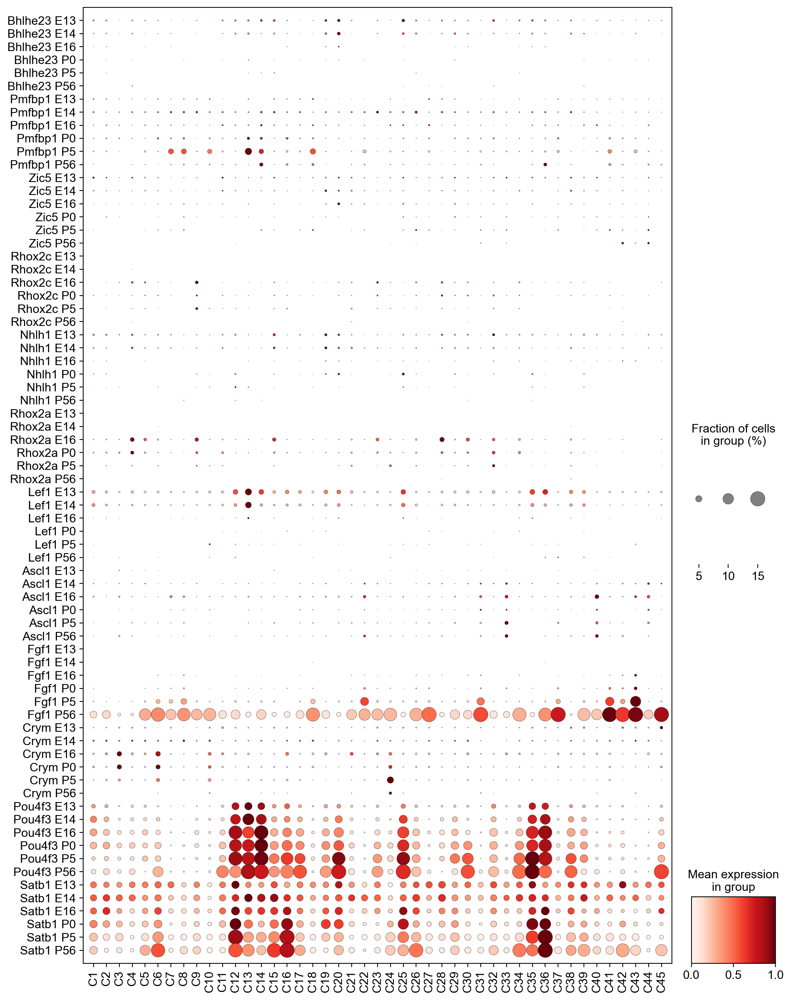

In [141]:
sc.pl.dotplot(tfs_sad_obj, tfs_sad_order, swap_axes=True, standard_scale='var', groupby='clust',
              dot_max=0.15,  
              figsize = (12,17))

# Type-specific CSMs

In [16]:
csms_all = list(pd.read_excel('csm_final.xlsx')['gene'].values)

In [17]:
ts_csms_master = []

for i in ts_genes:
    ts_csms_master = ts_csms_master + list(set(csms_all).intersection(set(i)))

In [18]:
pd.Categorical(ts_csms_master).value_counts().sort_values(ascending=False).values.astype('int')

array([4, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1])

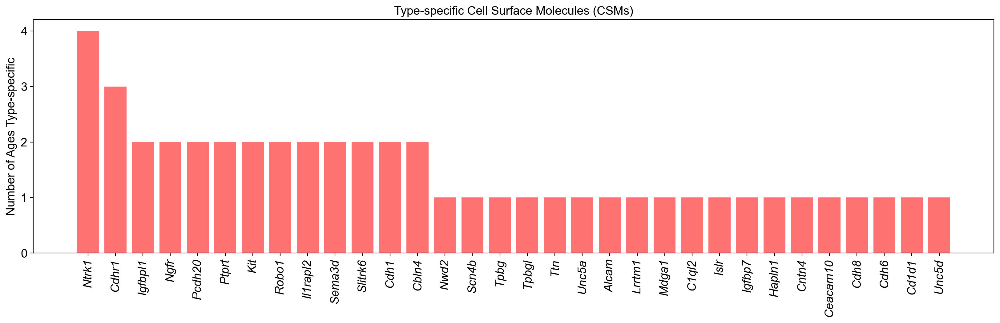

In [960]:
plt.figure(figsize=(20,5))
plt.bar(pd.Categorical(ts_csms_master).value_counts().sort_values(ascending=False).index, 
        pd.Categorical(ts_csms_master).value_counts().sort_values(ascending=False).values.astype('int'),
       color = '#FF7272')
plt.xticks(rotation=90, fontstyle='italic')
plt.yticks([0, 1, 2, 3, 4,])
plt.grid(False)
plt.title('Type-specific Cell Surface Molecules (CSMs)')
plt.ylabel('Number of Ages Type-specific')
plt.savefig('figures/TS_CSMs_numAges.pdf', bbox_inches='tight')
plt.show()

In [16]:
ts_csms = list(set(list(set(csms_all).intersection(set(ts_genes[3])))+ list(set(csms_all).intersection(set(ts_genes[4])))))

In [17]:
pd.Categorical(ts_csms_master).value_counts().sort_values(ascending=False).index

CategoricalIndex(['Ntrk1', 'Cdhr1', 'Igfbpl1', 'Ngfr', 'Pcdh20', 'Ptprt',
                  'Kit', 'Robo1', 'Il1rapl2', 'Sema3d', 'Slitrk6', 'Cdh1',
                  'Cbln4', 'Nwd2', 'Scn4b', 'Tpbg', 'Tpbgl', 'Ttn', 'Unc5a',
                  'Alcam', 'Lrrtm1', 'Mdga1', 'C1ql2', 'Islr', 'Igfbp7',
                  'Hapln1', 'Cntn4', 'Ceacam10', 'Cdh8', 'Cdh6', 'Cd1d1',
                  'Unc5d'],
                 categories=['Alcam', 'C1ql2', 'Cbln4', 'Cd1d1', 'Cdh1', 'Cdh6', 'Cdh8', 'Cdhr1', ...], ordered=False, dtype='category')

In [60]:
#remove ['Nwd2', 'Tpbgl'] b/c not present in any age
# remove  'Alcam','Cntn4', 'Lrrtm1',  'Unc5a', 'Unc5d', from sing
csms_frequent = ['Cbln4', 'Cdhr1', 'Ngfr',  'Cdh1' , 'Kit',  'Slitrk6', 'Pcdh20', 'Ptprt',
                  'Robo1',  'Il1rapl2', 'Sema3d', 
                  'Ntrk1', 'Igfbpl1', ]
csms_single = ['Scn4b', 'Hapln1', 'Tpbg', 'Ttn',
               'Islr',   'Ceacam10', 'Cdh8','Cd1d1',  'Mdga1', 'Igfbp7','Cdh6', 'C1ql2',  
                    ]

csms_curated = ['Cdh1', 'Cdh6', 'Cdh7','Cdh8','Cdh9','Cdh10','Cdh11','Cdh18',
               'Sdk1', 'Sdk2', 
               'Cntn4', 'Cntn5', 
               'Jam2', 
                'Robo1',
               'Plxna2', 'Plxna4', 
               'Sorcs3']

In [27]:
up_genes = list(pd.read_table('GenesUpVD_twoOFthree-2.txt', header=None)[0].values)
down_genes = list(pd.read_table('GenesDownVD_twoOFthree-2.txt', header=None)[0].values)

In [35]:
up_obj = tf_obj(tfs = up_genes, anc_list = anc_list)

way = pd.DataFrame([[s + ' E13' for s in up_genes], [s + ' E14' for s in up_genes], 
             [s + ' E16' for s in up_genes], [s + ' P0' for s in up_genes],
             [s + ' P5' for s in up_genes], [s + ' P56' for s in up_genes]])

up_order = []
for i in range(way.shape[1]):
    up_order = up_order + list(way.to_numpy()[:,i]) 
########################
down_obj = tf_obj(tfs = down_genes, anc_list = anc_list)

way = pd.DataFrame([[s + ' E13' for s in down_genes], [s + ' E14' for s in down_genes], 
             [s + ' E16' for s in down_genes], [s + ' P0' for s in down_genes],
             [s + ' P5' for s in down_genes], [s + ' P56' for s in down_genes]])

down_order = []
for i in range(way.shape[1]):
    down_order = down_order + list(way.to_numpy()[:,i]) 

In [ ]:
colors  = ["light:#639CDE", "light:#FDFD99", "light:#99C892"]


In [70]:
from matplotlib.colors import ListedColormap


In [77]:
mapcol = ListedColormap(sn.color_palette('light:#a31fe7', n_colors=100).as_hex())
mapcol2 = ListedColormap(sn.color_palette("light:#639CDE", n_colors=100).as_hex())

In [ ]:
csm

In [99]:
def vd_dotplot(tfs, anc_list):
    
    e13_tf = anc_list[0][:, tfs]
    e14_tf = anc_list[1][:, tfs]
    e16_tf = anc_list[2][:, tfs]
    p0_tf = anc_list[3][:, tfs]


    e13_tf.var.index = [s + ' NR' for s in tfs]
    e14_tf.var.index = [s + ' DR' for s in tfs]
    e16_tf.var.index = [s + ' rd1' for s in tfs]
    p0_tf.var.index = [s + ' Vsx2' for s in tfs]

    a = e13_tf.concatenate(e14_tf, e16_tf, p0_tf, join='outer')
    
    return a 

In [127]:
atlas.obs['Type_num'] = atlas.obs['Type_num'].cat.reorder_categories(dr_corr.obs['Atlas Label'].values.categories)
atlas.obs['Atlas Label'] = atlas.obs['Type_num']

csms_obj_vd = vd_dotplot(csms_frequent, anc_list=[atlas, dr_corr, rd1, Vsx2])

way = pd.DataFrame([[s + ' NR' for s in csms_frequent], [s + ' DR' for s in csms_frequent], 
             [s + ' rd1' for s in csms_frequent], [s + ' Vsx2' for s in csms_frequent],])

csms_order = []
for i in range(way.shape[1]):
    csms_order = csms_order + list(way.to_numpy()[:,i]) 

tfs_obj_vd = vd_dotplot(tfs_frequent, anc_list=[atlas, dr_corr, rd1, Vsx2])

way = pd.DataFrame([[s + ' NR' for s in tfs_frequent], [s + ' DR' for s in tfs_frequent], 
             [s + ' rd1' for s in tfs_frequent], [s + ' Vsx2' for s in tfs_frequent],])

tfs_order = []
for i in range(way.shape[1]):
    tfs_order = tfs_order + list(way.to_numpy()[:,i]) 

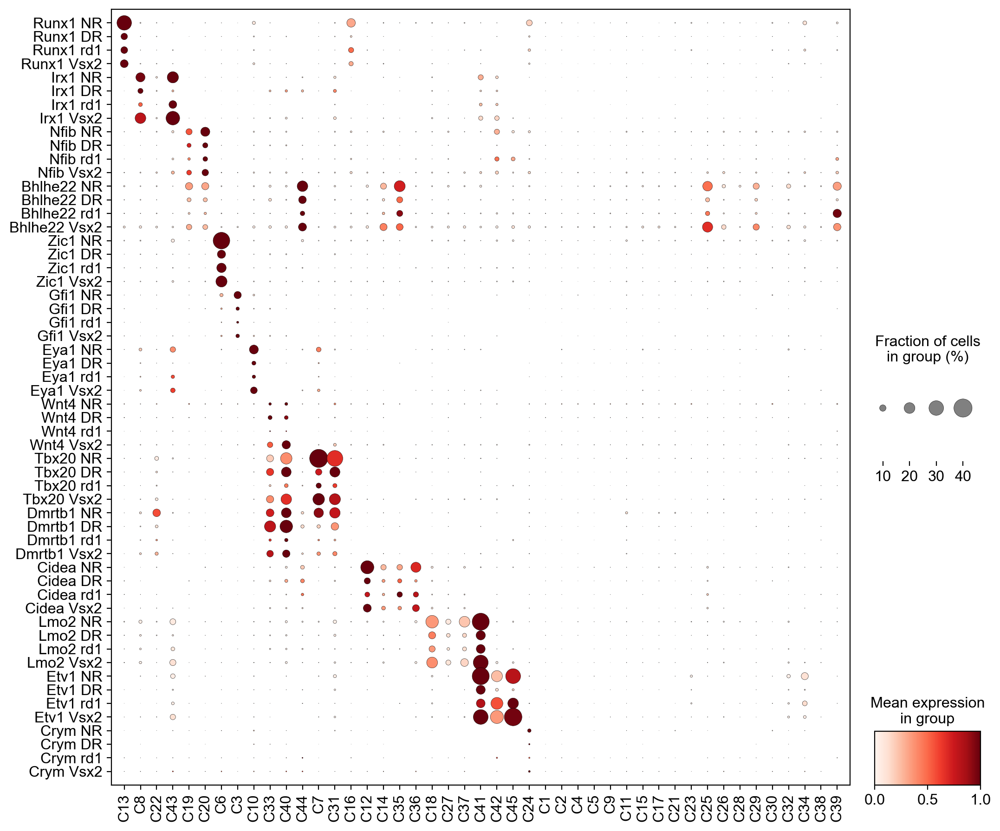

In [128]:
sc.pl.dotplot(tfs_obj_vd, tfs_order, swap_axes=True, standard_scale='var', groupby='Atlas Label',
           dot_max=0.4,use_raw=False,figsize=(12,11),
               categories_order = [ 'C13', 
                                  'C8', 'C22','C43', 
                                  'C19', 'C20','C6', 'C3', 'C10',
                                     'C33',  'C40',  'C44',  'C7',  'C31',         
                                        'C16',  
                                       'C12', 'C14', 'C35', 'C36',   
                                       'C18',  'C27',  'C37',   'C41',
                                            'C42',   'C45', 'C24',
                                  'C1', 'C2',  'C4', 'C5', 
                                                  'C9',  'C11',
        'C15', 'C17',  'C21',
       'C23',  'C25', 'C26',  'C28', 'C29', 'C30',
       'C32',  'C34',   'C38', 'C39', ],
             save='_TFs_VDcomp.pdf')

In [ ]:
add 'Sdk1' copy and paste into other NB

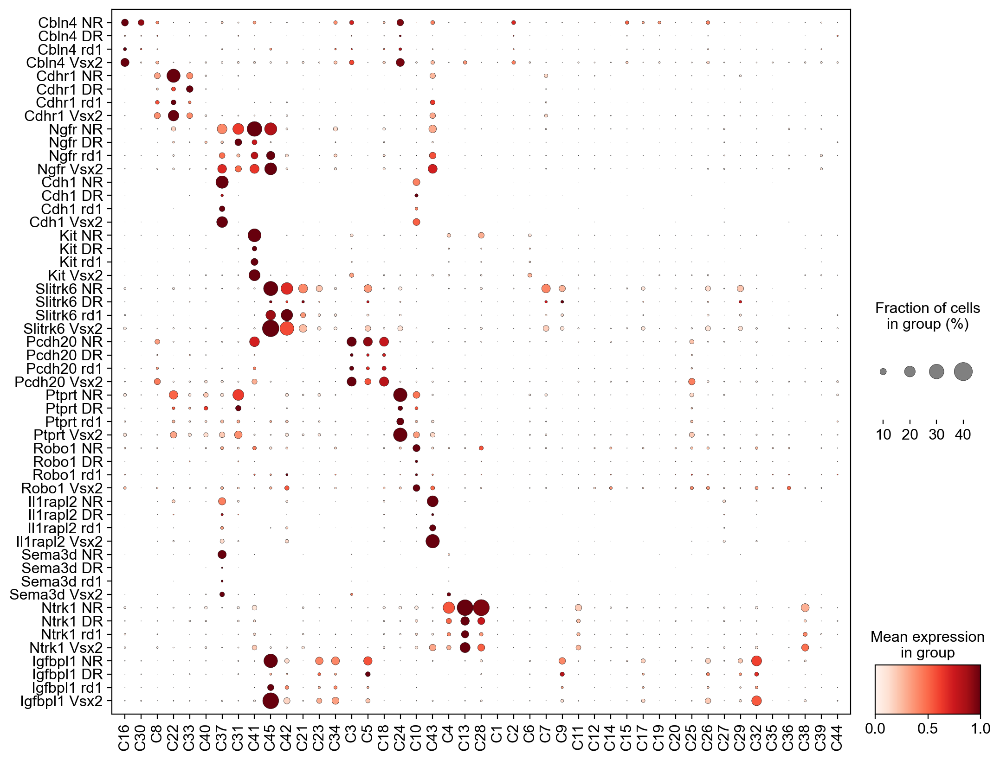

In [122]:
sc.pl.dotplot(csms_obj_vd, csms_order, swap_axes=True, standard_scale='var', groupby='Atlas Label',
           dot_max=0.4,use_raw=False,figsize=(12,10),
              categories_order= [  'C16', 'C30',
                                                    'C8', 'C22', 'C33', 'C40',
                                                     'C37','C31', 'C41','C45','C42', 
                                                    'C21',  'C23','C34',
                                                    'C3','C5', 'C18','C24','C10', 'C43',
                                                    'C4', 'C13','C28', 
                                                    'C1', 'C2',   'C6', 'C7', 'C9', 
                                                    'C11',
       'C12', 'C14', 'C15',  'C17', 'C19', 'C20',   'C25', 'C26', 'C27', 'C29',  
       'C32', 'C35', 'C36', 'C38', 'C39', 
        'C44', ],
             save='_CSMs_VDcomp.pdf')

In [20]:
csms_freq_obj = tf_obj(tfs = csms_frequent, anc_list = anc_list)
csms_sing_obj = tf_obj(tfs = csms_single, anc_list = anc_list)

woo = pd.DataFrame([[s + ' E13' for s in csms_frequent], [s + ' E14' for s in csms_frequent], 
             [s + ' E16' for s in csms_frequent], [s + ' P0' for s in csms_frequent],
             [s + ' P5' for s in csms_frequent], [s + ' P56' for s in csms_frequent]])

csms_freq_order = []
for i in range(woo.shape[1]):
    csms_freq_order = csms_freq_order + list(woo.to_numpy()[:,i]) 
    

woo__ = pd.DataFrame([[s + ' E13' for s in csms_single], [s + ' E14' for s in csms_single], 
             [s + ' E16' for s in csms_single], [s + ' P0' for s in csms_single],
             [s + ' P5' for s in csms_single], [s + ' P56' for s in csms_single]])

csms_sing_order = []
for i in range(woo__.shape[1]):
    csms_sing_order = csms_sing_order + list(woo__.to_numpy()[:,i]) 

In [36]:
csms_cur_obj = tf_obj(tfs = csms_curated, anc_list = anc_list)

way = pd.DataFrame([[s + ' E13' for s in csms_curated], [s + ' E14' for s in csms_curated], 
             [s + ' E16' for s in csms_curated], [s + ' P0' for s in csms_curated],
             [s + ' P5' for s in csms_curated], [s + ' P56' for s in csms_curated]])

csms_cur_order = []
for i in range(way.shape[1]):
    csms_cur_order = csms_cur_order + list(way.to_numpy()[:,i]) 

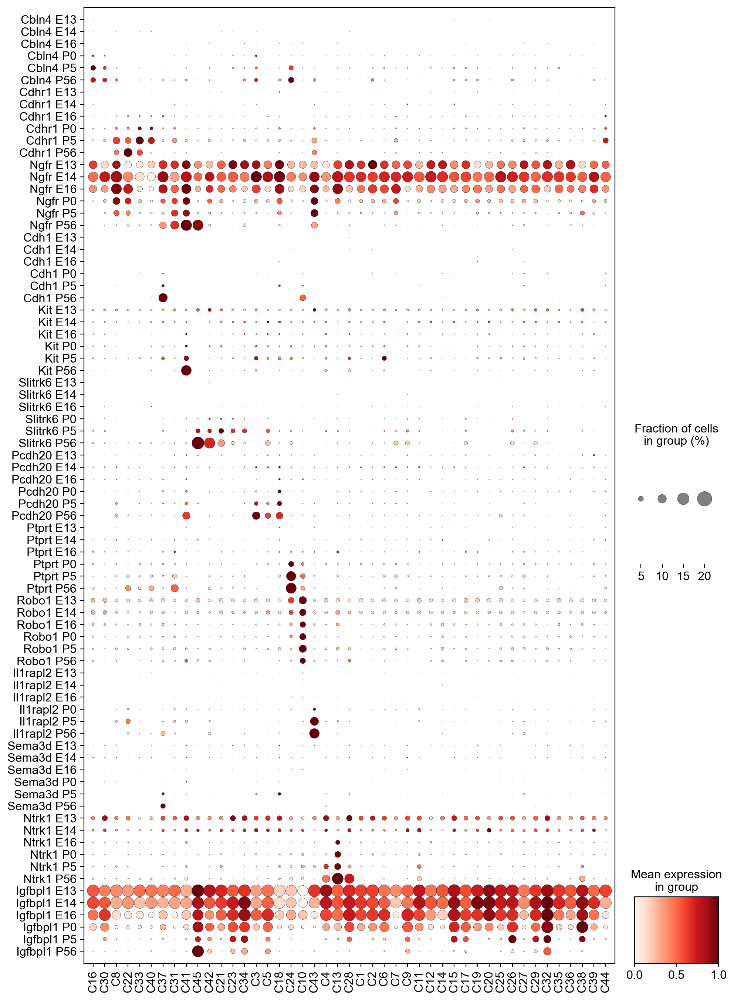

In [1074]:
sc.pl.dotplot(csms_freq_obj, csms_freq_order, swap_axes=True, standard_scale='var', groupby='clust',
             figsize = (11,17), categories_order = [  'C16', 'C30',
                                                    'C8', 'C22', 'C33', 'C40',
                                                     'C37','C31', 'C41','C45','C42', 
                                                    'C21',  'C23','C34',
                                                    'C3','C5', 'C18','C24','C10', 'C43',
                                                    'C4', 'C13','C28', 
                                                    'C1', 'C2',   'C6', 'C7', 'C9', 
                                                    'C11',
       'C12', 'C14', 'C15',  'C17', 'C19', 'C20',   'C25', 'C26', 'C27', 'C29',  
       'C32', 'C35', 'C36', 'C38', 'C39', 
        'C44', ], save='_TS_CSMs_freq.pdf')

#

In [168]:
sc.pl.dotplot(csms_sing_obj, csms_sing_order, swap_axes=True, standard_scale='var', groupby='clust',
             figsize = (11,13), categories_order = [ 'C42', 'C34', 'C45', 'C43',
                                                    'C23', 
                                                    'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 
                                                    'C7', 'C8', 'C22', 'C27', 'C37', 
                                                    'C18', 'C9', 
                                                    'C31', 'C33', 'C40',
                                                    'C10', 'C16', 'C36', 
                                                    'C32',  'C11',
       'C12', 'C13','C14', 'C15', 'C17','C19', 'C20', 'C21',
       'C24', 'C25', 'C26',  'C28', 'C29', 'C30', 
       'C44', 'C35',  'C38', 'C39', 'C41',
      ], )#save='_TS_CSMs_sing.pdf')

#

KeyError: "Could not find keys '['Sorcs3']' in columns of `adata.obs` or in adata.var_names."

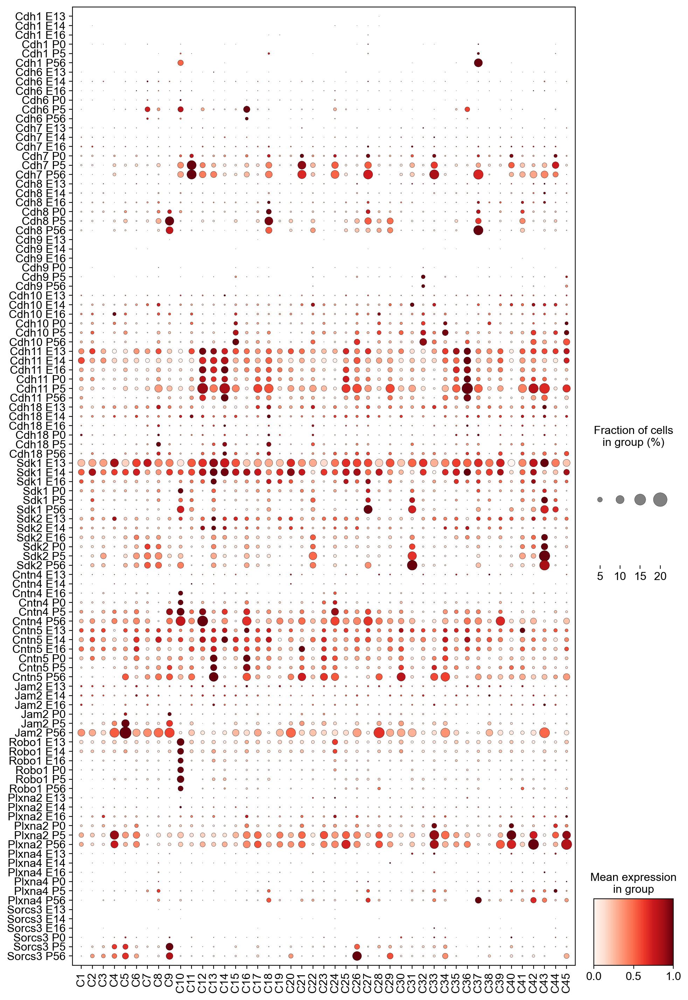

In [43]:
sc.pl.dotplot(csms_cur_obj, csms_cur_order, swap_axes=True, standard_scale='var', groupby='clust',
             figsize = (11,18), save='CSMs_curated')

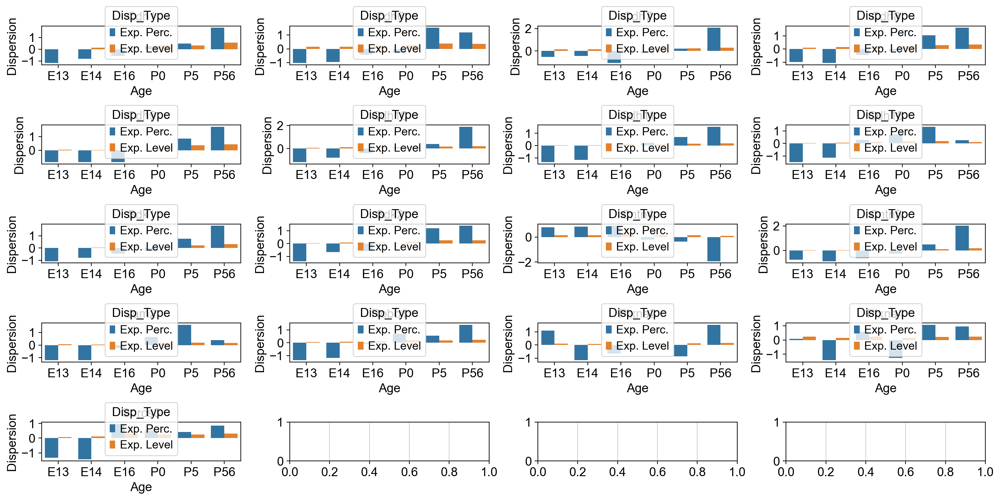

In [41]:
fig, axs = plt.subplots(5,4, figsize=(16,8))
a = 0
b = 0
p_dfs = []
for tf_ in csms_curated:
    neurod2_p = []
    neurod2_e = []

    for i in [anc_e13, anc_e14, anc_e16, anc_p0, anc_p5, anc_p56]:
        yo = calc_pt(i,tf_)
        neurod2_p.append(yo[0])
        neurod2_e.append(yo[1])

    p_df = pd.concat([pd.DataFrame(sp.stats.zscore(neurod2_p) , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Perc.'], columns=['Disp_Type']),
                pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age']),
                     pd.DataFrame(6*[tf_], columns=['TF'])], axis=1)
    p_dfs.append(p_df)
    e_df = pd.concat([pd.DataFrame(neurod2_e , columns=['Dispersion']), 
              pd.DataFrame(6*['Exp. Level'], columns=['Disp_Type']), 
                     pd.DataFrame(list(anc.obs.age.values.categories), columns=['Age'])], axis=1)
    sn.barplot(x='Age', y='Dispersion', hue='Disp_Type',data=pd.concat([p_df, e_df], axis=0), 
               ax=axs[a,b])
    
    axs[a,b].grid(False)
    axs[a,b].set_title(tf_)

    if (b>2):
        b = 0
        a = a + 1
    else:
        b = b + 1
#     plt.title(tf_)
#     plt.show()
    
#     fig, axs = plt.subplots(1,2, figsize=(8,4))
#     axs[0].bar(anc.obs.age.values.categories, neurod2_p)
#     axs[0].grid(False)
#     axs[0].set_title(tf_)
#     axs[0].set_ylabel('% Expressed Dispersion')
    
#     axs[1].bar(anc.obs.age.values.categories, neurod2_e)
#     axs[1].grid(False)
#     axs[1].set_title(tf_)
#     axs[1].set_ylabel('Expression Dispersion')
plt.tight_layout()

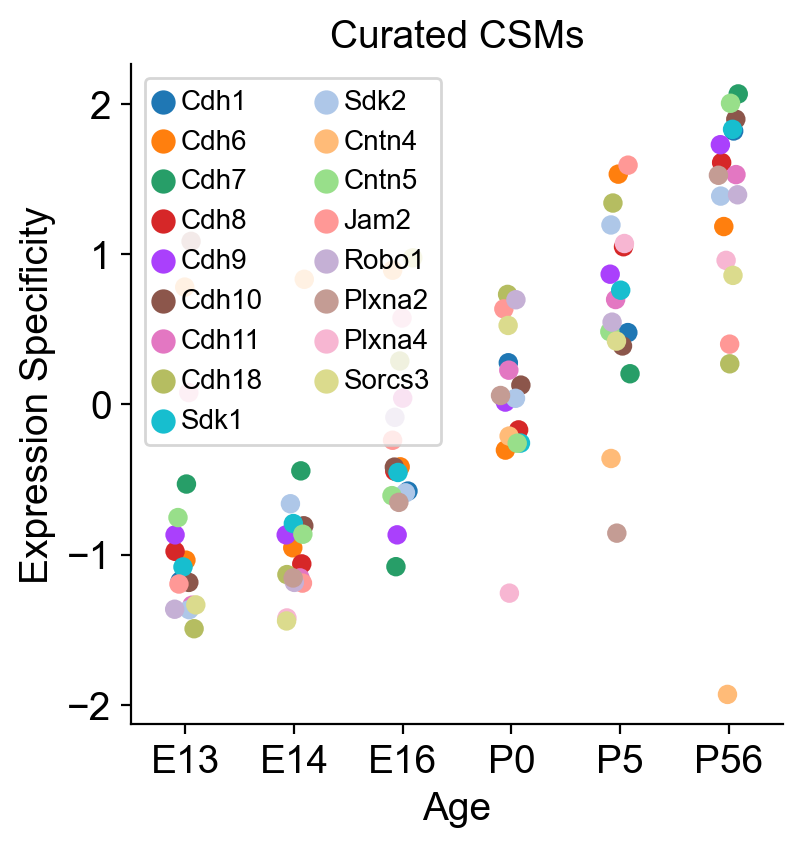

In [42]:
sn.catplot(x="Age", y="Dispersion", hue="TF", data=pd.concat(p_dfs, axis=0), 
           legend_out=False, s=7,  height=4,aspect=1)
#plt.ylabel('Scaled Dispersion of Expression \n Frequency Across Clusters', fontsize=12)
plt.ylabel('Expression Specificity')

plt.grid(False)
plt.legend(fontsize=10, ncol=2)
#plt.title('Frequent Type-specific CSMs (>1 time point)')
#plt.savefig('figures/disp_TS_CSMs_freq.pdf', bbox_inches='tight')
plt.title('Curated CSMs')
plt.savefig('figures/disp_CSMs_cur.pdf', bbox_inches='tight')
